In [3]:
!pip install yfinance
!pip install talib-binary

In [4]:
import pandas as pd
payload = pd.read_html('https://en.wikipedia.org/wiki/List_of_S%26P_500_companies')
symbols = payload[0].Symbol

import numpy as np
import matplotlib.pyplot as plt
import yfinance as yf
import talib as ta
import time
import pandas_datareader.data as web
import datetime

period_y = '11y'

df_X = yf.Ticker(symbols[0]).history(period=period_y).ffill()
df_X["Close_mom_sht"] = ta.MOM(df_X["Close"], timeperiod = 5)
df_X["Close_mom_mid"] = ta.MOM(df_X["Close"], timeperiod = 25)
df_X["Close_mom_lng"] = ta.MOM(df_X["Close"], timeperiod = 75)
df_X["Close_rsi"] = ta.RSI(df_X["Close"])
df_X["Close_Price_NATR"] = ta.NATR(df_X["High"], df_X["Low"], df_X["Close"])
df_X["Close"] = ta.ROCP(df_X["Close"], timeperiod = 1)
df_X = df_X.filter(regex='Close', axis = 1)
df_X.columns = ["MMM_" + c for c in df_X.columns]

for smb in symbols[1:]:
    new_df_X = yf.Ticker(smb).history(period=period_y).ffill()
    if len(new_df_X) == 0:
        continue
    if (new_df_X.index[0] != df_X.index[0]):
        continue
    new_df_X["Close_mom_sht"] = ta.MOM(new_df_X["Close"], timeperiod = 5)
    new_df_X["Close_mom_mid"] = ta.MOM(new_df_X["Close"], timeperiod = 25)
    new_df_X["Close_mom_lng"] = ta.MOM(new_df_X["Close"], timeperiod = 75)
    new_df_X["Close_rsi"] = ta.RSI(new_df_X["Close"])
    new_df_X["Close_Price_NATR"] = ta.NATR(new_df_X["High"], new_df_X["Low"], new_df_X["Close"])
    new_df_X["Close"] = ta.ROCP(new_df_X["Close"], timeperiod = 1)
    new_df_X = new_df_X.filter(regex='Close', axis = 1)
    new_df_X.columns = [smb + "_" + c for c in new_df_X.columns]
    df_X = df_X.join(new_df_X, how = "outer")

df_X_low_cor = df_X.copy()
print(f"The shape of feature data before data reduction: {df_X_low_cor.shape}")
cor = df_X_low_cor.filter(regex='Close$', axis = 1).corr()
cor_n_diag = cor - np.diag(np.ones(cor.shape[0]))
print(f"The number of features with strong correlation (> 0.7) with another feature: {((cor_n_diag > 0.7).sum() > 0).sum()}")

while (cor_n_diag > 0.7).sum().sum() > 0:
    candidates = cor_n_diag[np.any(cor_n_diag == cor_n_diag.max().max(), axis = 1)].mean(axis = 1)
    col_del_names = candidates[candidates == candidates.max()]
    col_del_names = df_X_low_cor.filter(regex = col_del_names.index.values[0], axis = 1).columns.values

    df_X_low_cor = df_X_low_cor.loc[:, [not cl in col_del_names for cl in df_X_low_cor.columns.values]]
    cor = df_X_low_cor.filter(regex='Close$', axis = 1).corr()
    cor_n_diag = cor - np.diag(np.ones(cor.shape[0]))

df_X = df_X_low_cor
df_X = df_X.ffill()
df_X = df_X.dropna()

print(f"The feature shape after the feature selection and forward filling and droping of NA: {df_X_low_cor.shape}")

SP500 = web.DataReader(['sp500'], 'fred', df_X.index[0], datetime.datetime(2022, 5, 2))
SP500 = SP500.dropna()

SP500['sp500'] = ta.ROCP(SP500['sp500'], timeperiod = 1)
y_ind = SP500.index[1:-2]
SP500_t2 = SP500.iloc[3:, :].rename(columns = {"sp500": "sp500_t2"})
SP500_t2.index = y_ind
df = SP500_t2.join(SP500).join(df_X)

n_t = 3
df_org = df.copy()

df_ind = df_org.index[1:]
df_t_1 = df_org.iloc[:-1, 1:]
df_t_1.index = df_ind
df_t_1.columns = [c + "_t_1" for c in df_org.columns[1:]]
df = df.join(df_t_1, how = "inner")

for i in range(2, (n_t + 1)):
    df_ind = df_t_1.index[1:]
    df_t_1 = df_t_1.iloc[:-1, :]
    df_t_1.index = df_ind
    df_t_1.columns = [c + "_t_" + str(i) for c in df_org.columns[1:]]
    df = df.join(df_t_1, how = "inner")

- BRK.B: No data found, symbol may be delisted
- BF.B: No data found for this date range, symbol may be delisted
The shape of feature data before data reduction: (2771, 2700)
The number of features with strong correlation (> 0.7) with another feature: 225
The feature shape after the feature selection and forward filling and droping of NA: (2771, 1434)


In [5]:
import random
import os
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LeakyReLU, Dropout, BatchNormalization
from tensorflow.keras.optimizers import SGD

def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)
    tf.compat.v1.set_random_seed(seed)
    session_conf = tf.compat.v1.ConfigProto(
        intra_op_parallelism_threads=1,
        inter_op_parallelism_threads=1
    )
    sess = tf.compat.v1.Session(graph=tf.compat.v1.get_default_graph(), config=session_conf)
    tf.compat.v1.keras.backend.set_session(sess)



optimizer = SGD, epoch = 30

Epoch 1/30
32/32 [==============================] - 4s 26ms/step - loss: 2.0640 - mean_absolute_error: 1.0520 - val_loss: 3.4182 - val_mean_absolute_error: 1.3310
Epoch 2/30
32/32 [==============================] - 0s 13ms/step - loss: 1.8267 - mean_absolute_error: 0.9720 - val_loss: 2.0576 - val_mean_absolute_error: 1.0830
Epoch 3/30
32/32 [==============================] - 0s 14ms/step - loss: 1.7124 - mean_absolute_error: 0.9404 - val_loss: 2.3179 - val_mean_absolute_error: 1.1668
Epoch 4/30
32/32 [==============================] - 0s 14ms/step - loss: 1.7093 - mean_absolute_error: 0.9080 - val_loss: 2.0054 - val_mean_absolute_error: 1.0676
Epoch 5/30
32/32 [==============================] - 0s 13ms/step - loss: 1.4326 - mean_absolute_error: 0.8414 - val_loss: 1.7125 - val_mean_absolute_error: 0.9847
Epoch 6/30
32/32 [==============================] - 0s 14ms/step - loss: 1.4458 - mean_absolute_error: 0.8319 - val_loss: 1.4946 - val_mean_absolute_error

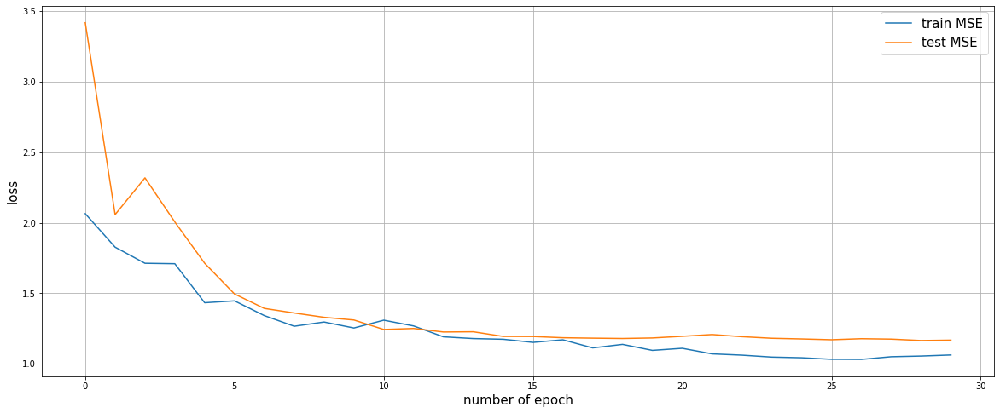

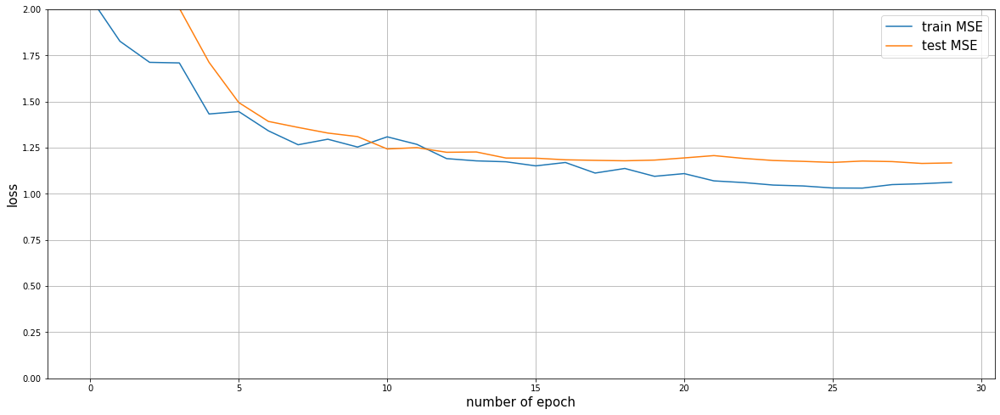

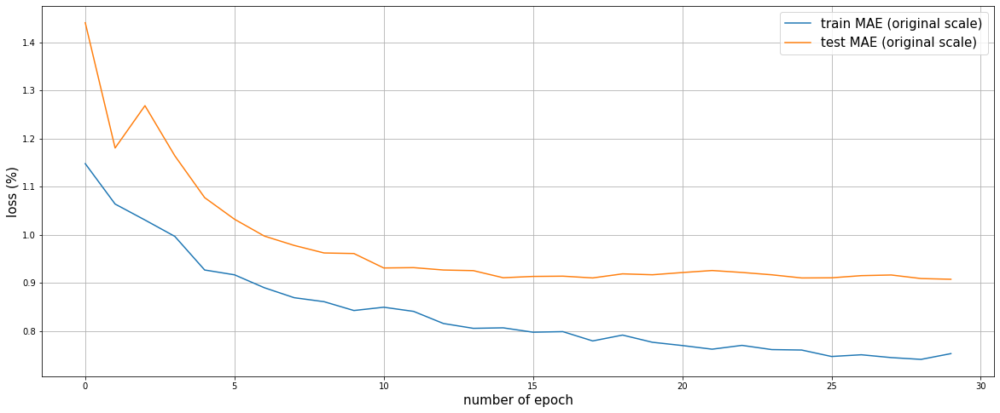

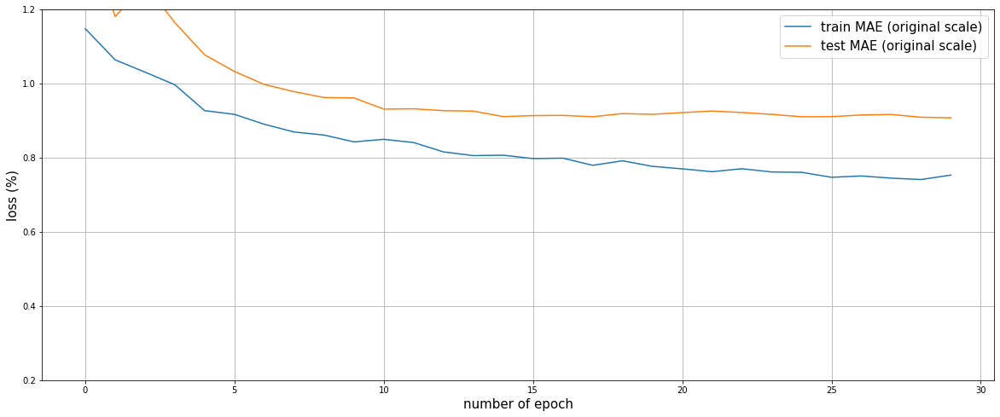

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.864%
 0.31 min.


optimizer = SGD, epoch = 30



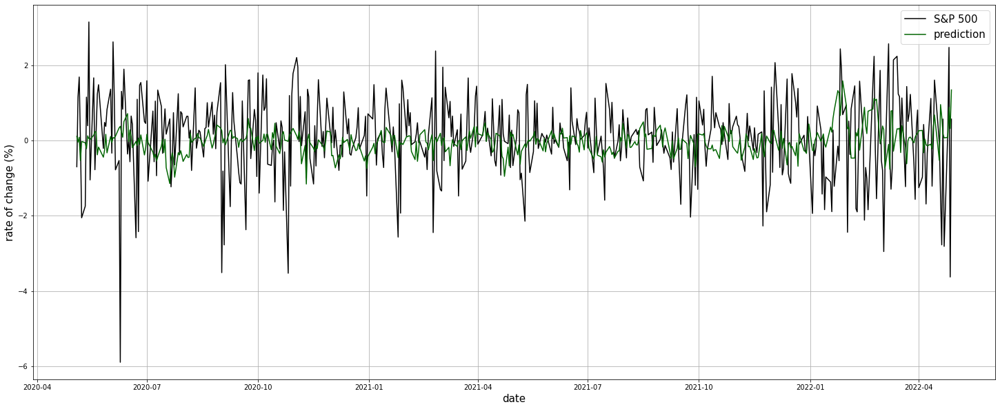

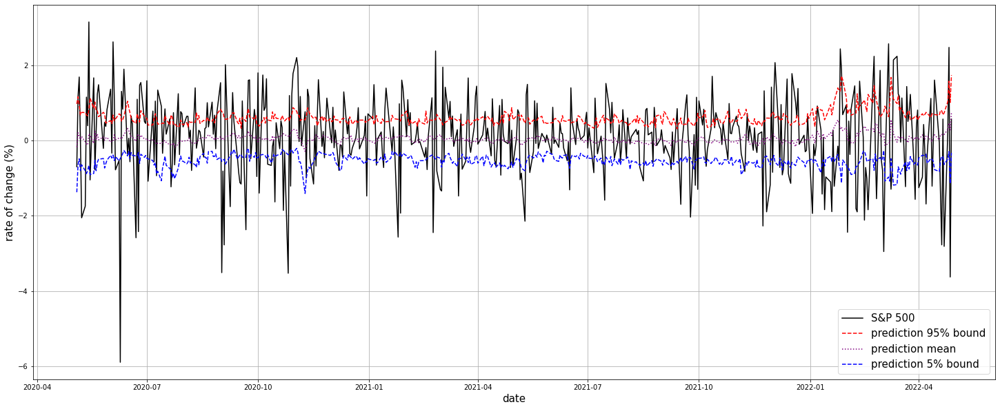

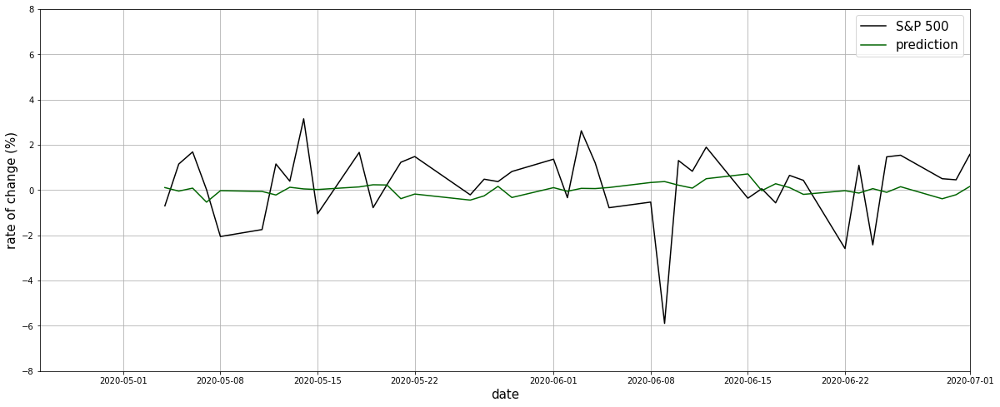

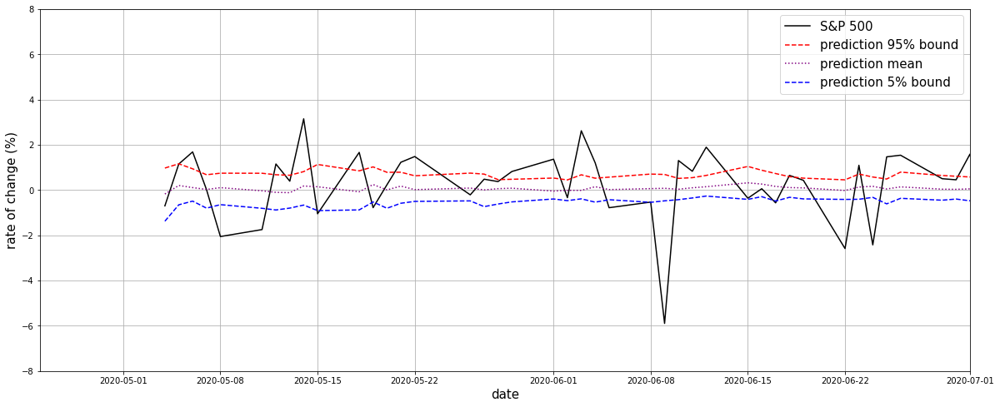

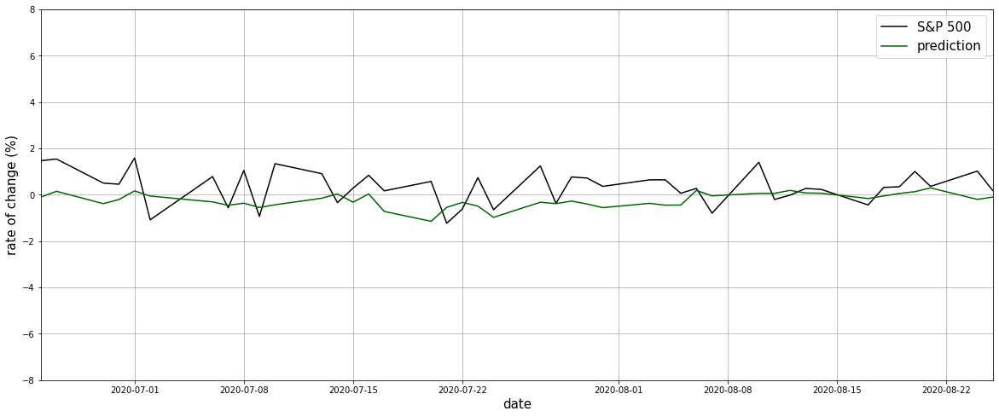

...

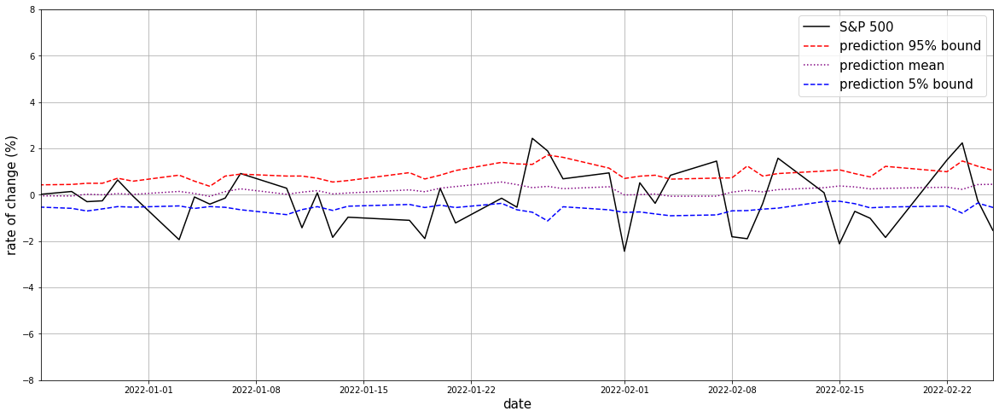

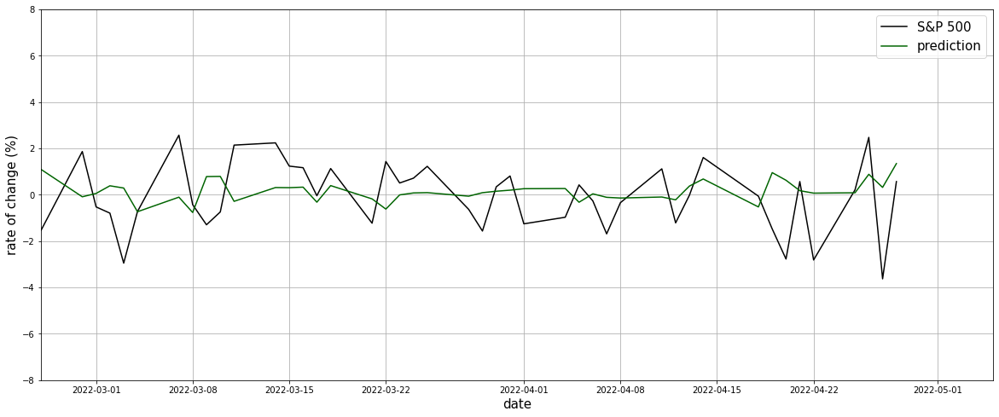

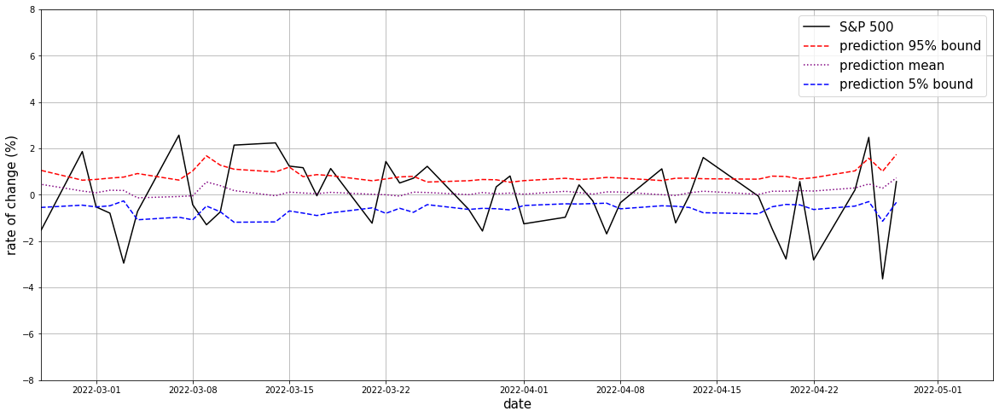

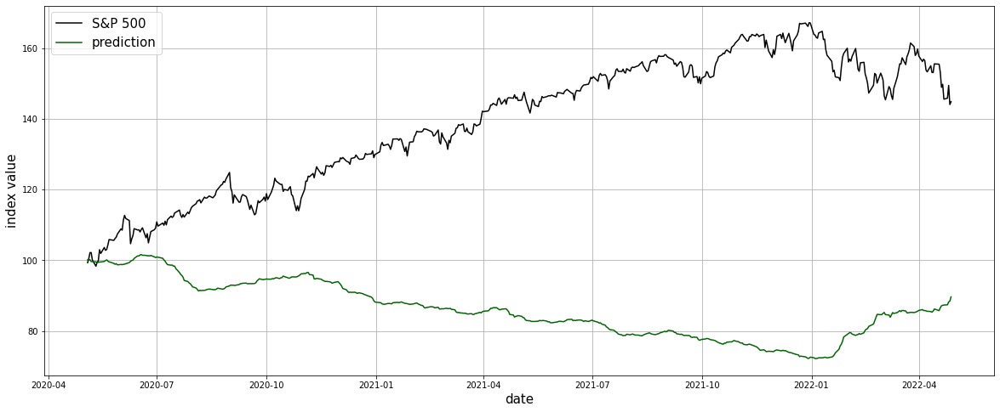

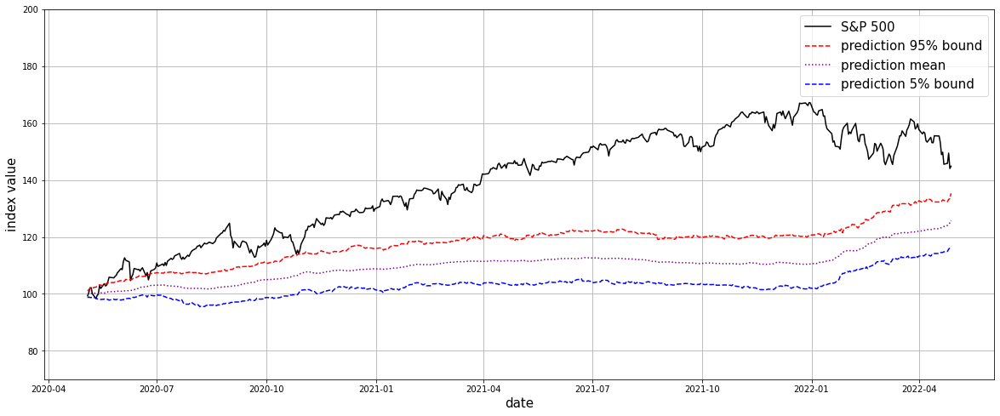

 0.34 min.


optimizer = Adagrad, epoch = 30

Epoch 1/30
32/32 [==============================] - 4s 27ms/step - loss: 2.1038 - mean_absolute_error: 1.0408 - val_loss: 1.6783 - val_mean_absolute_error: 0.9945
Epoch 2/30
32/32 [==============================] - 1s 16ms/step - loss: 1.7680 - mean_absolute_error: 0.9538 - val_loss: 2.3104 - val_mean_absolute_error: 1.1332
Epoch 3/30
32/32 [==============================] - 1s 16ms/step - loss: 1.7890 - mean_absolute_error: 0.9614 - val_loss: 1.8289 - val_mean_absolute_error: 1.0704
Epoch 4/30
32/32 [==============================] - 1s 16ms/step - loss: 1.7617 - mean_absolute_error: 0.9584 - val_loss: 2.0542 - val_mean_absolute_error: 1.1157
Epoch 5/30
32/32 [==============================] - 1s 16ms/step - loss: 1.6934 - mean_absolute_error: 0.9219 - val_loss: 1.5184 - val_mean_absolute_error: 0.9511
Epoch 6/30
32/32 [==============================] - 1s 16ms/step - loss: 1.6316 - mean_absolute_error: 0.9036 - val_loss: 1.6886 - val_mean

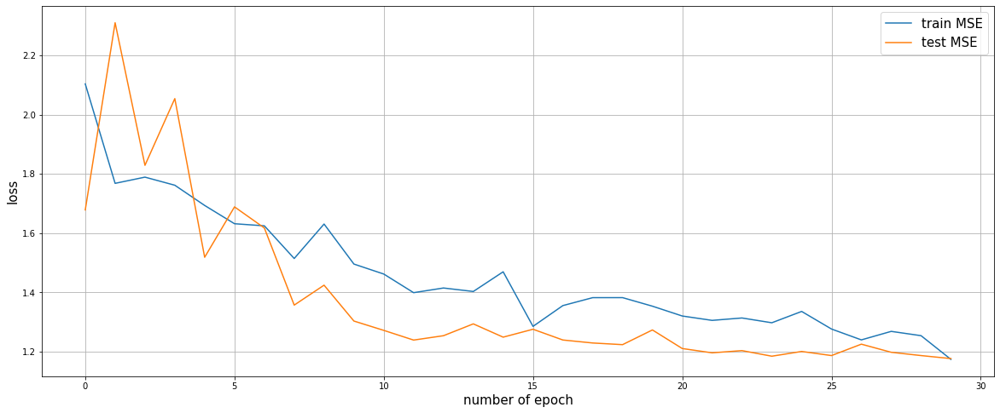

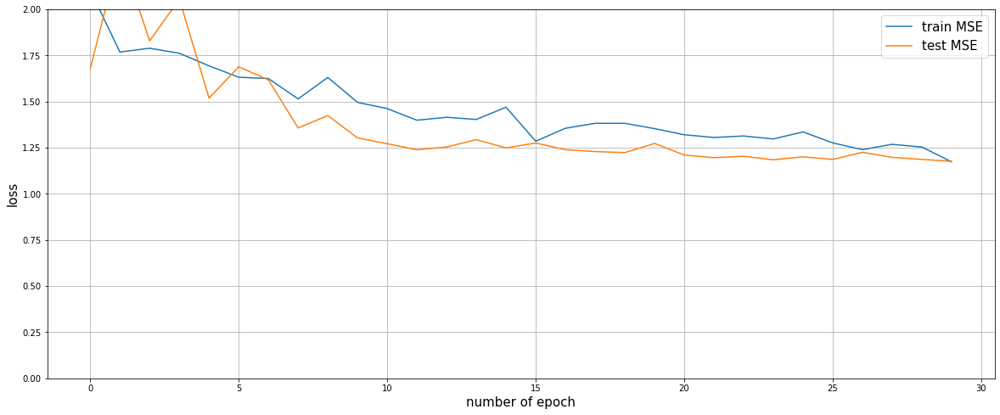

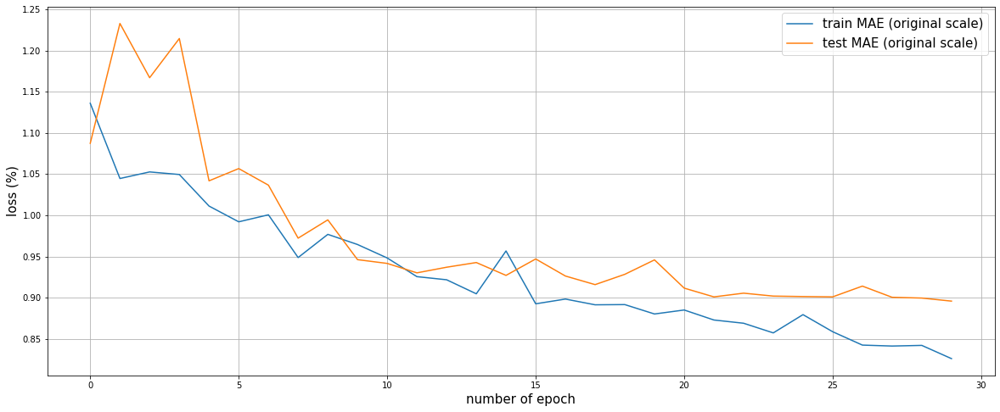

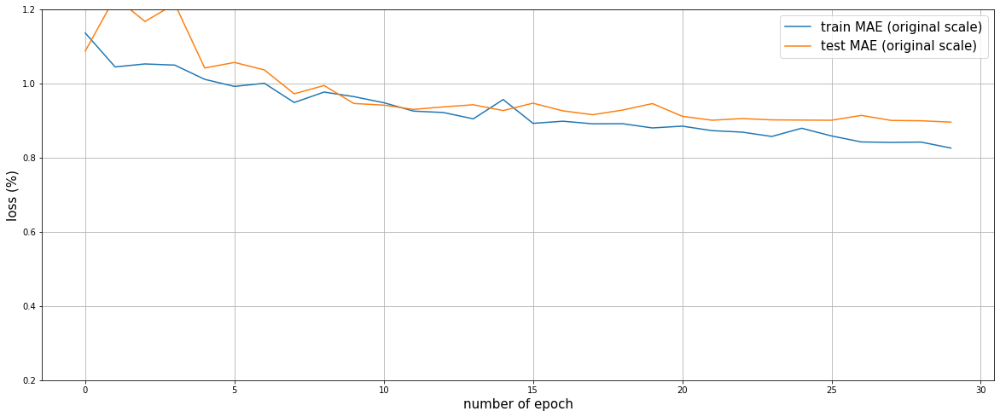

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.852%
 0.35 min.


optimizer = Adagrad, epoch = 30



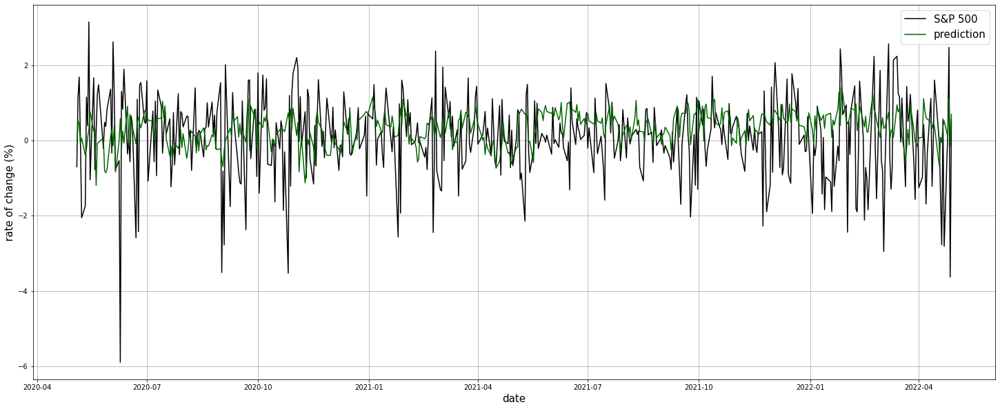

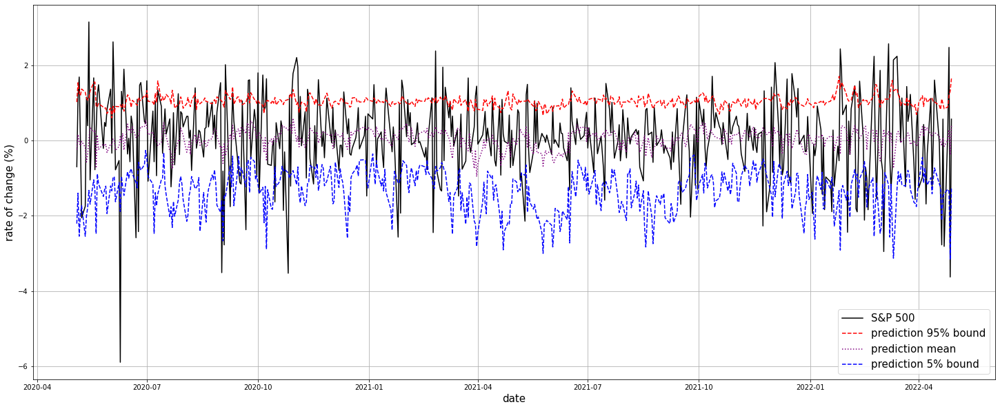

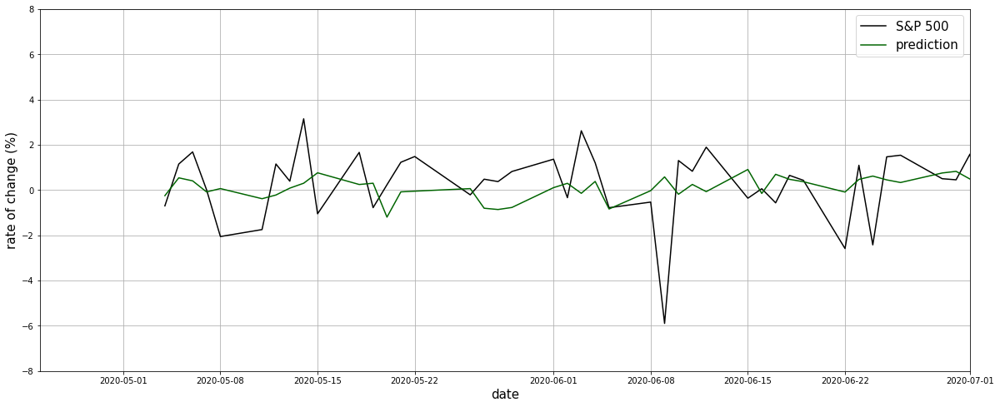

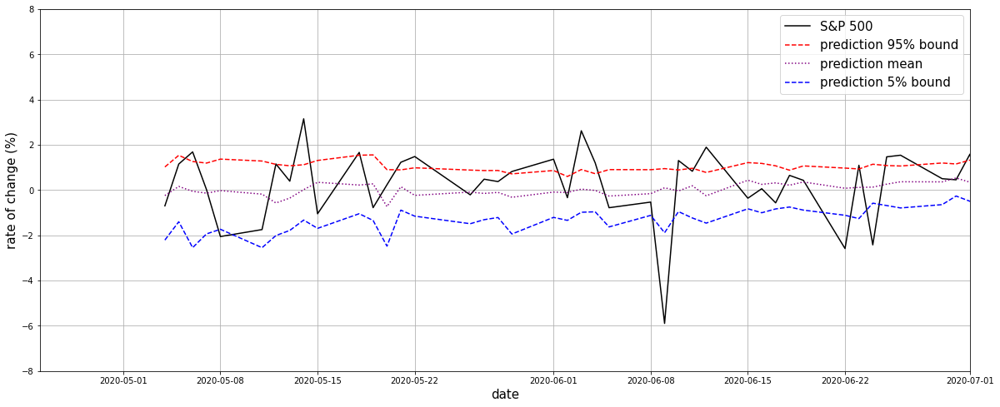

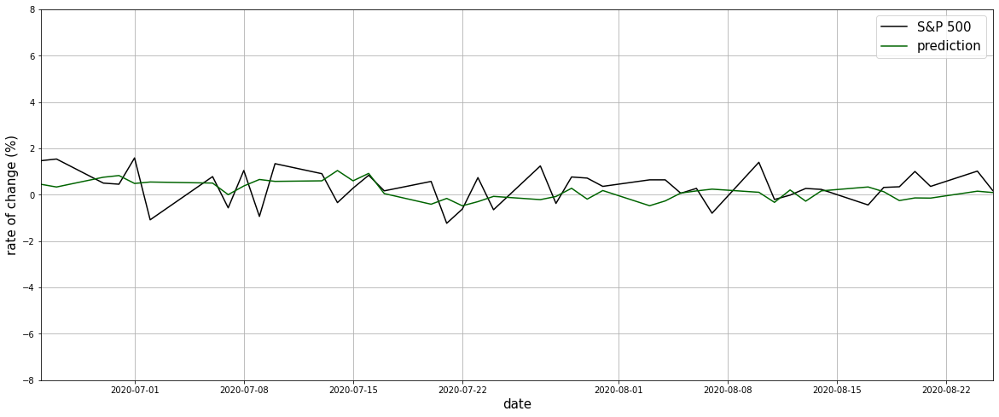

...

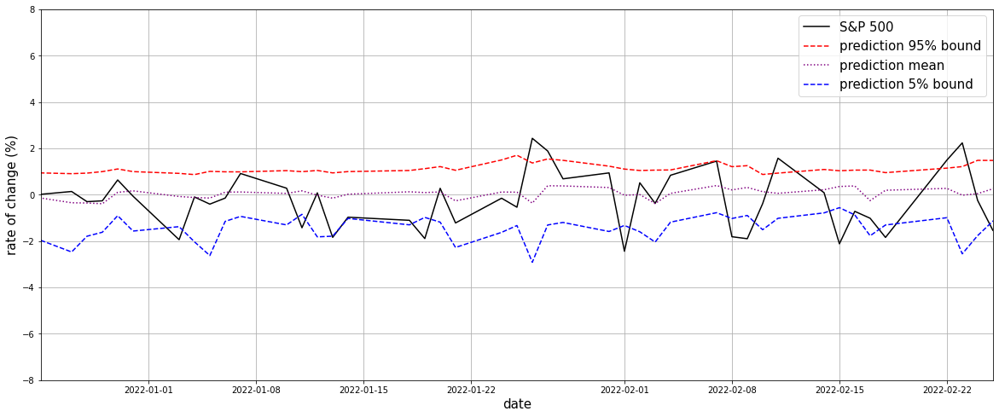

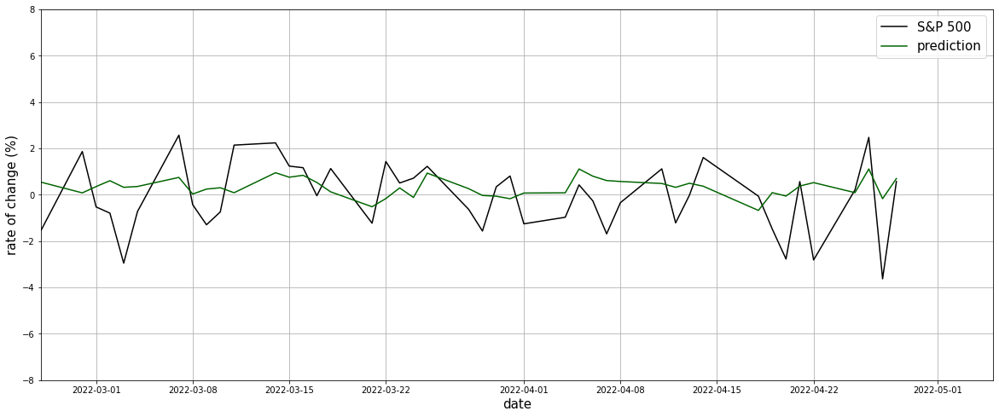

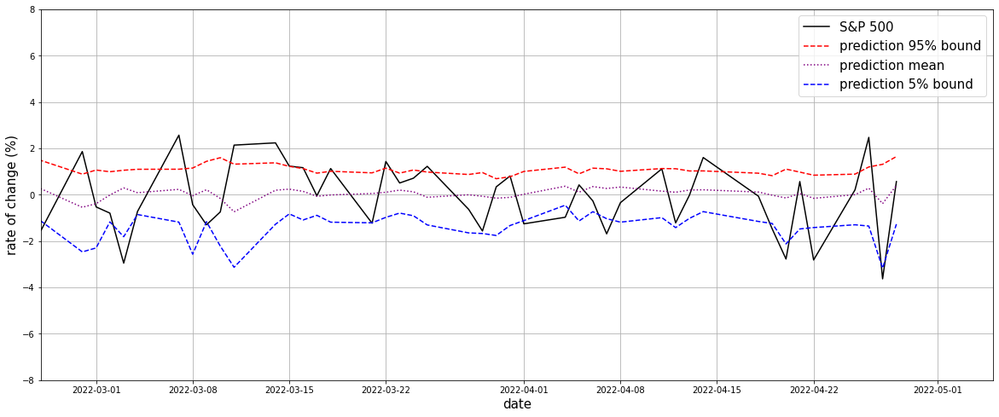

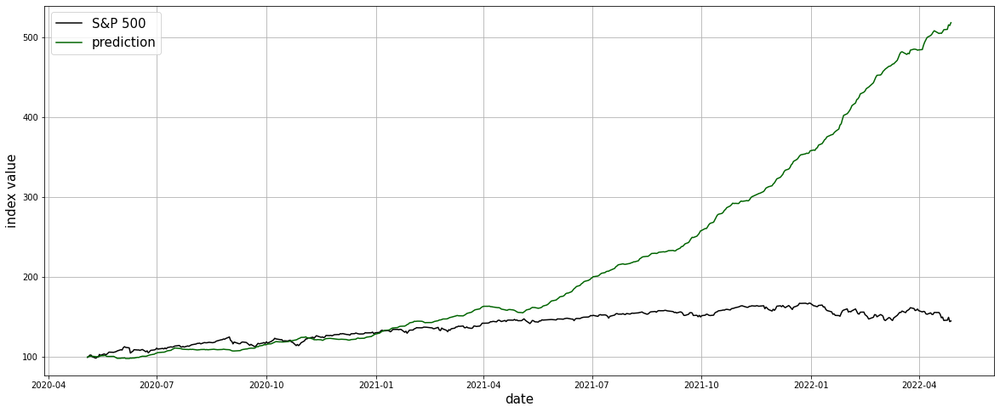

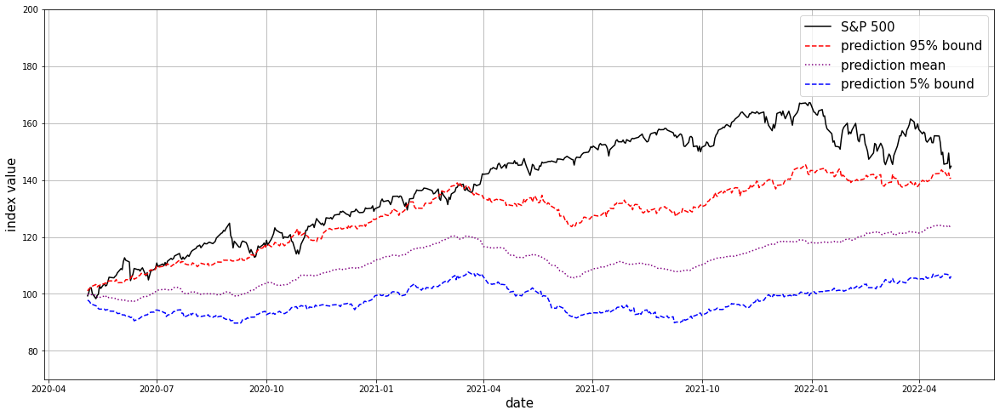

 0.34 min.


optimizer = RMSprop, epoch = 30

Epoch 1/30
32/32 [==============================] - 5s 36ms/step - loss: 2.2591 - mean_absolute_error: 1.1077 - val_loss: 566.1765 - val_mean_absolute_error: 19.4769
Epoch 2/30
32/32 [==============================] - 1s 24ms/step - loss: 1.6090 - mean_absolute_error: 0.8970 - val_loss: 87.9865 - val_mean_absolute_error: 6.8645
Epoch 3/30
32/32 [==============================] - 1s 25ms/step - loss: 1.4232 - mean_absolute_error: 0.8303 - val_loss: 28.5216 - val_mean_absolute_error: 4.3105
Epoch 4/30
32/32 [==============================] - 1s 24ms/step - loss: 1.3364 - mean_absolute_error: 0.7873 - val_loss: 4.4818 - val_mean_absolute_error: 1.6412
Epoch 5/30
32/32 [==============================] - 1s 25ms/step - loss: 1.2695 - mean_absolute_error: 0.7472 - val_loss: 6.4858 - val_mean_absolute_error: 2.0757
Epoch 6/30
32/32 [==============================] - 1s 25ms/step - loss: 1.2193 - mean_absolute_error: 0.7385 - val_loss: 1.6047 - val

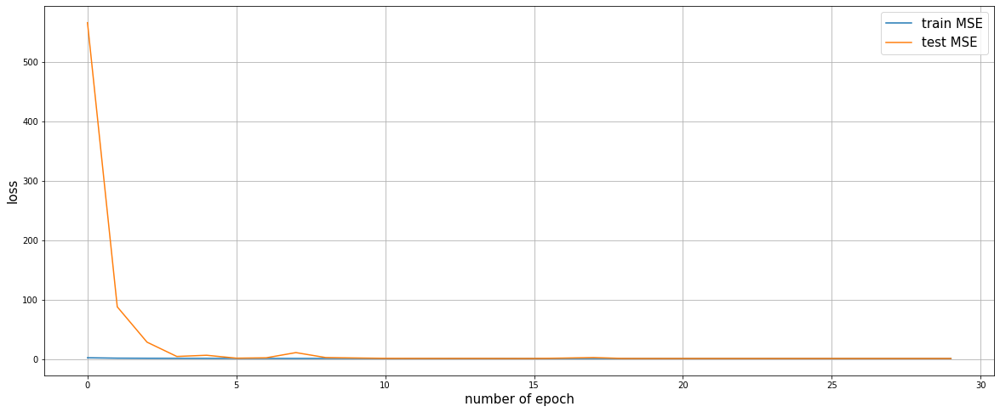

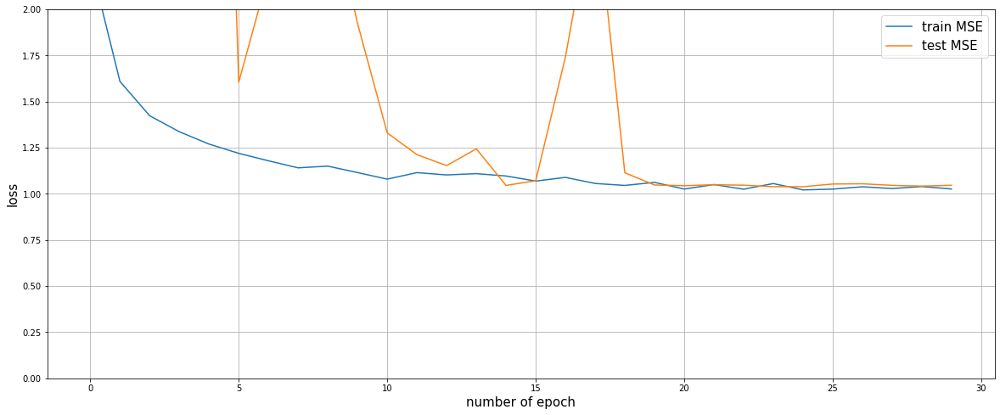

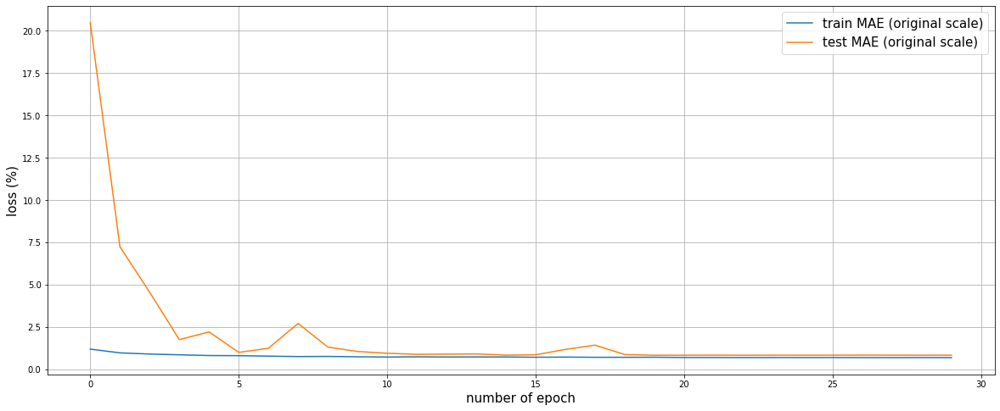

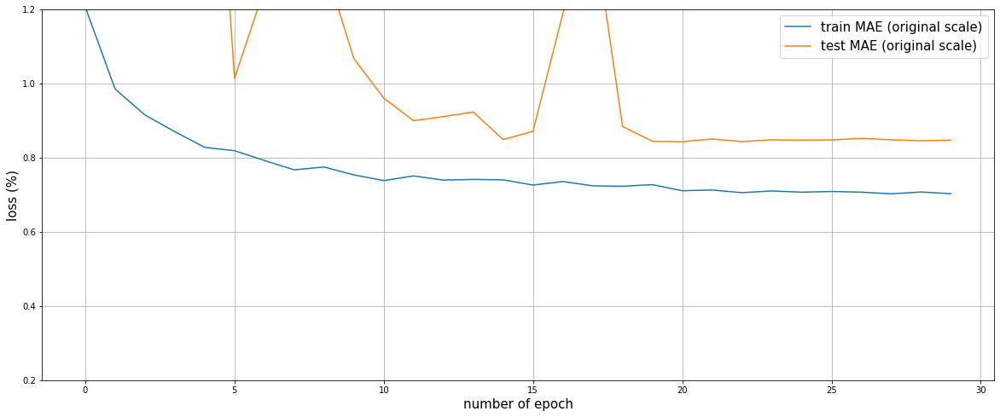

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.804%
 0.50 min.


optimizer = RMSprop, epoch = 30



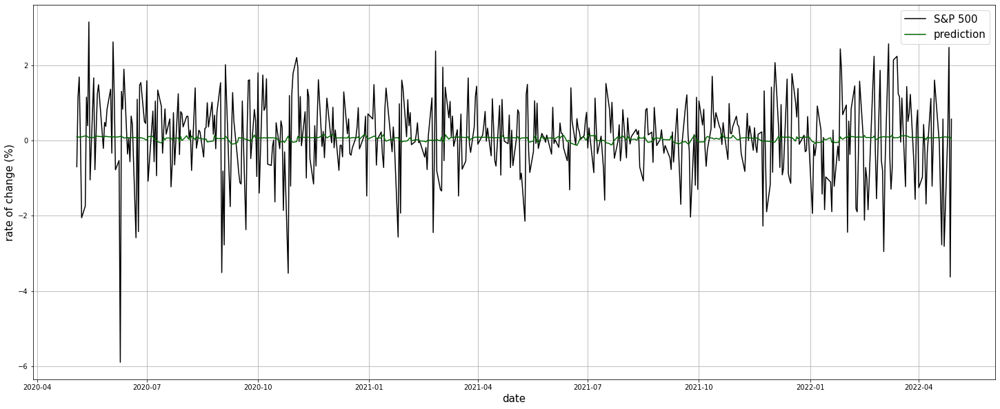

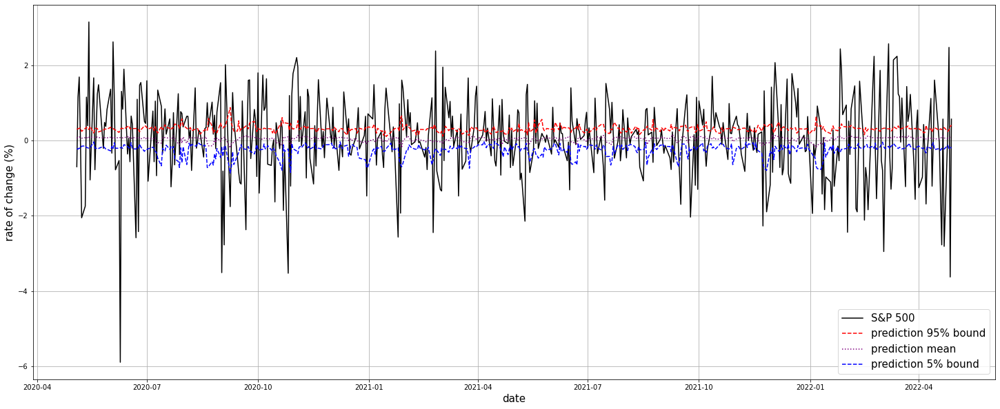

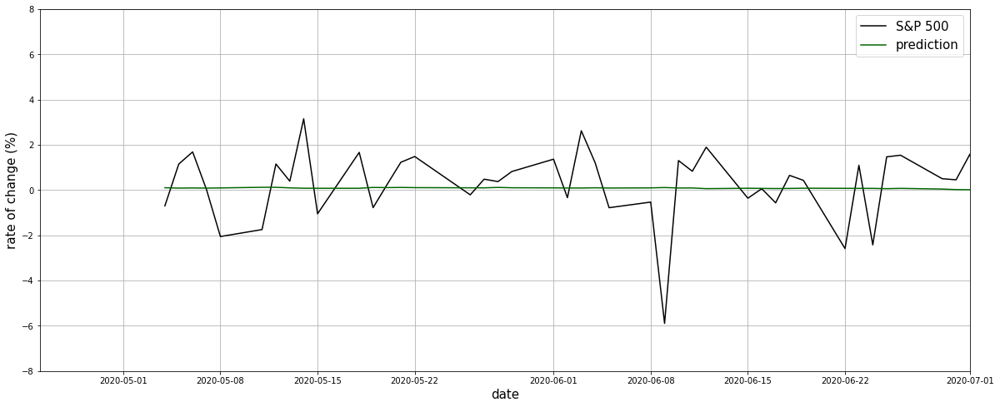

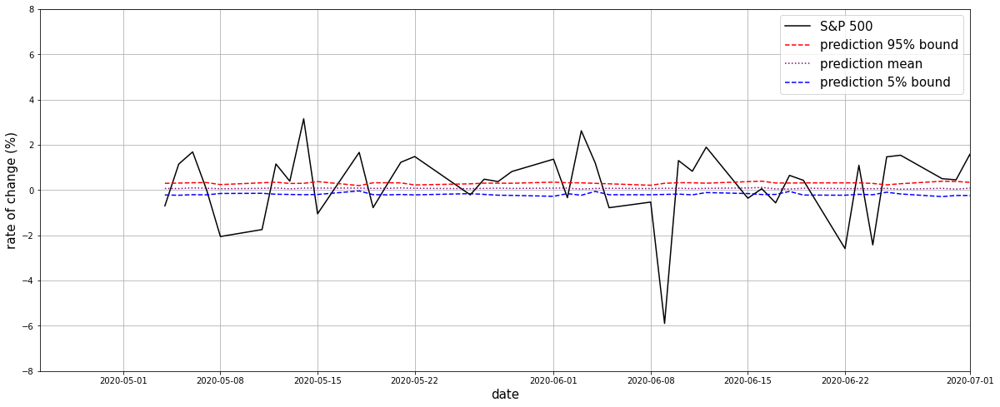

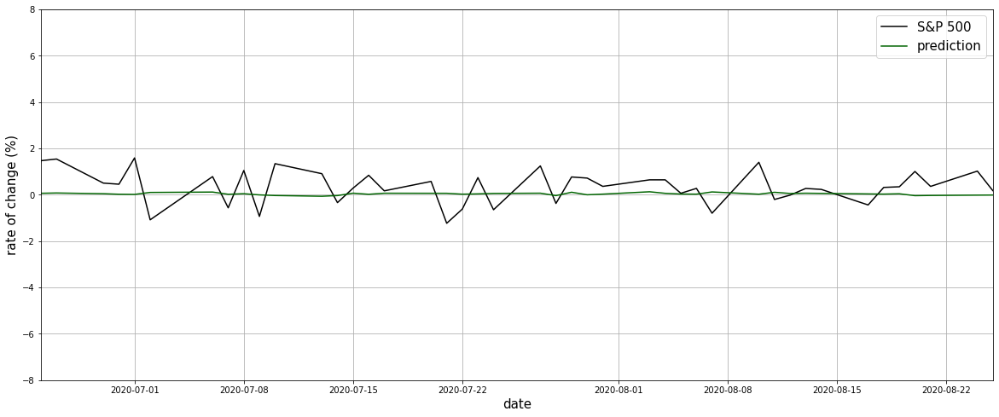

...

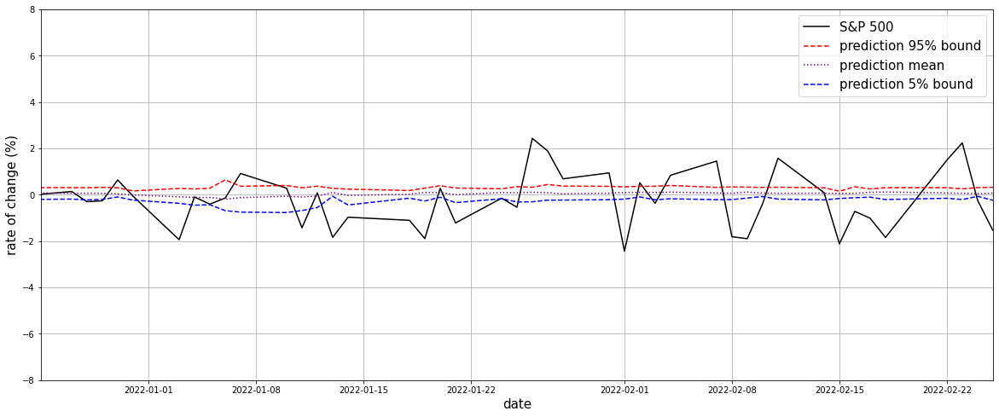

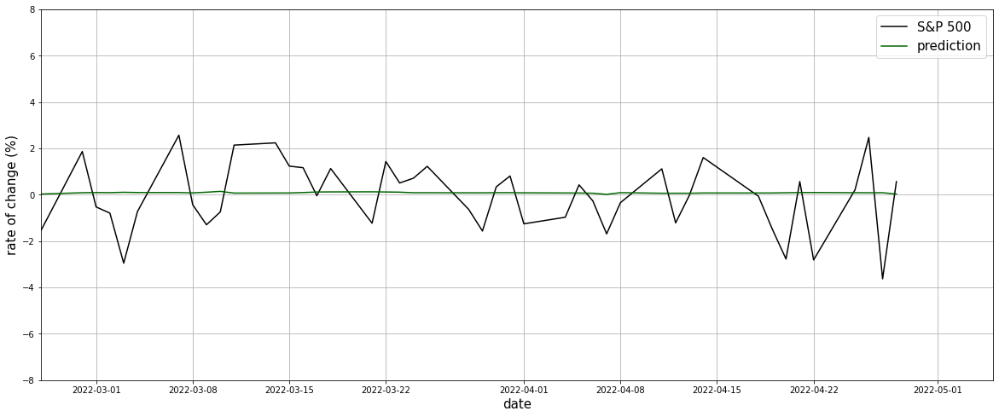

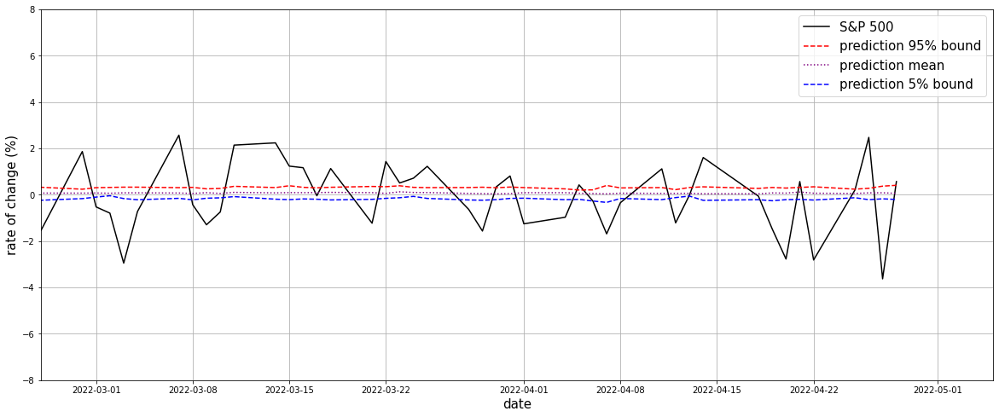

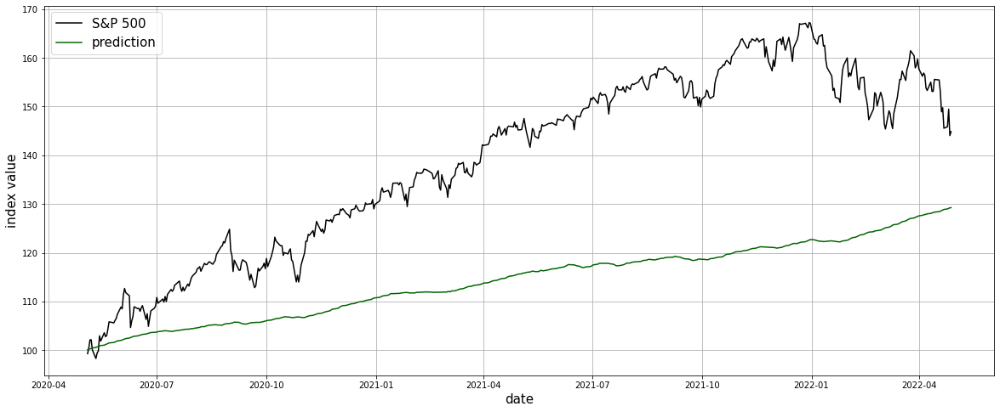

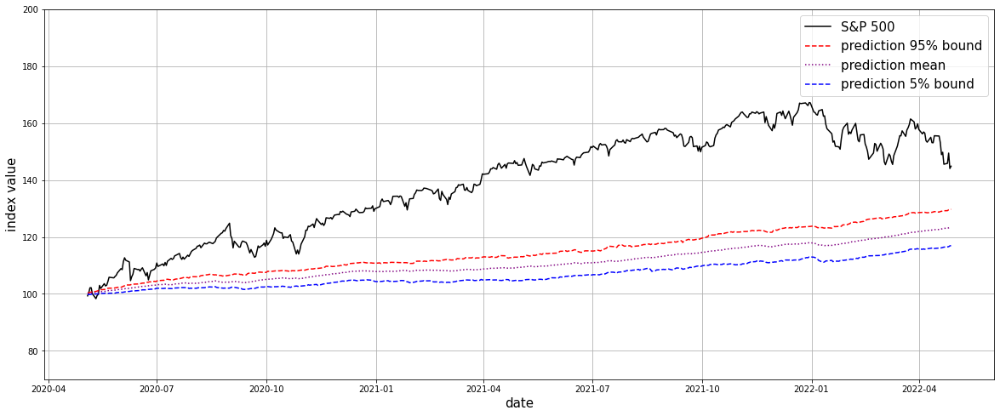

 0.36 min.


optimizer = Nadam, epoch = 30

Epoch 1/30
32/32 [==============================] - 7s 47ms/step - loss: 2.9805 - mean_absolute_error: 1.2770 - val_loss: 502.7554 - val_mean_absolute_error: 19.3273
Epoch 2/30
32/32 [==============================] - 1s 36ms/step - loss: 1.9262 - mean_absolute_error: 1.0251 - val_loss: 148.9765 - val_mean_absolute_error: 9.7226
Epoch 3/30
32/32 [==============================] - 1s 36ms/step - loss: 1.6659 - mean_absolute_error: 0.9129 - val_loss: 8.9835 - val_mean_absolute_error: 2.5080
Epoch 4/30
32/32 [==============================] - 1s 36ms/step - loss: 1.5874 - mean_absolute_error: 0.8810 - val_loss: 5.0461 - val_mean_absolute_error: 1.8026
Epoch 5/30
32/32 [==============================] - 1s 36ms/step - loss: 1.4223 - mean_absolute_error: 0.8239 - val_loss: 2.1283 - val_mean_absolute_error: 1.1867
Epoch 6/30
32/32 [==============================] - 1s 36ms/step - loss: 1.2847 - mean_absolute_error: 0.7794 - val_loss: 2.6424 - val_m

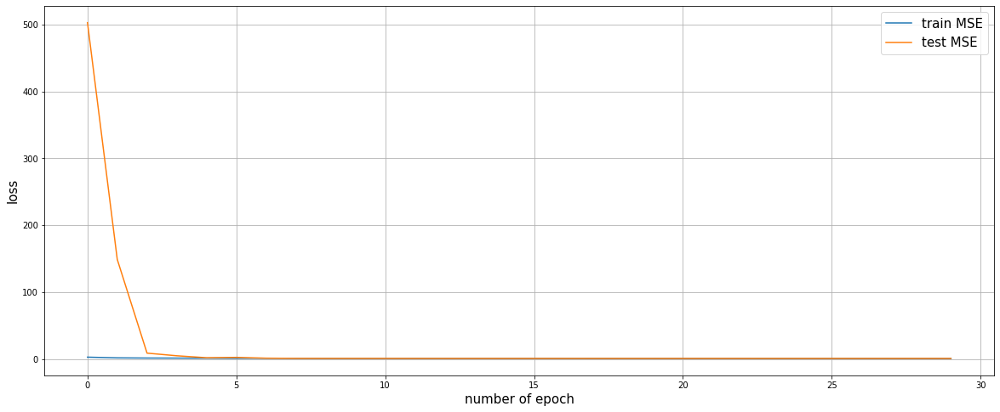

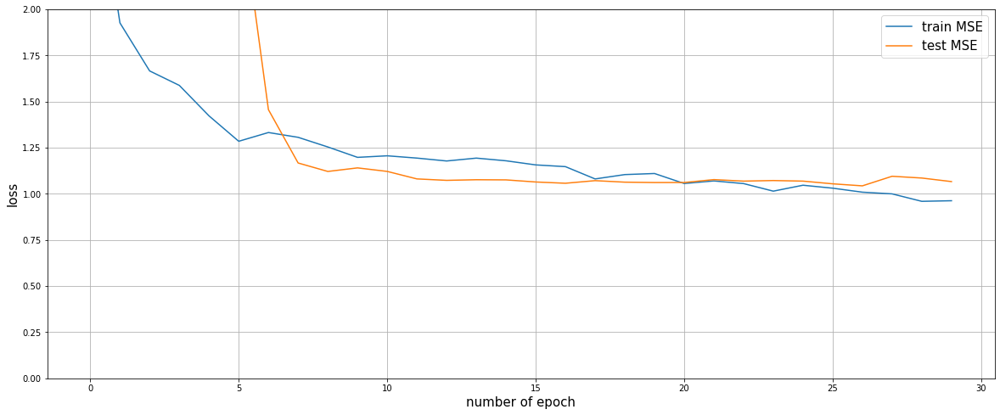

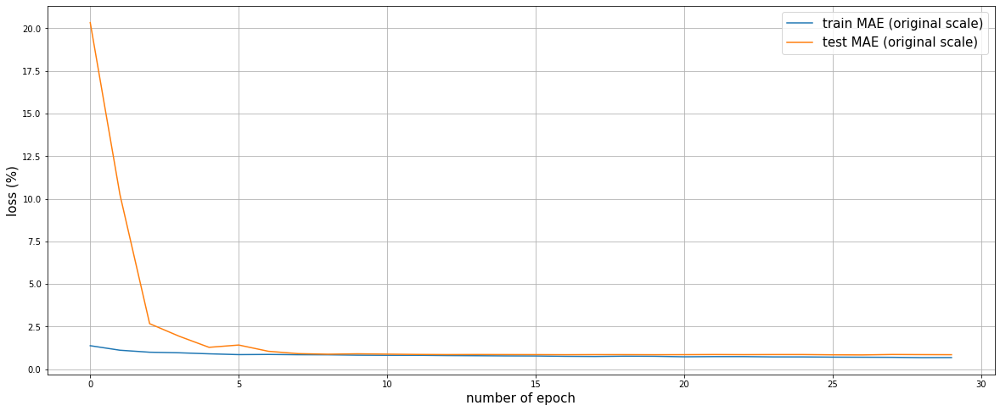

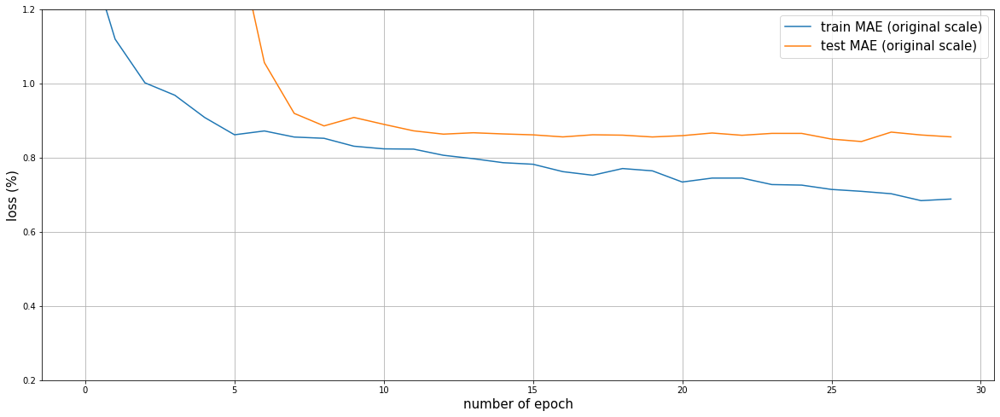

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.813%
 0.70 min.


optimizer = Nadam, epoch = 30



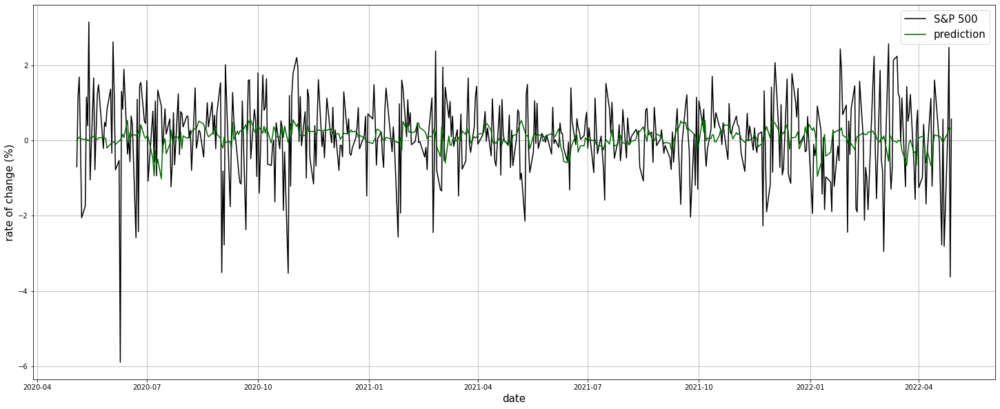

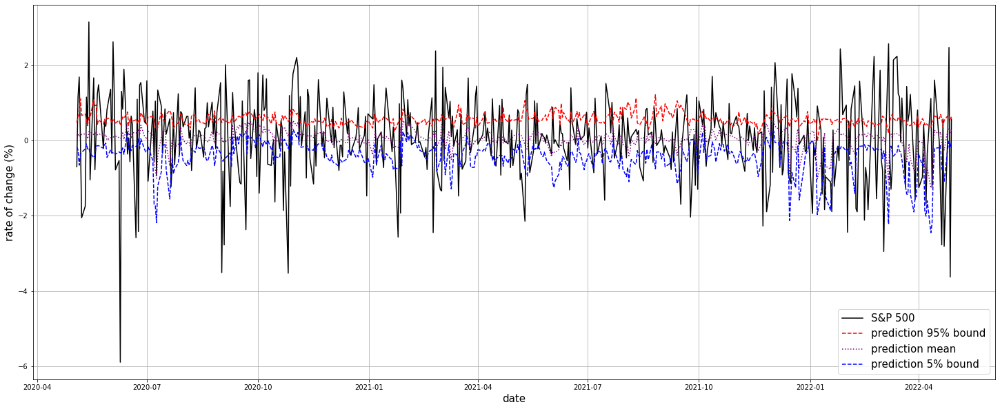

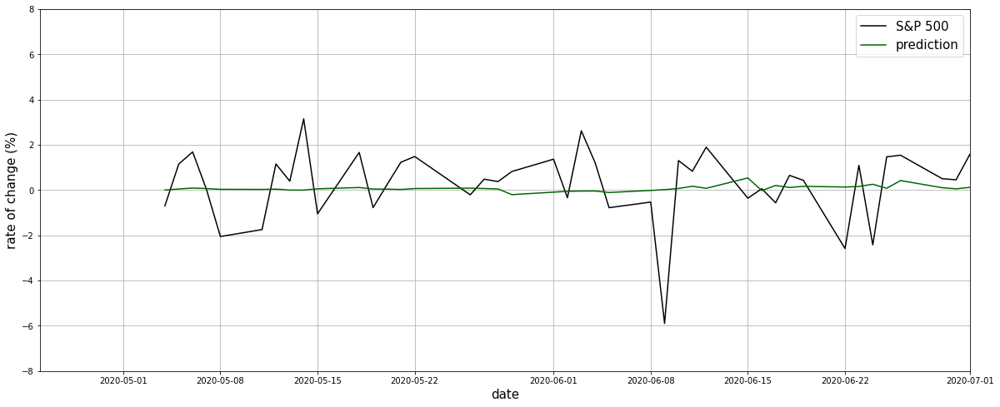

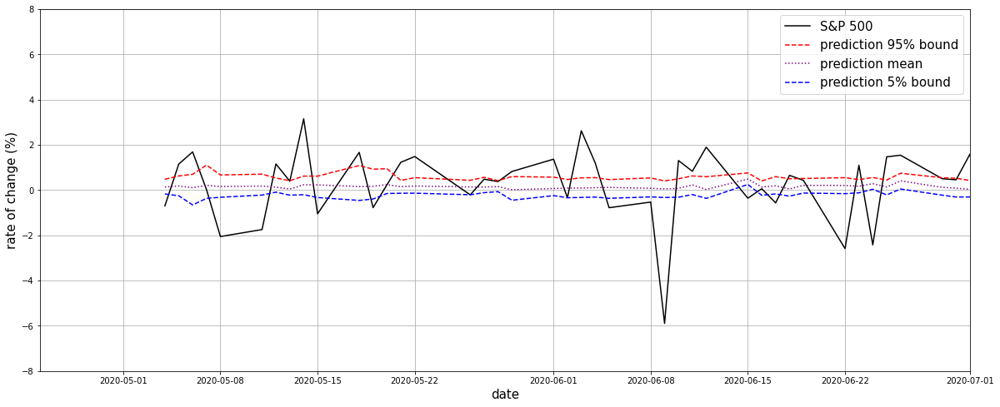

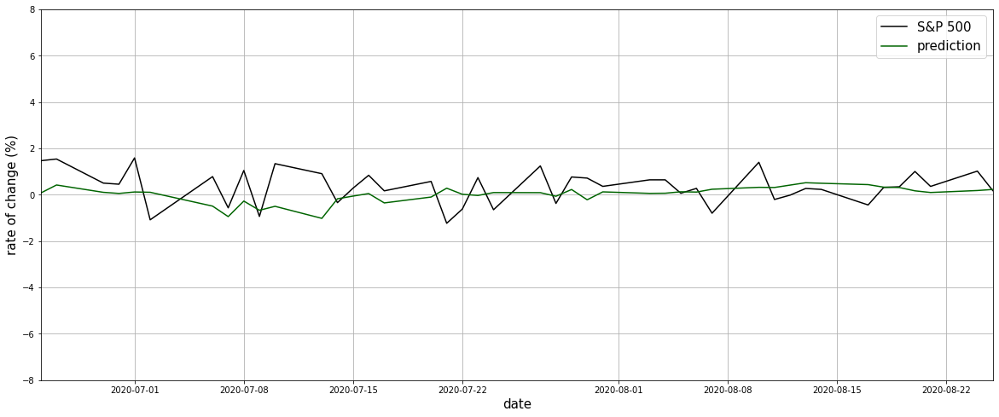

...

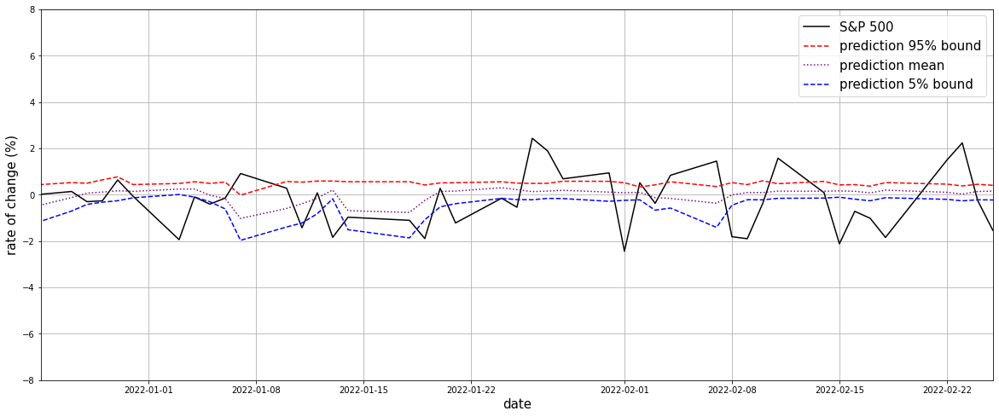

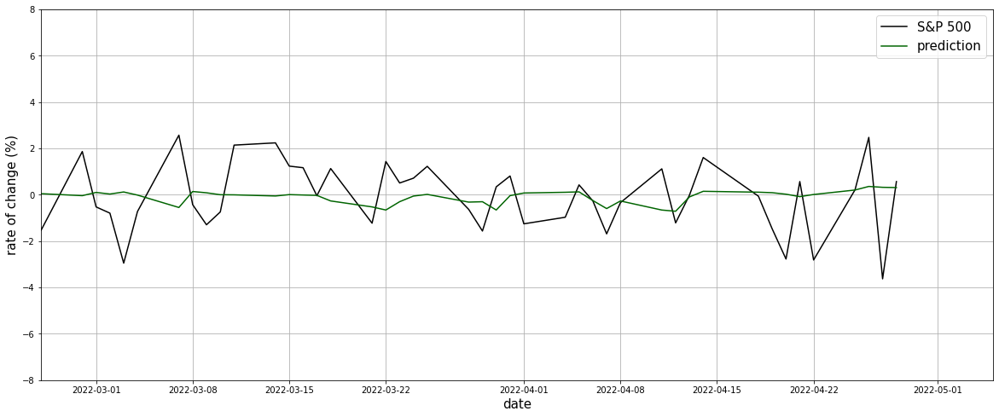

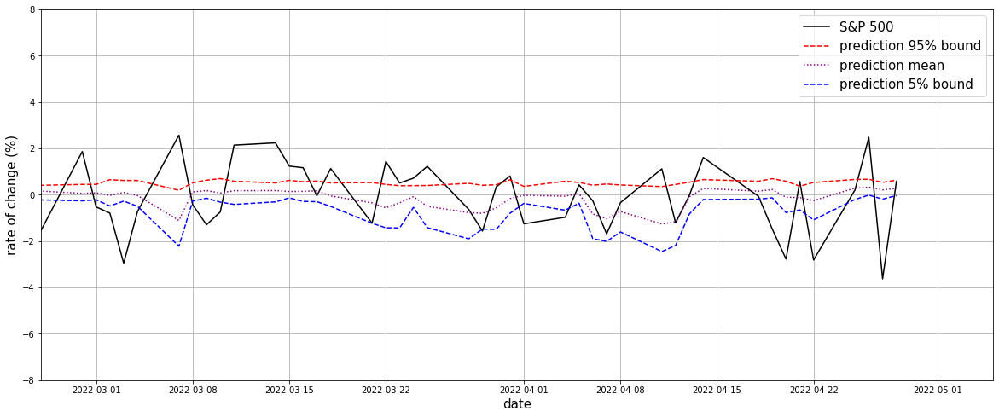

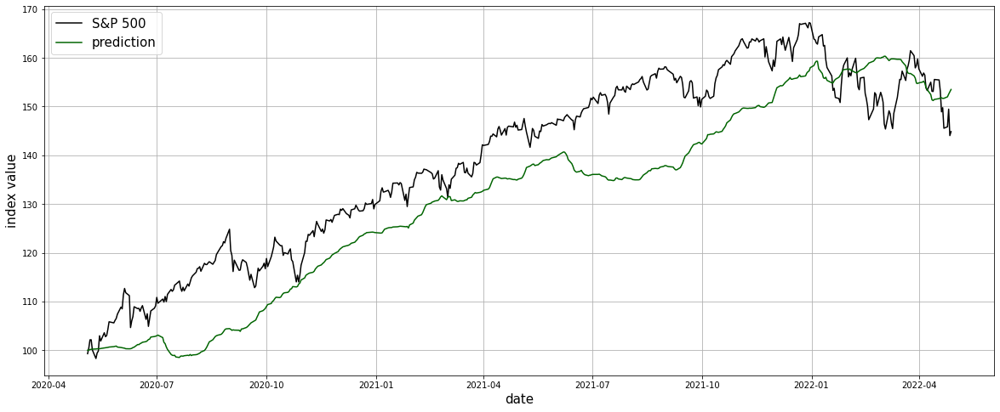

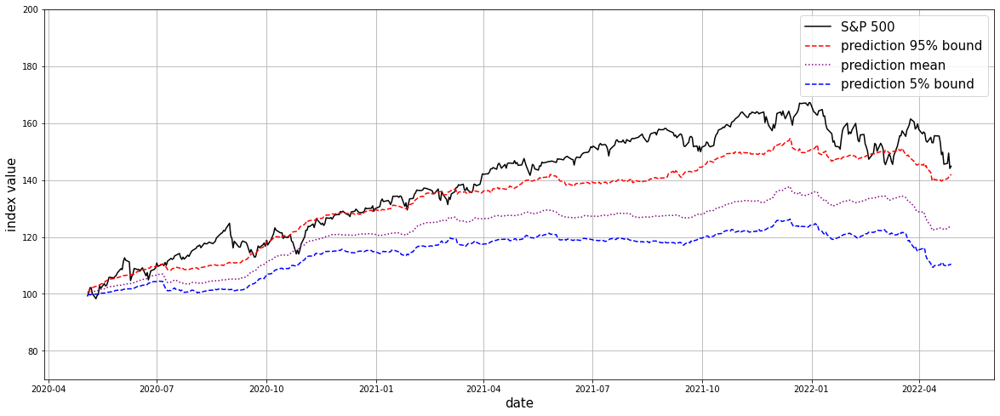

 0.35 min.


optimizer = Adadelta, epoch = 30

Epoch 1/30
32/32 [==============================] - 4s 31ms/step - loss: 3.0890 - mean_absolute_error: 1.2981 - val_loss: 4.3446 - val_mean_absolute_error: 1.6653
Epoch 2/30
32/32 [==============================] - 1s 19ms/step - loss: 2.8281 - mean_absolute_error: 1.2263 - val_loss: 2.9228 - val_mean_absolute_error: 1.3343
Epoch 3/30
32/32 [==============================] - 1s 20ms/step - loss: 2.9657 - mean_absolute_error: 1.2624 - val_loss: 2.3783 - val_mean_absolute_error: 1.1997
Epoch 4/30
32/32 [==============================] - 1s 19ms/step - loss: 2.8897 - mean_absolute_error: 1.2681 - val_loss: 2.2379 - val_mean_absolute_error: 1.1671
Epoch 5/30
32/32 [==============================] - 1s 19ms/step - loss: 2.8639 - mean_absolute_error: 1.2480 - val_loss: 2.2509 - val_mean_absolute_error: 1.1742
Epoch 6/30
32/32 [==============================] - 1s 20ms/step - loss: 2.9661 - mean_absolute_error: 1.2694 - val_loss: 2.2575 - val_mea

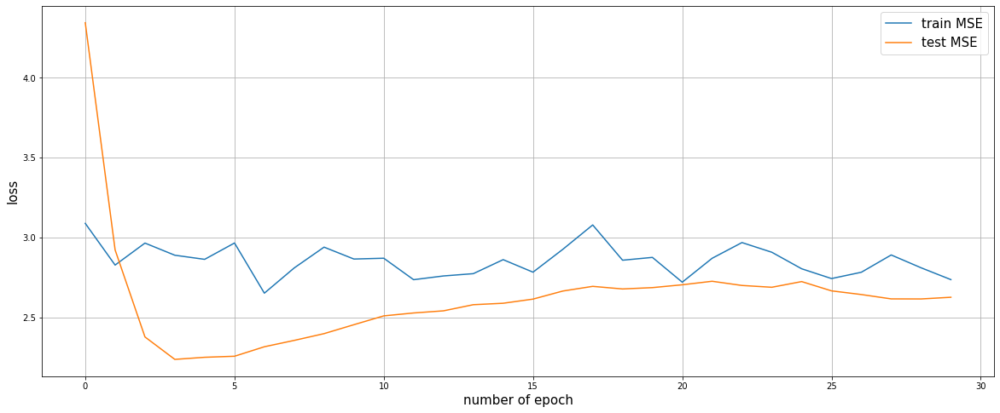

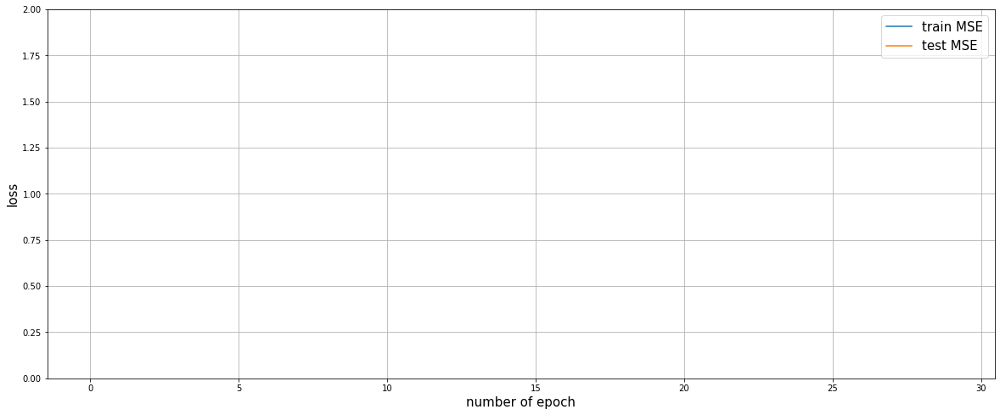

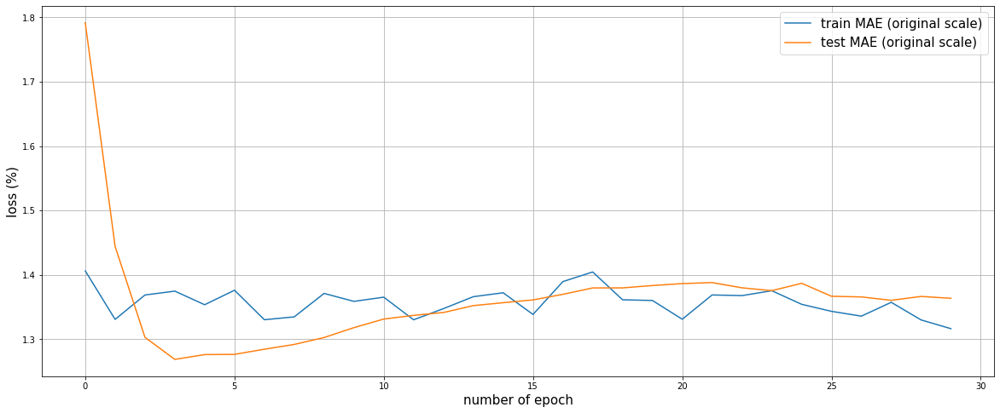

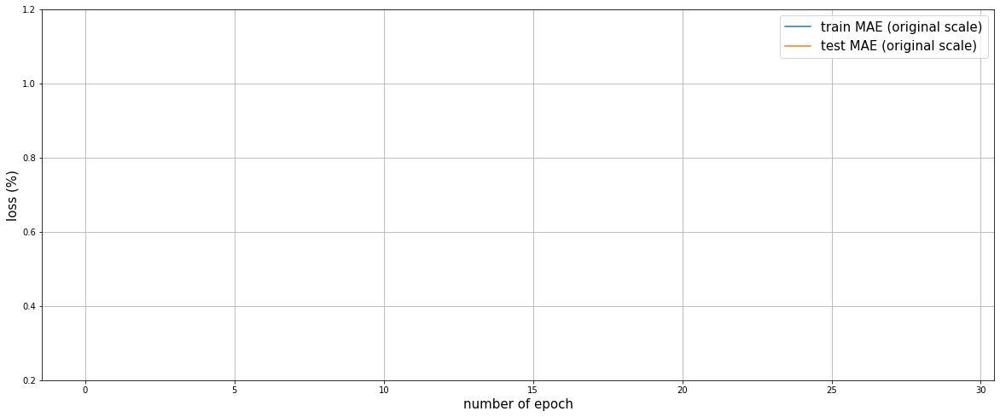

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  1.320%
 0.40 min.


optimizer = Adadelta, epoch = 30



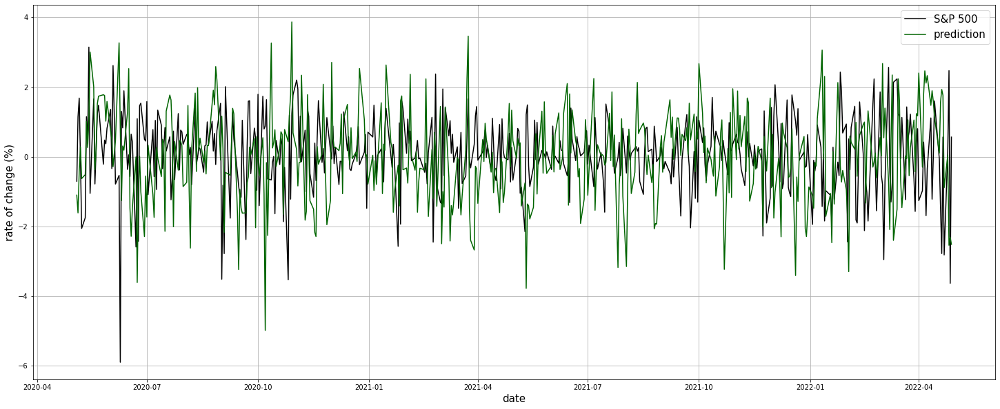

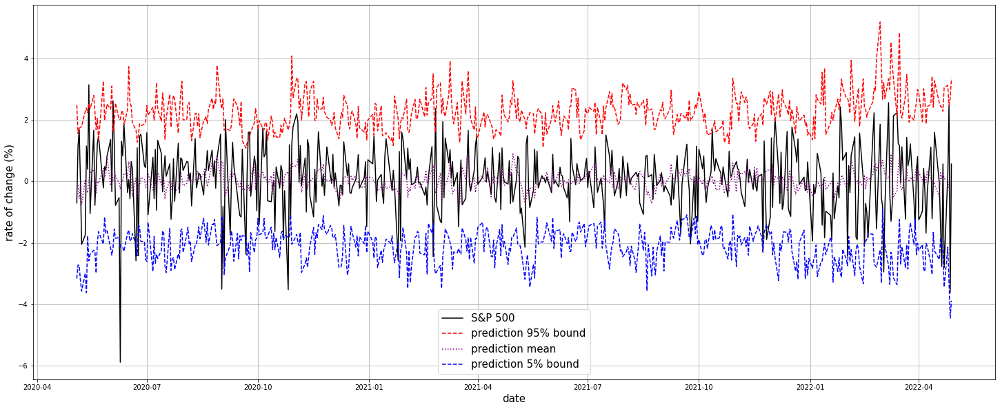

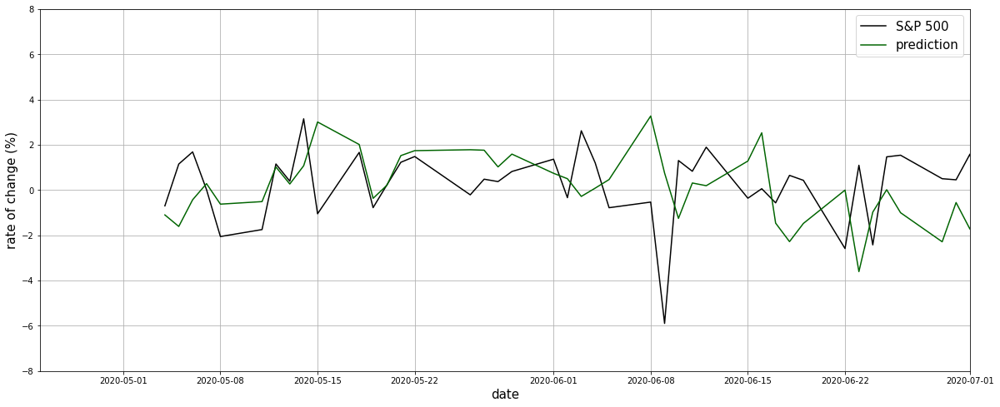

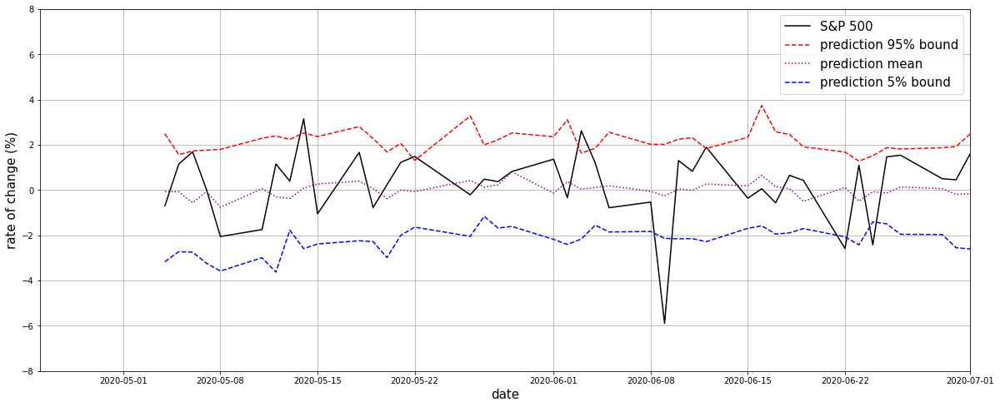

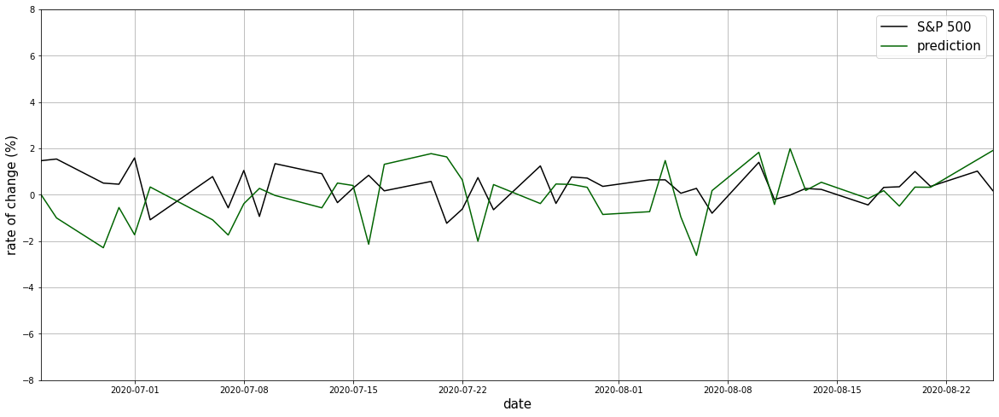

...

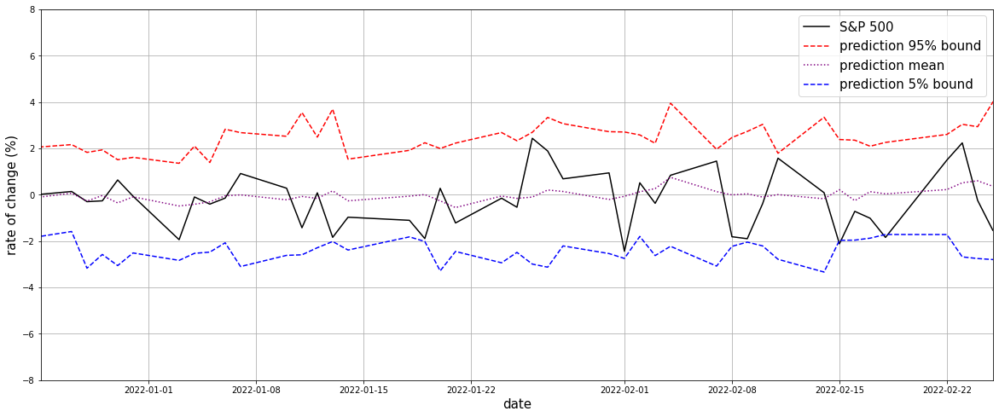

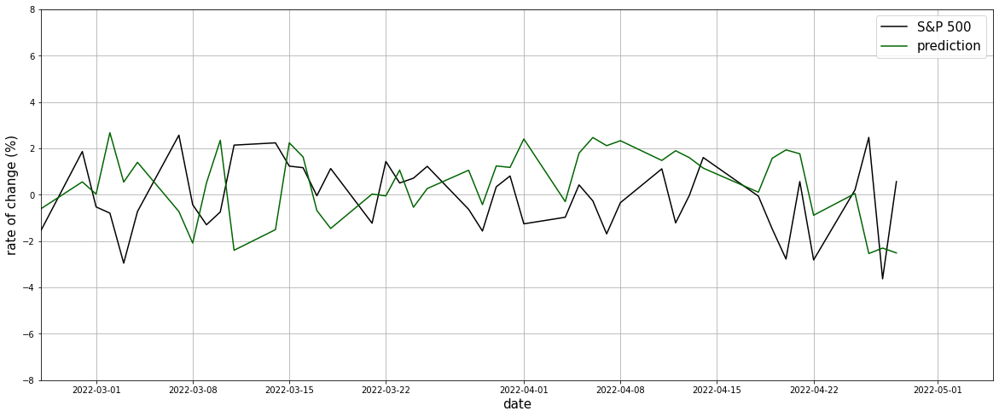

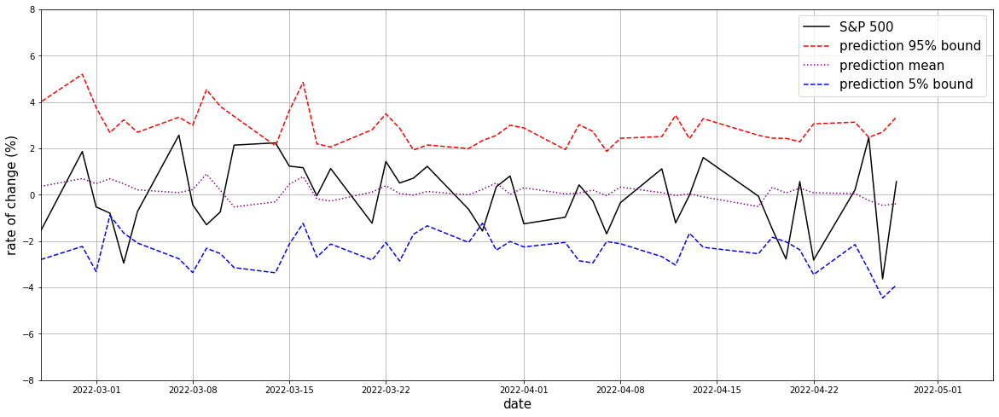

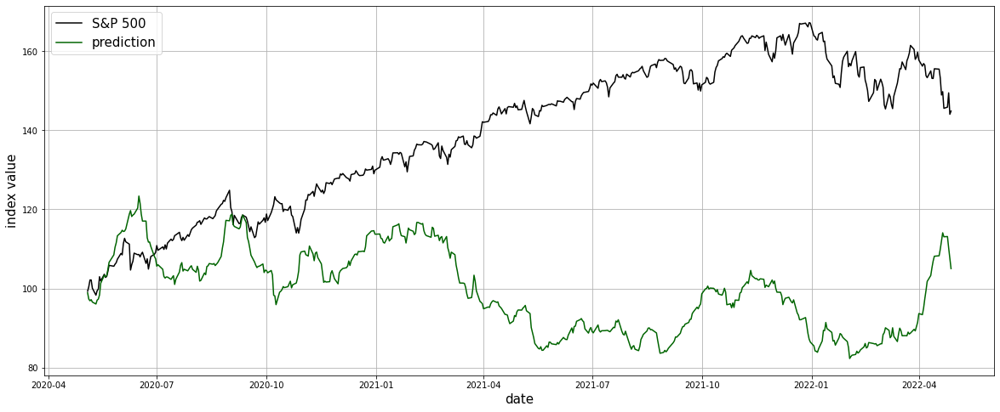

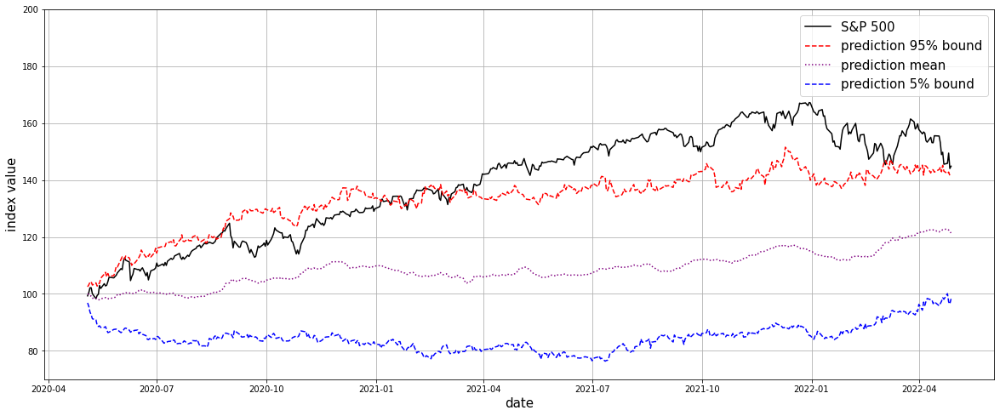

 0.36 min.


optimizer = Adam, epoch = 10

Epoch 1/10
32/32 [==============================] - 4s 30ms/step - loss: 2.6983 - mean_absolute_error: 1.2158 - val_loss: 9917.6689 - val_mean_absolute_error: 80.4874
Epoch 2/10
32/32 [==============================] - 1s 17ms/step - loss: 1.8460 - mean_absolute_error: 0.9663 - val_loss: 241.7636 - val_mean_absolute_error: 11.5094
Epoch 3/10
32/32 [==============================] - 1s 17ms/step - loss: 1.5826 - mean_absolute_error: 0.8820 - val_loss: 57.9106 - val_mean_absolute_error: 5.7911
Epoch 4/10
32/32 [==============================] - 1s 17ms/step - loss: 1.4433 - mean_absolute_error: 0.8297 - val_loss: 22.6976 - val_mean_absolute_error: 3.5920
Epoch 5/10
32/32 [==============================] - 1s 17ms/step - loss: 1.3278 - mean_absolute_error: 0.7791 - val_loss: 5.9722 - val_mean_absolute_error: 1.8867
Epoch 6/10
32/32 [==============================] - 1s 17ms/step - loss: 1.2539 - mean_absolute_error: 0.7537 - val_loss: 1.2781 - va

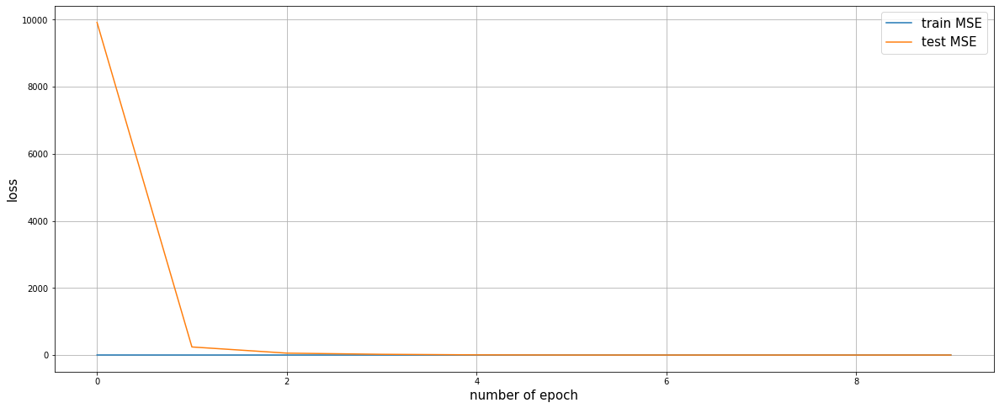

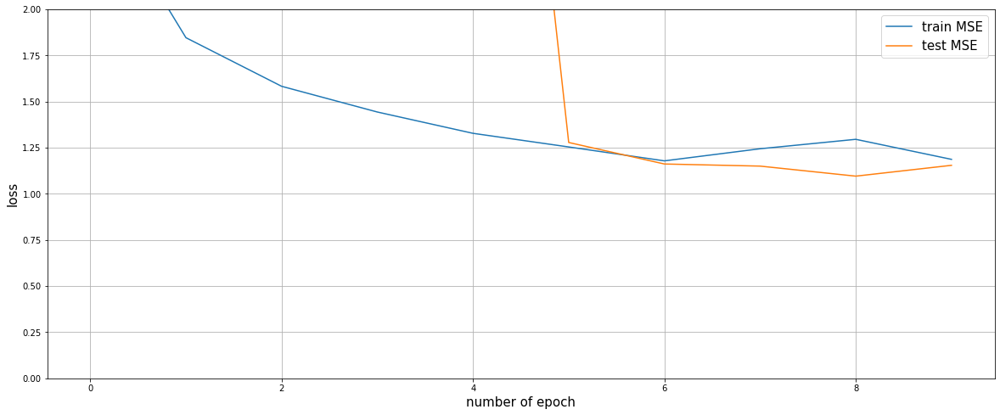

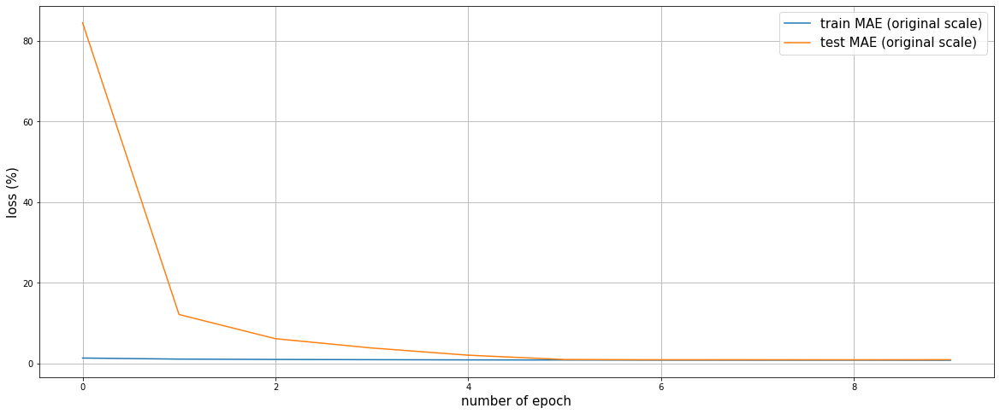

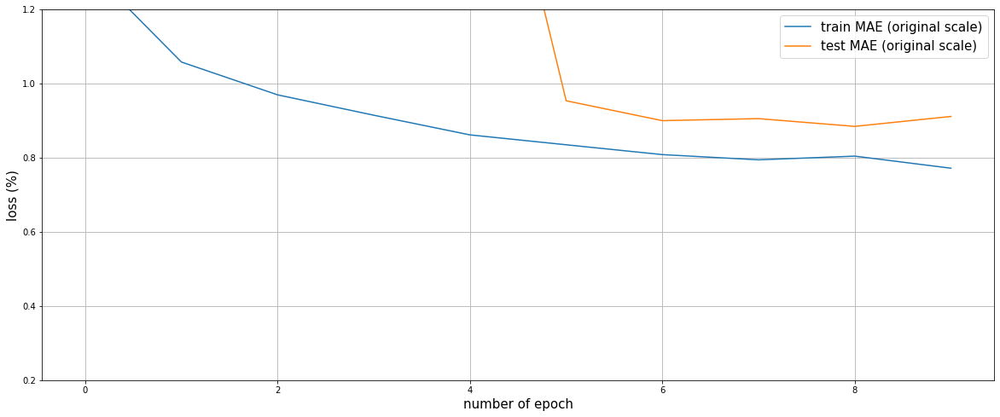

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.868%
 0.18 min.


optimizer = Adam, epoch = 10



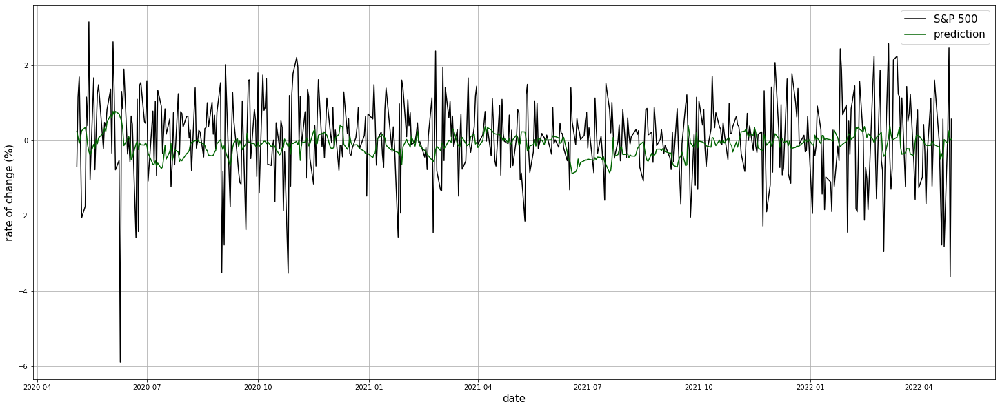

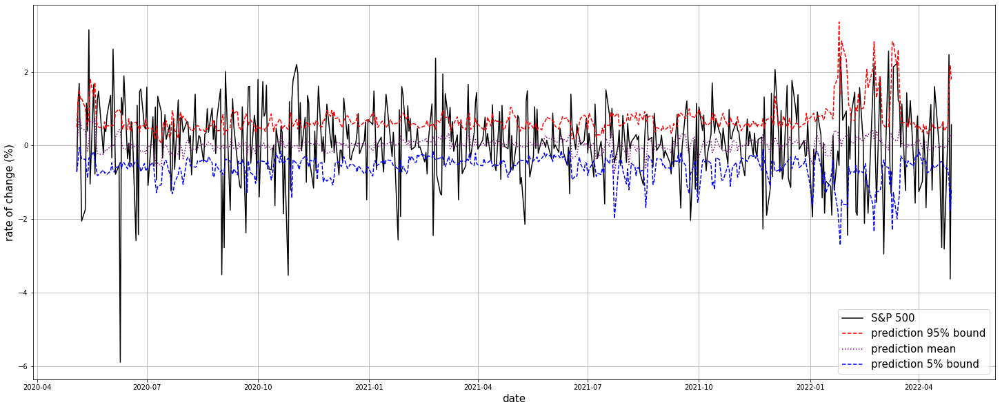

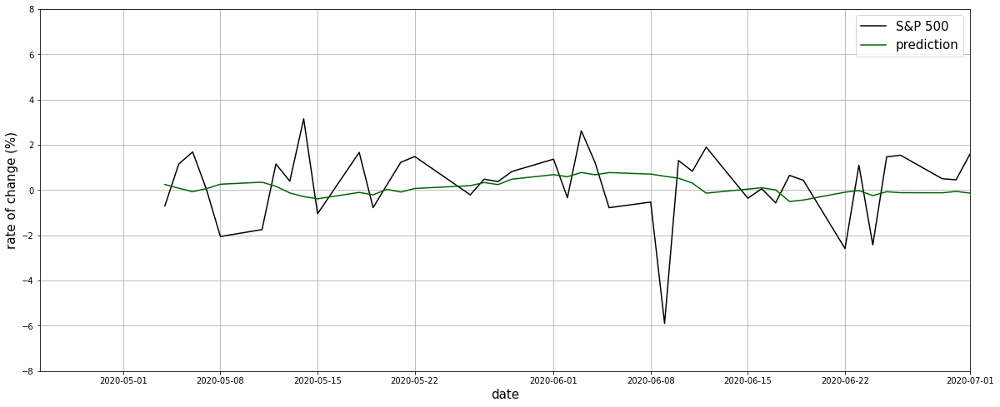

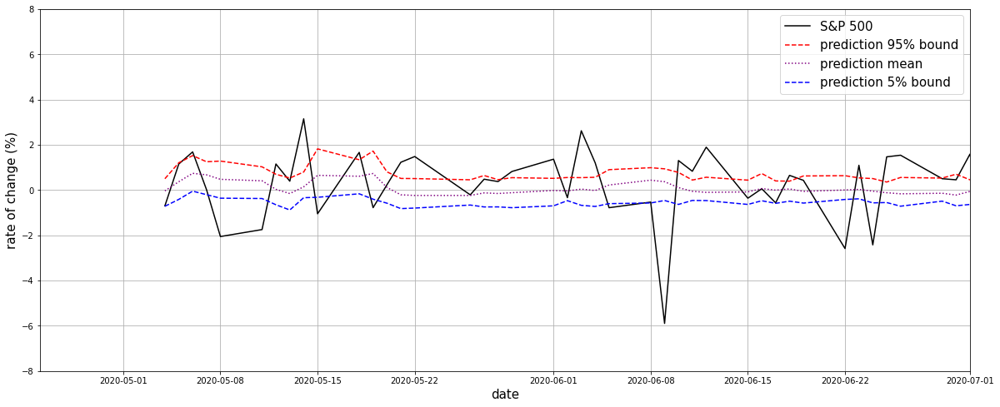

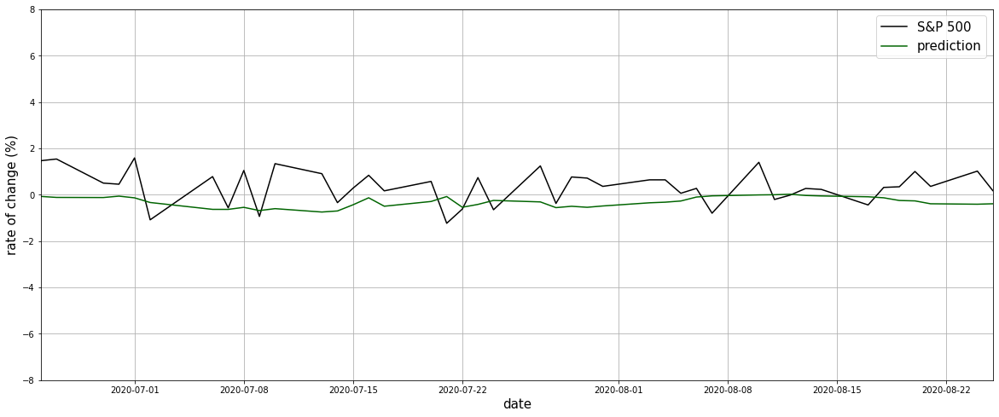

...

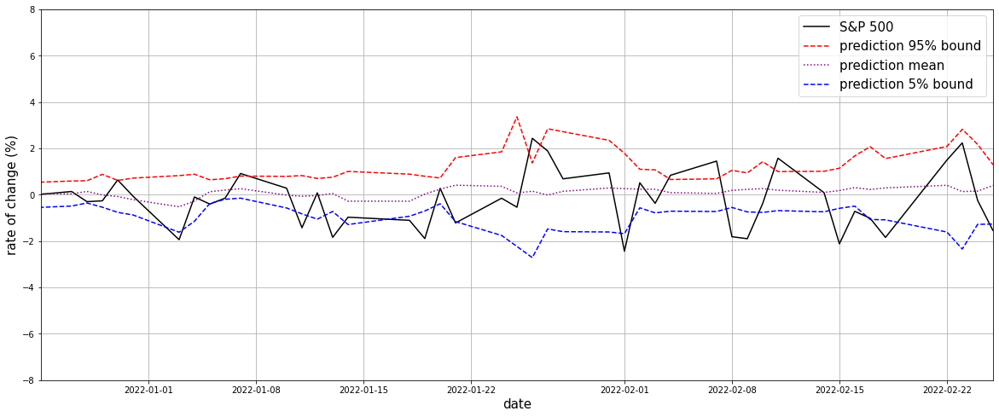

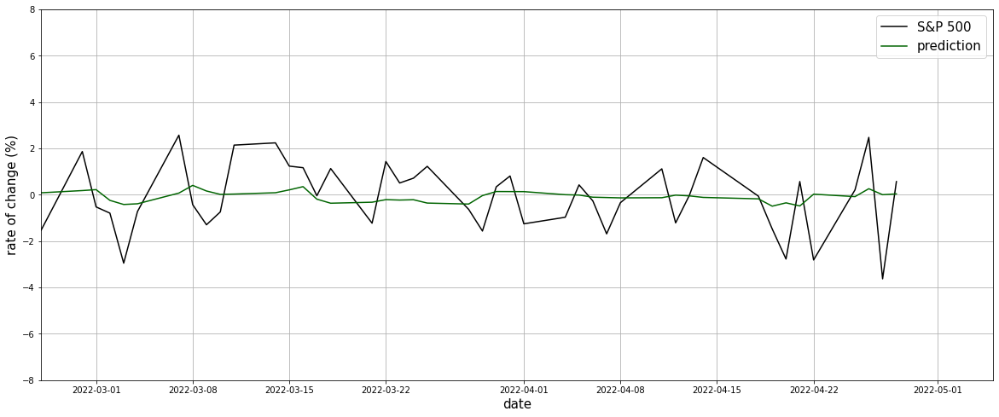

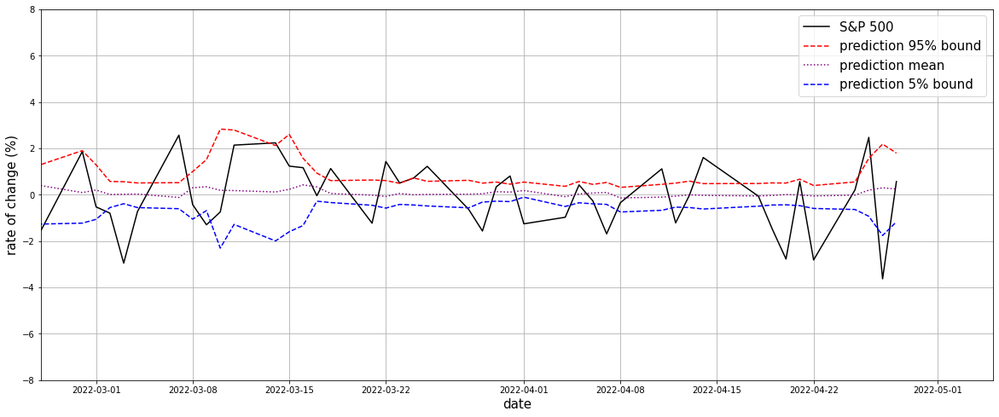

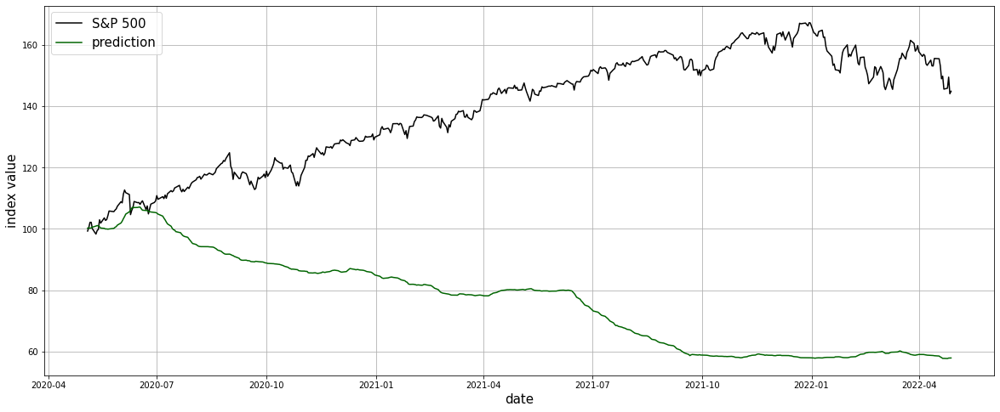

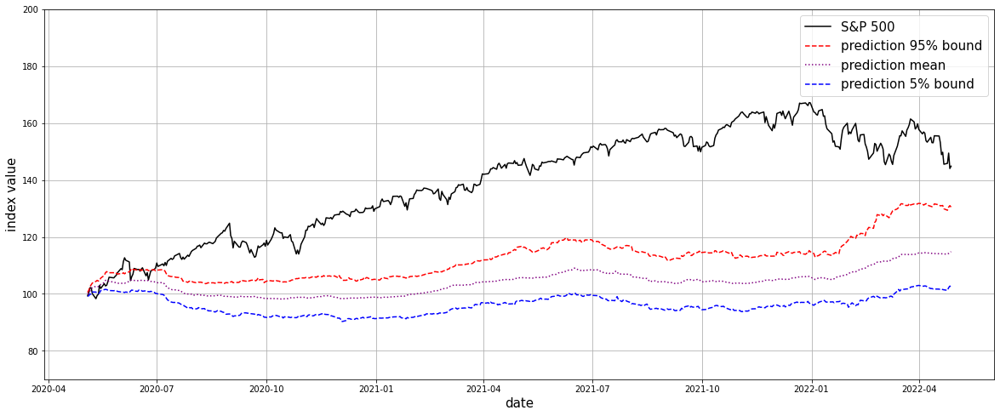

 0.38 min.


optimizer = Adam, epoch = 20

Epoch 1/20
32/32 [==============================] - 4s 29ms/step - loss: 3.5542 - mean_absolute_error: 1.3976 - val_loss: 3741.5361 - val_mean_absolute_error: 54.3630
Epoch 2/20
32/32 [==============================] - 1s 17ms/step - loss: 2.1947 - mean_absolute_error: 1.0671 - val_loss: 528.3312 - val_mean_absolute_error: 19.3878
Epoch 3/20
32/32 [==============================] - 1s 18ms/step - loss: 1.6187 - mean_absolute_error: 0.9242 - val_loss: 81.9012 - val_mean_absolute_error: 7.1633
Epoch 4/20
32/32 [==============================] - 1s 17ms/step - loss: 1.4281 - mean_absolute_error: 0.8444 - val_loss: 10.5419 - val_mean_absolute_error: 2.4320
Epoch 5/20
32/32 [==============================] - 1s 17ms/step - loss: 1.3581 - mean_absolute_error: 0.7883 - val_loss: 4.6222 - val_mean_absolute_error: 1.6582
Epoch 6/20
32/32 [==============================] - 1s 17ms/step - loss: 1.3017 - mean_absolute_error: 0.7514 - val_loss: 2.2633 - va

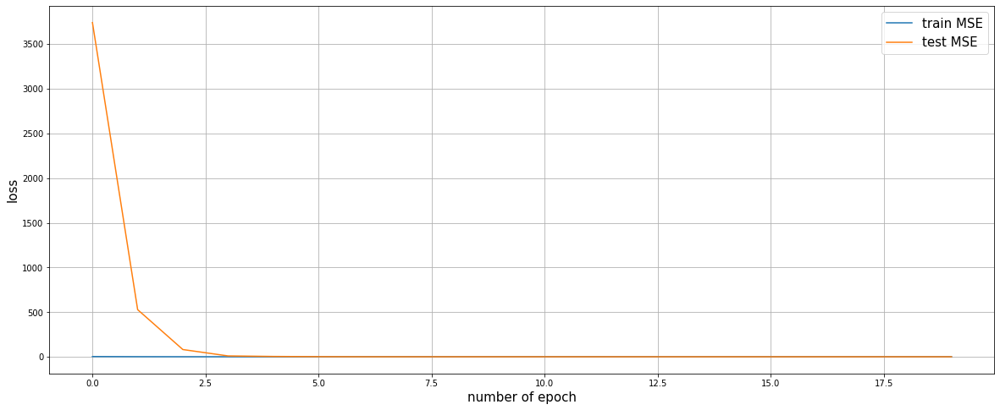

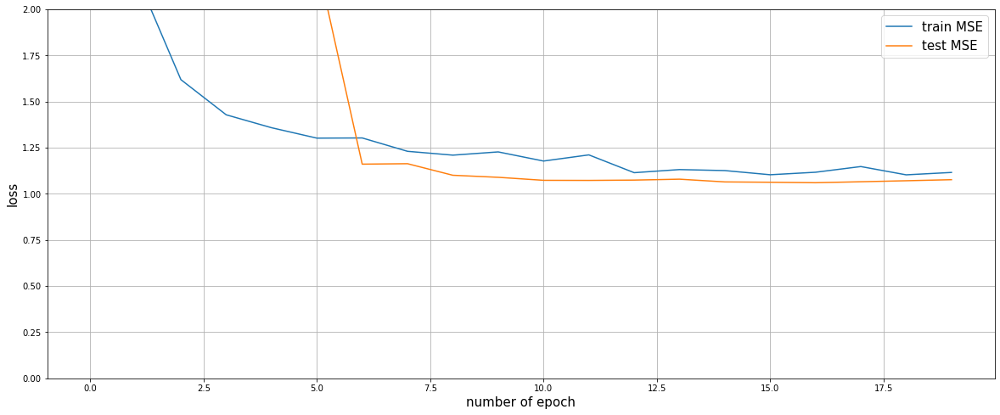

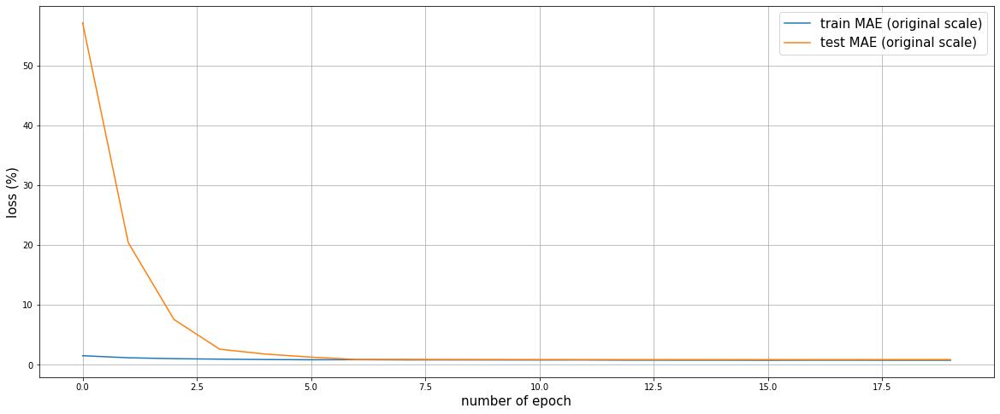

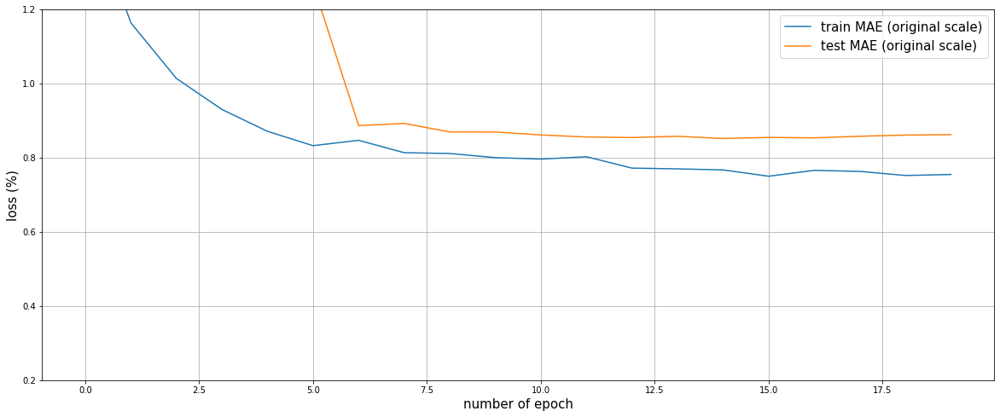

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.819%
 0.28 min.


optimizer = Adam, epoch = 20



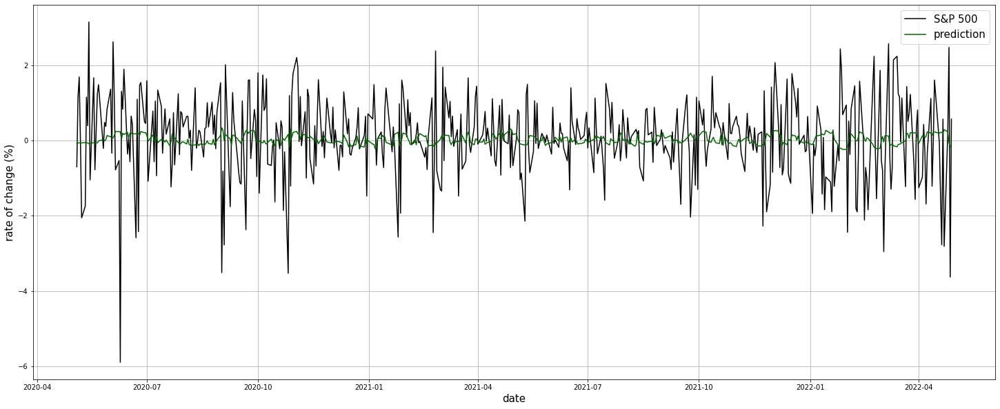

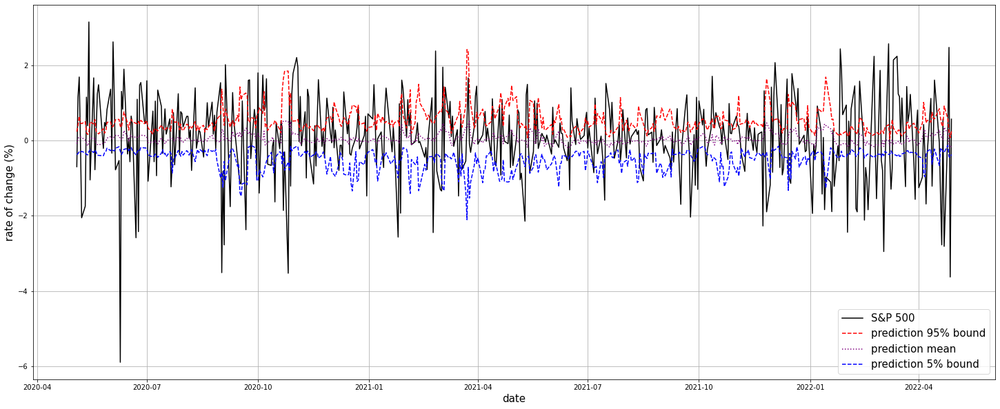

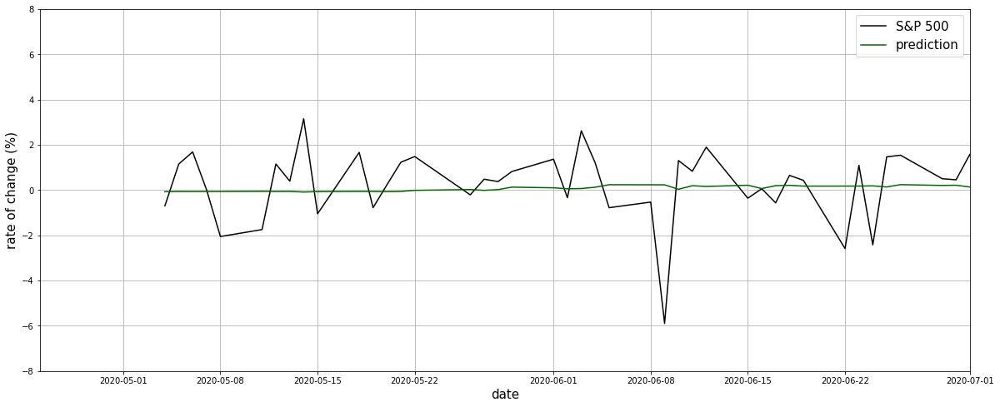

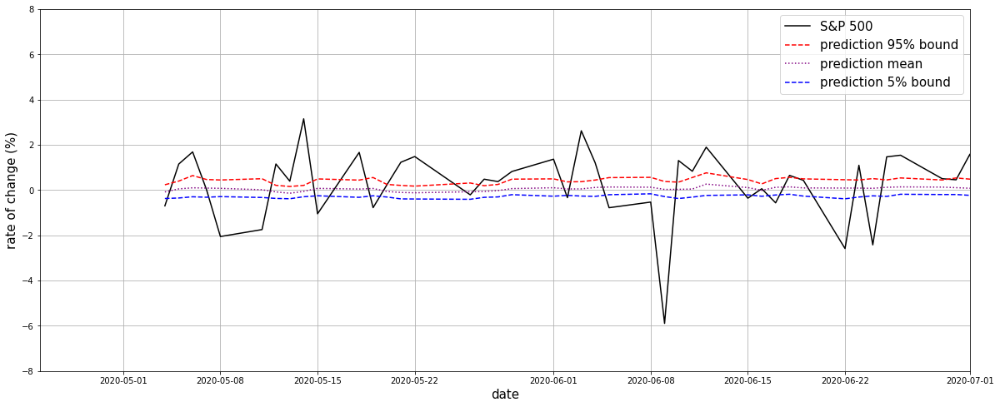

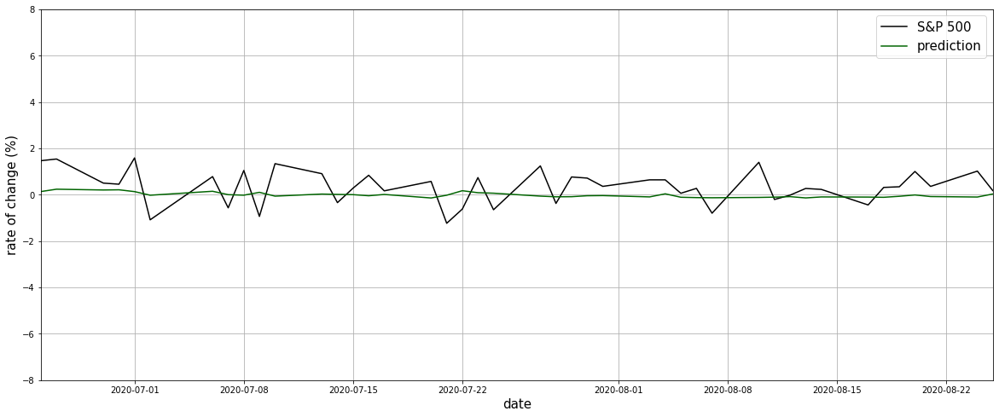

...

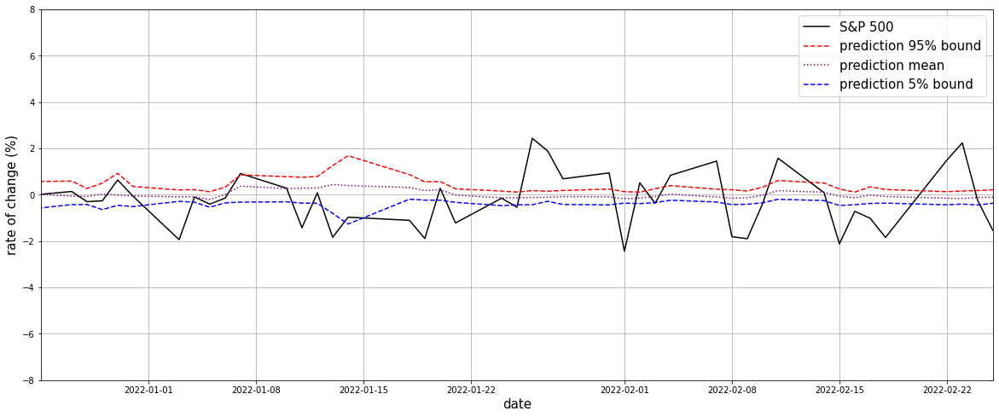

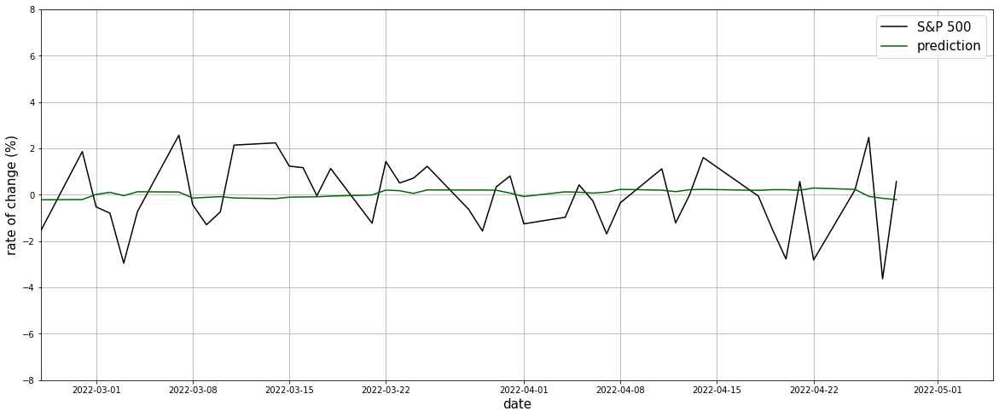

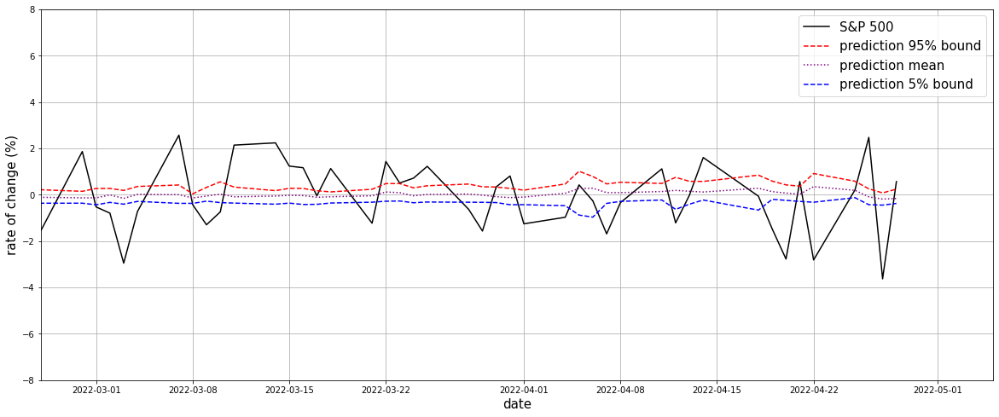

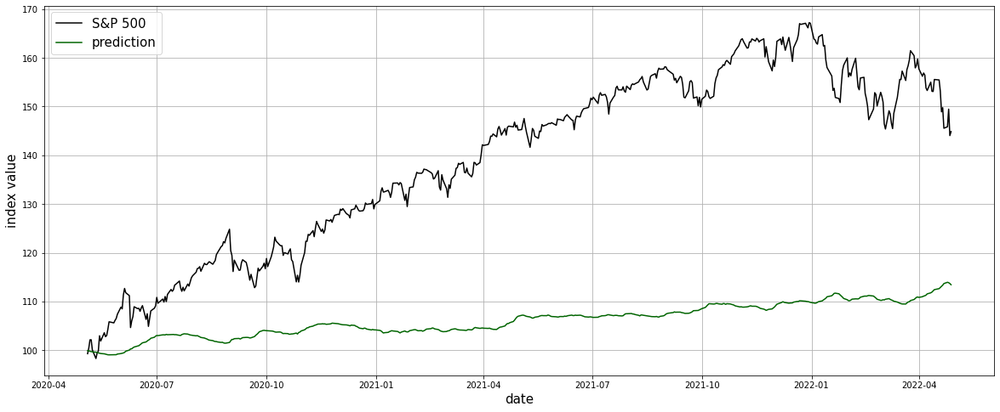

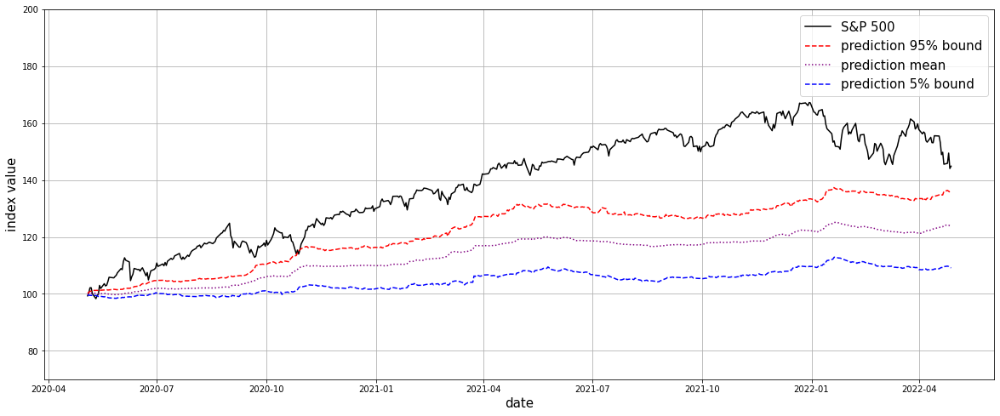

 0.35 min.


optimizer = Adam, epoch = 30

Epoch 1/30
32/32 [==============================] - 4s 28ms/step - loss: 3.0412 - mean_absolute_error: 1.2657 - val_loss: 1969.5999 - val_mean_absolute_error: 39.9184
Epoch 2/30
32/32 [==============================] - 1s 17ms/step - loss: 1.8905 - mean_absolute_error: 0.9902 - val_loss: 50.5725 - val_mean_absolute_error: 6.1790
Epoch 3/30
32/32 [==============================] - 1s 17ms/step - loss: 1.5880 - mean_absolute_error: 0.8891 - val_loss: 11.0418 - val_mean_absolute_error: 2.6956
Epoch 4/30
32/32 [==============================] - 1s 17ms/step - loss: 1.4412 - mean_absolute_error: 0.8195 - val_loss: 4.6810 - val_mean_absolute_error: 1.6718
Epoch 5/30
32/32 [==============================] - 1s 17ms/step - loss: 1.3775 - mean_absolute_error: 0.7946 - val_loss: 2.2210 - val_mean_absolute_error: 1.1283
Epoch 6/30
32/32 [==============================] - 1s 17ms/step - loss: 1.3516 - mean_absolute_error: 0.7809 - val_loss: 1.2973 - val_m

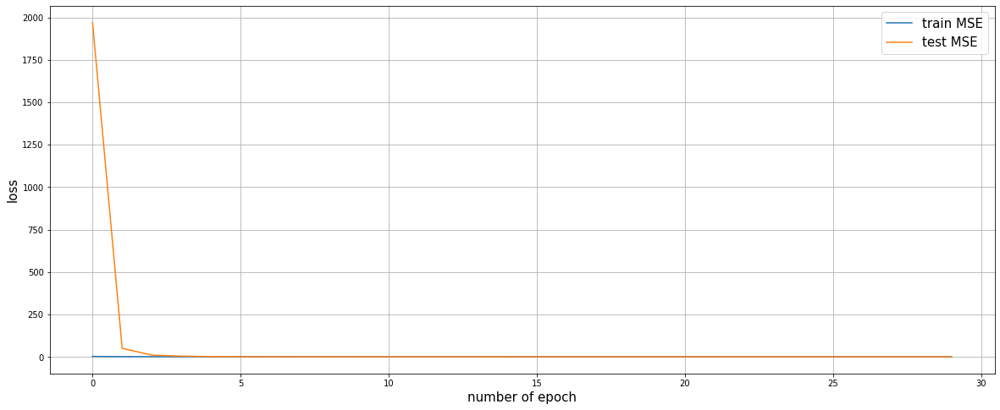

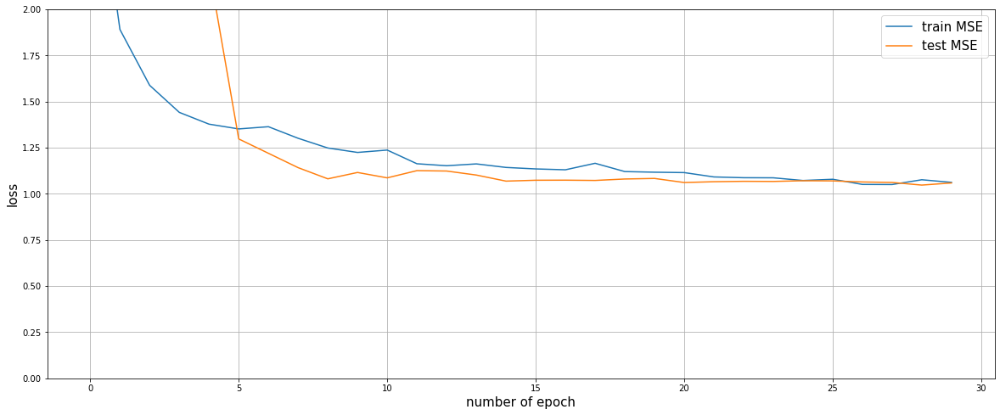

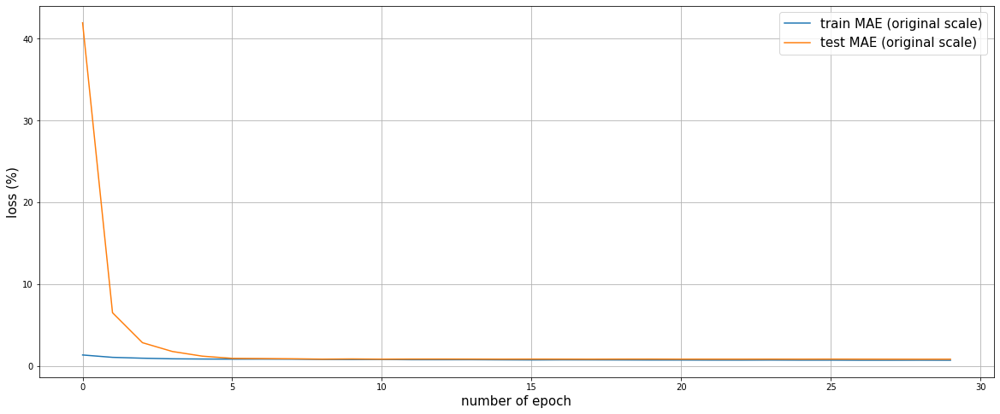

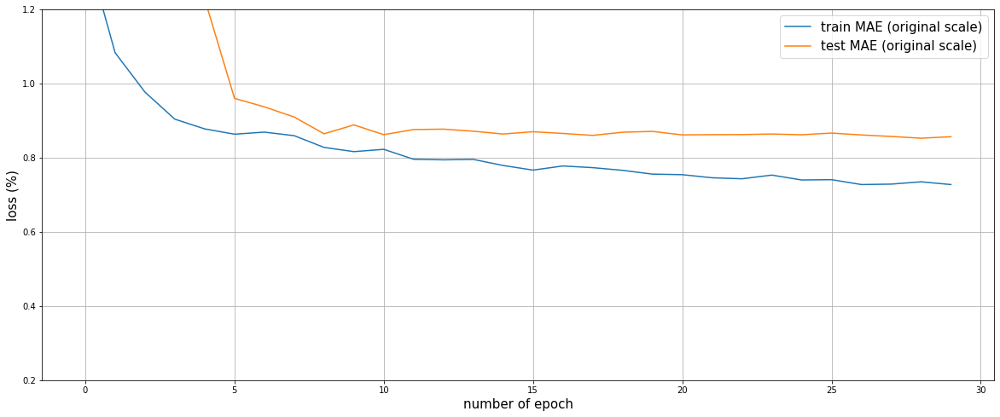

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.813%
 0.36 min.


optimizer = Adam, epoch = 30



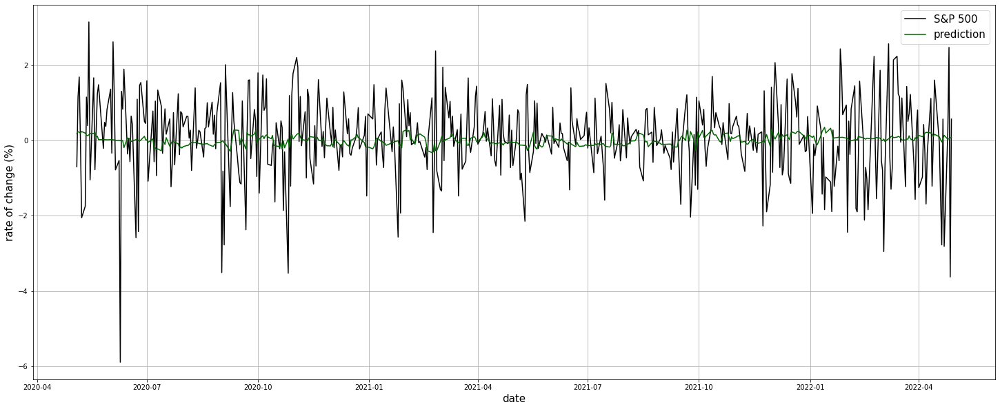

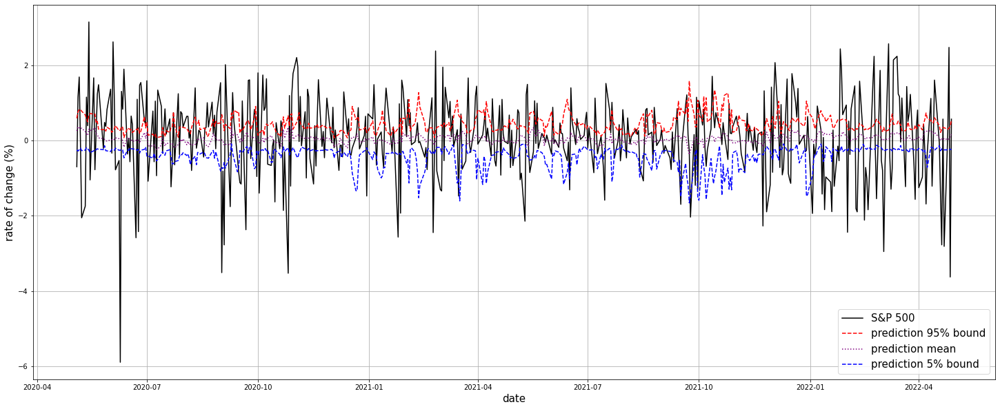

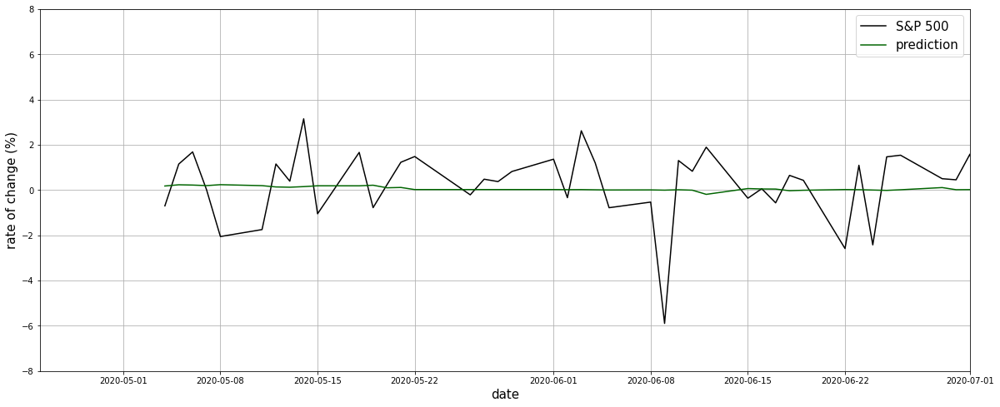

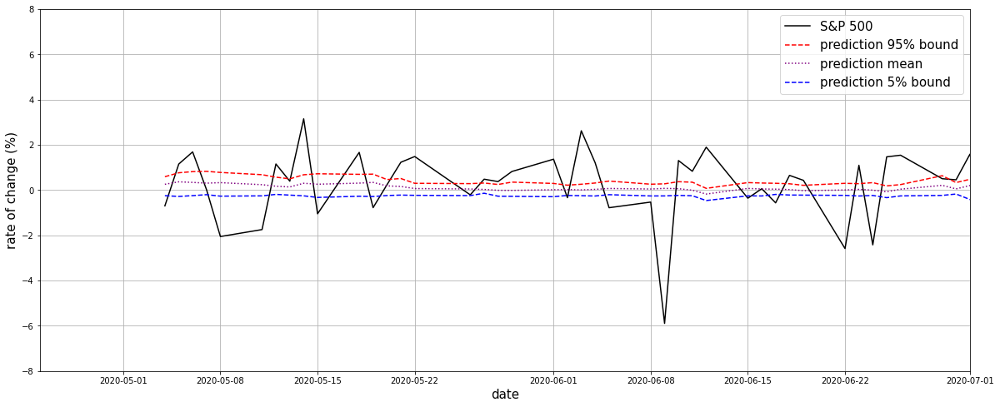

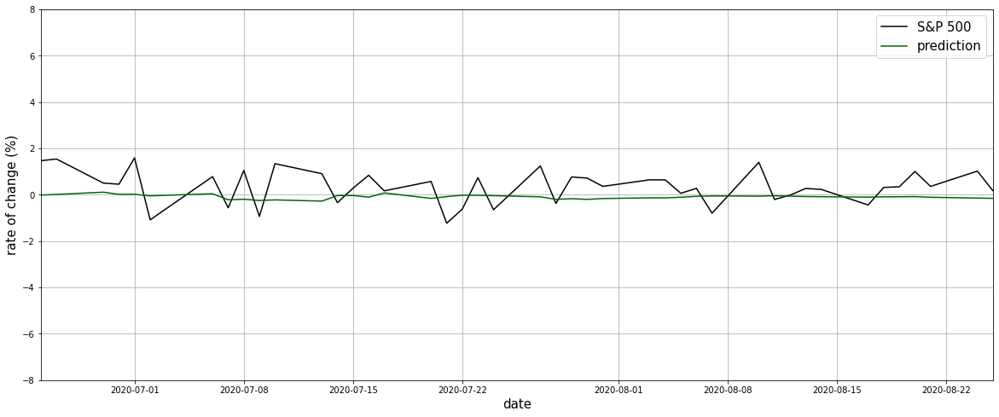

...

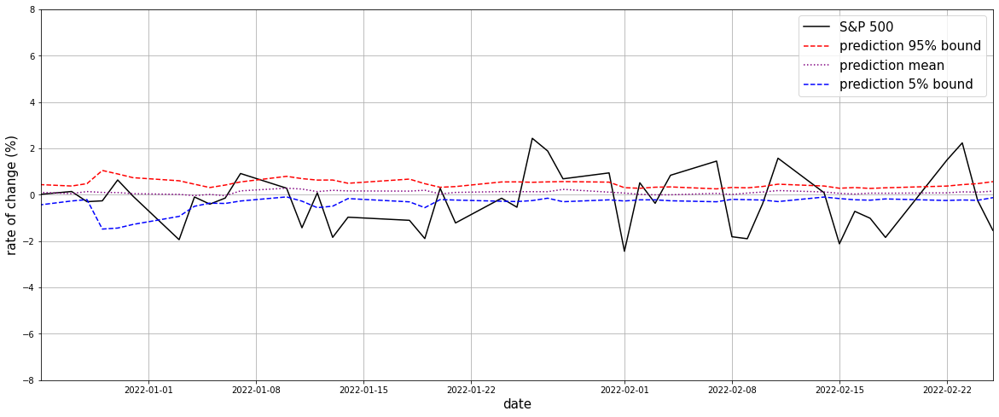

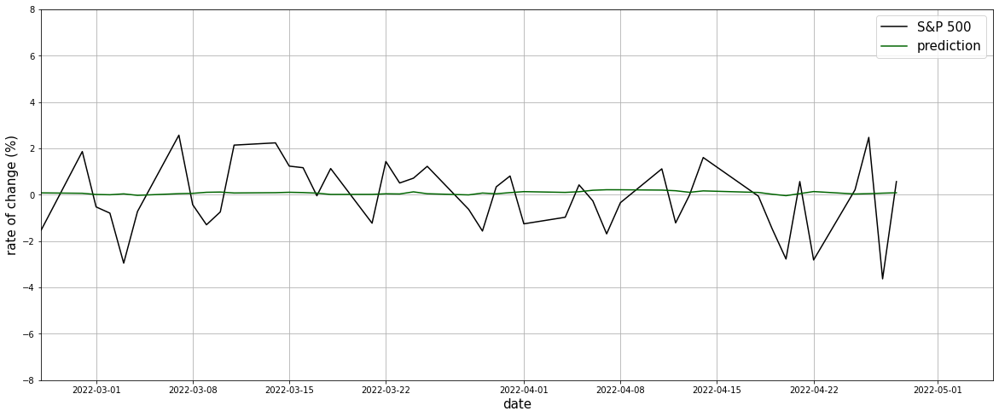

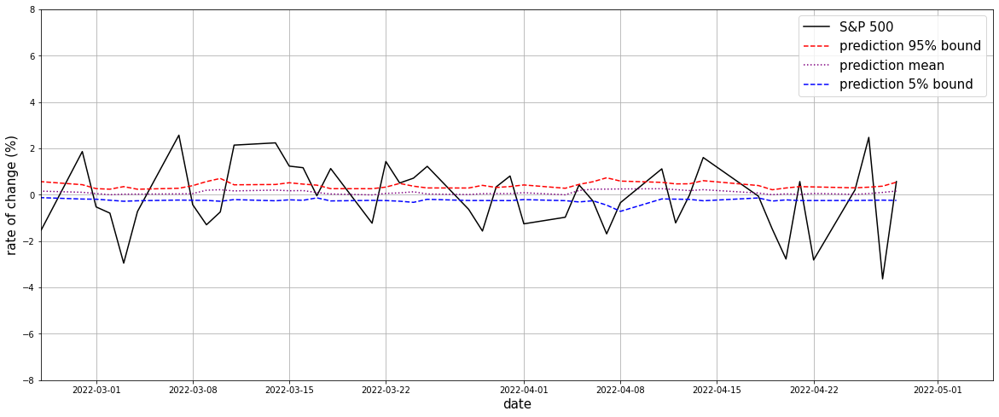

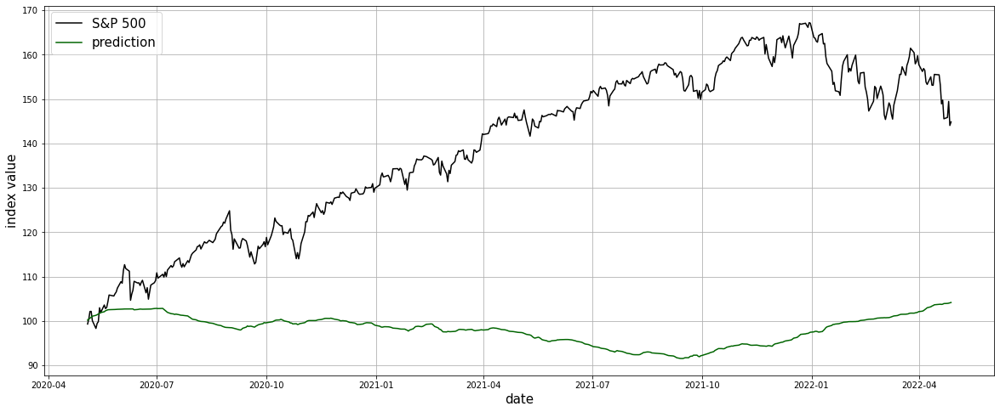

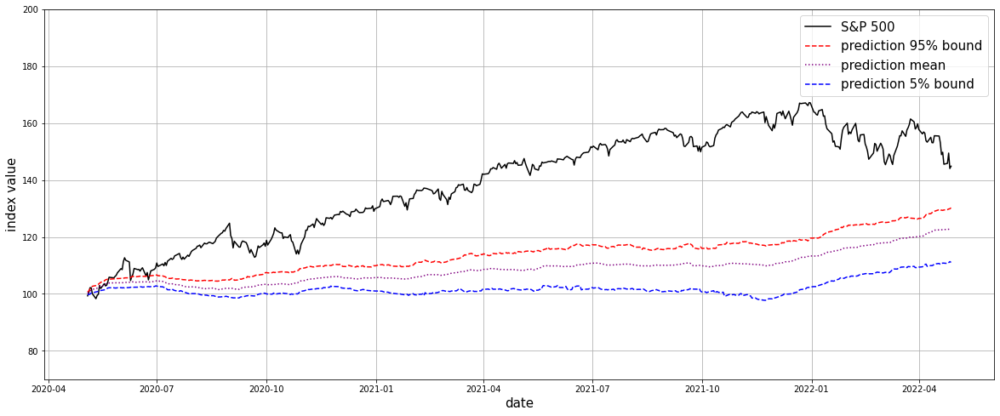

 0.35 min.


optimizer = Adam, epoch = 50

Epoch 1/50
32/32 [==============================] - 4s 29ms/step - loss: 2.5362 - mean_absolute_error: 1.1415 - val_loss: 444.6719 - val_mean_absolute_error: 17.3138
Epoch 2/50
32/32 [==============================] - 1s 17ms/step - loss: 1.7776 - mean_absolute_error: 0.9183 - val_loss: 32.4628 - val_mean_absolute_error: 4.5181
Epoch 3/50
32/32 [==============================] - 1s 17ms/step - loss: 1.5233 - mean_absolute_error: 0.8411 - val_loss: 9.0284 - val_mean_absolute_error: 2.4253
Epoch 4/50
32/32 [==============================] - 1s 17ms/step - loss: 1.4232 - mean_absolute_error: 0.7795 - val_loss: 2.0225 - val_mean_absolute_error: 1.0386
Epoch 5/50
32/32 [==============================] - 1s 17ms/step - loss: 1.2722 - mean_absolute_error: 0.7564 - val_loss: 1.5860 - val_mean_absolute_error: 0.9998
Epoch 6/50
32/32 [==============================] - 1s 17ms/step - loss: 1.2036 - mean_absolute_error: 0.7386 - val_loss: 1.2592 - val_mea

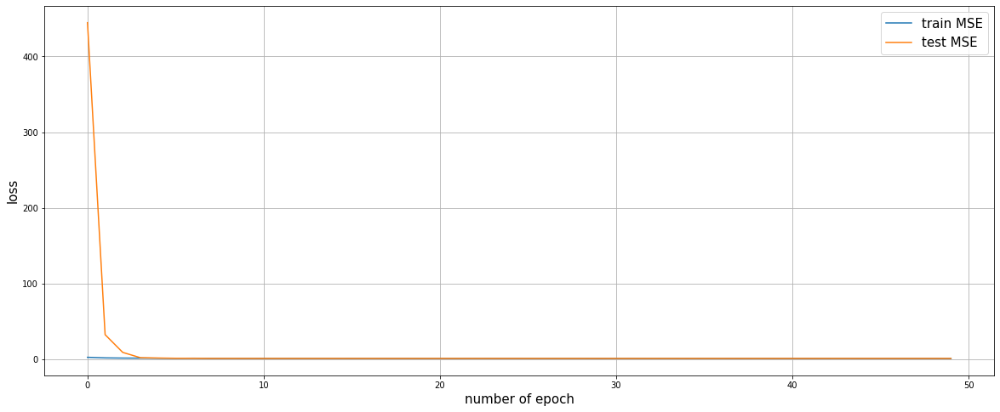

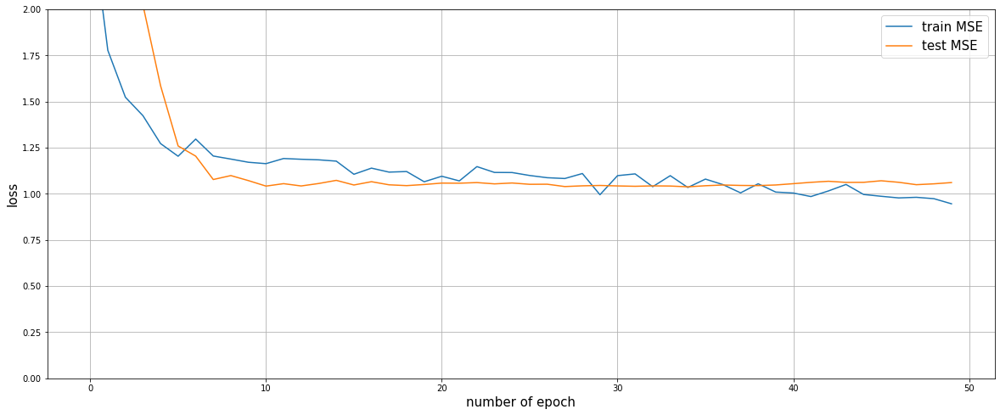

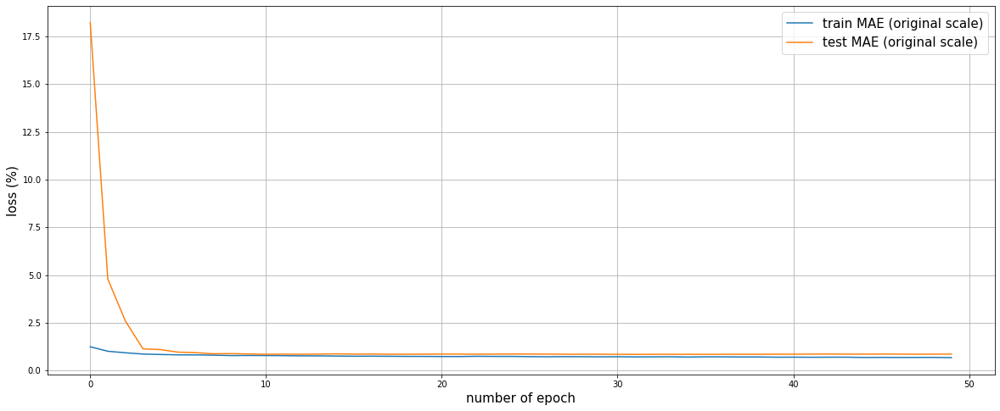

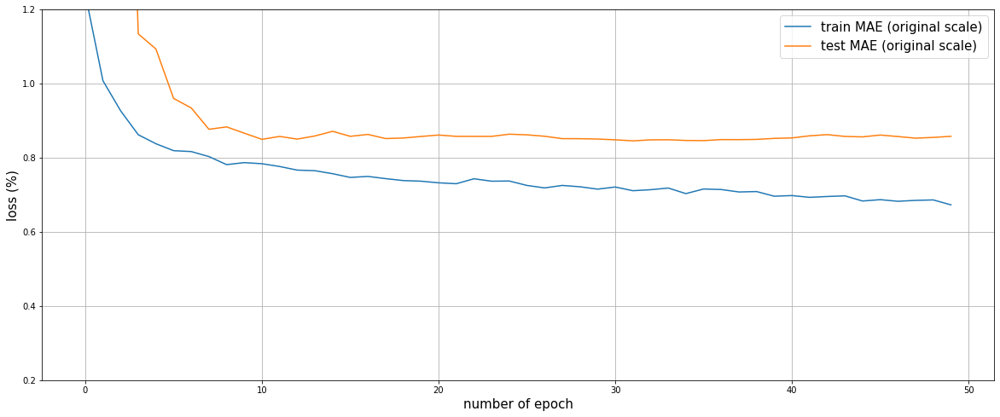

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.814%
 0.55 min.


optimizer = Adam, epoch = 50



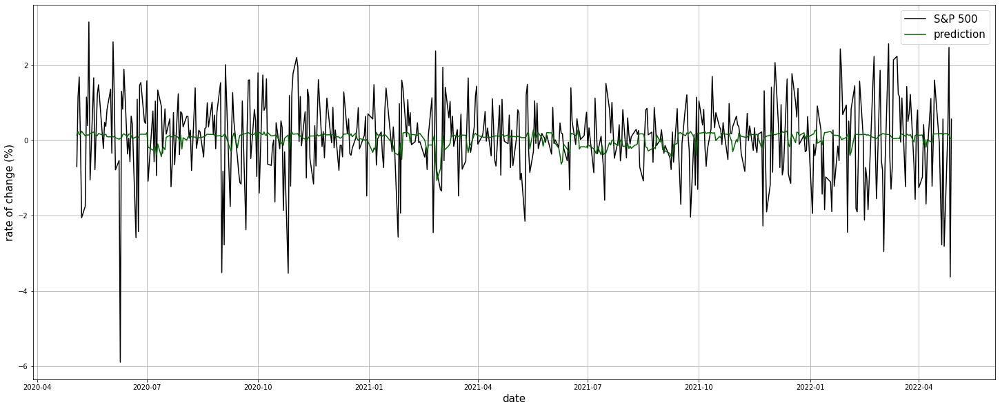

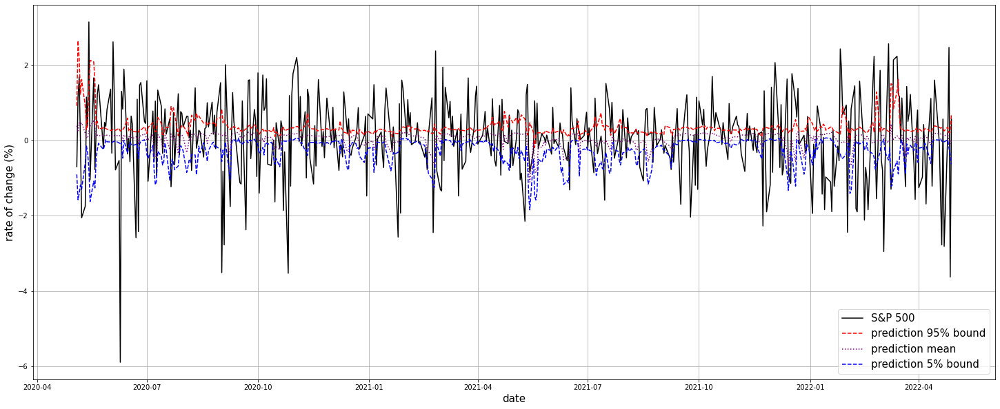

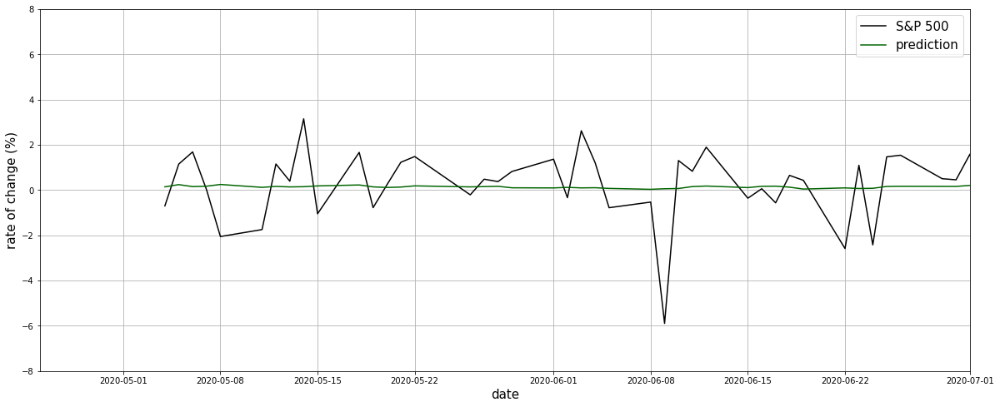

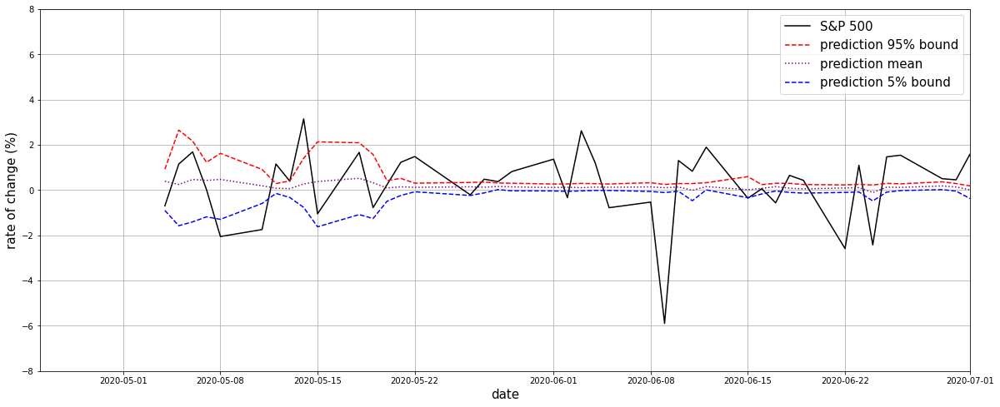

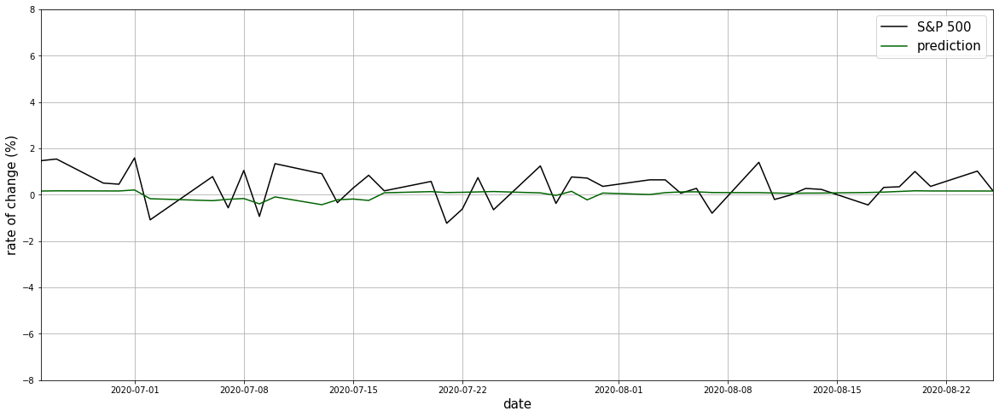

...

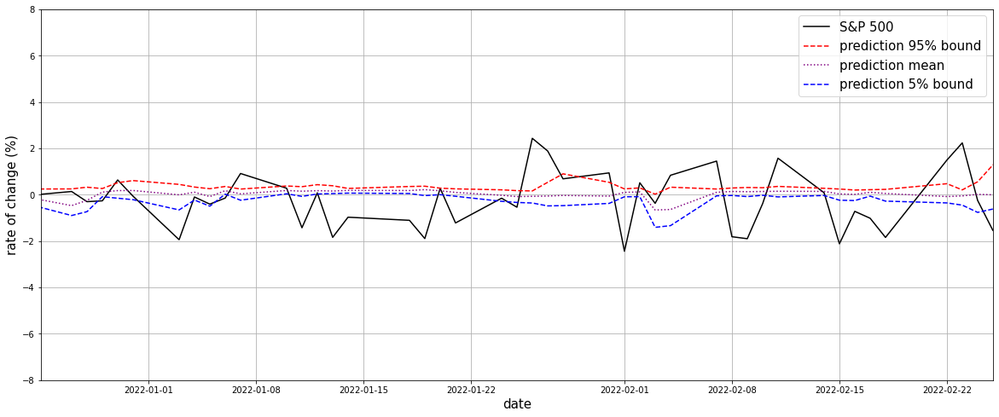

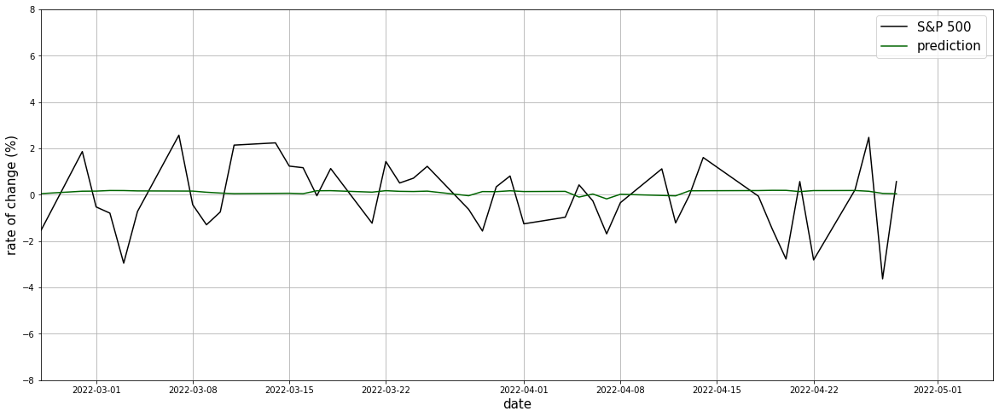

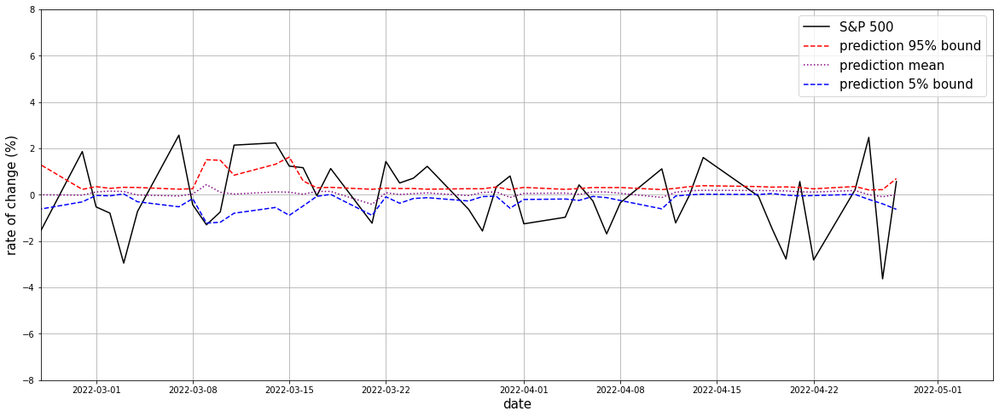

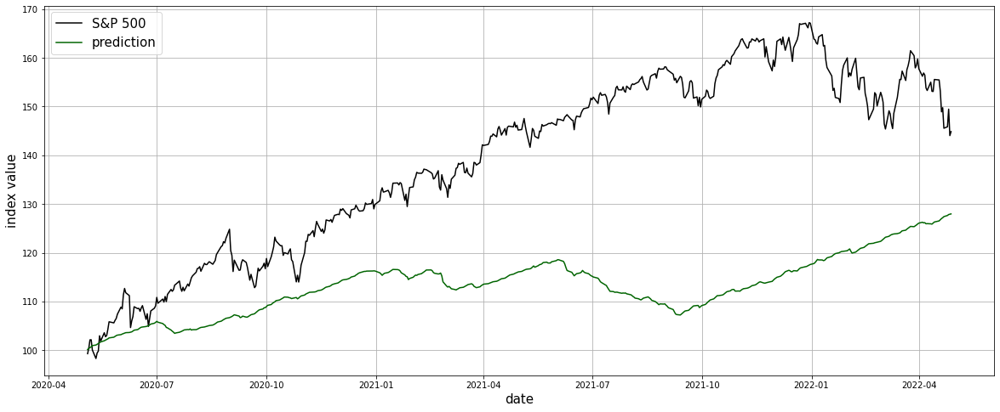

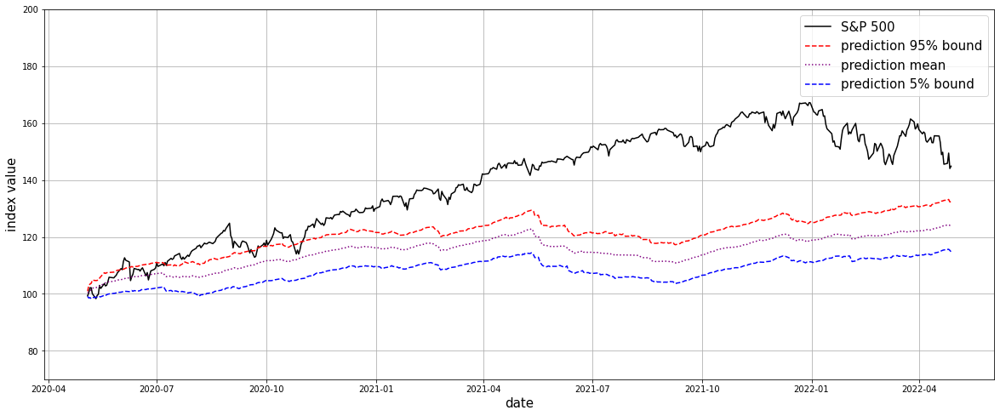

 0.43 min.


optimizer = Adam, epoch = 75

Epoch 1/75
32/32 [==============================] - 4s 29ms/step - loss: 2.6239 - mean_absolute_error: 1.1980 - val_loss: 619.1486 - val_mean_absolute_error: 21.9840
Epoch 2/75
32/32 [==============================] - 1s 17ms/step - loss: 1.8859 - mean_absolute_error: 0.9593 - val_loss: 83.6646 - val_mean_absolute_error: 7.5090
Epoch 3/75
32/32 [==============================] - 1s 17ms/step - loss: 1.5229 - mean_absolute_error: 0.8556 - val_loss: 18.3325 - val_mean_absolute_error: 3.5318
Epoch 4/75
32/32 [==============================] - 1s 18ms/step - loss: 1.4357 - mean_absolute_error: 0.8166 - val_loss: 7.7497 - val_mean_absolute_error: 2.3217
Epoch 5/75
32/32 [==============================] - 1s 17ms/step - loss: 1.3348 - mean_absolute_error: 0.7811 - val_loss: 5.7030 - val_mean_absolute_error: 1.9519
Epoch 6/75
32/32 [==============================] - 1s 17ms/step - loss: 1.4230 - mean_absolute_error: 0.7954 - val_loss: 3.8461 - val_me

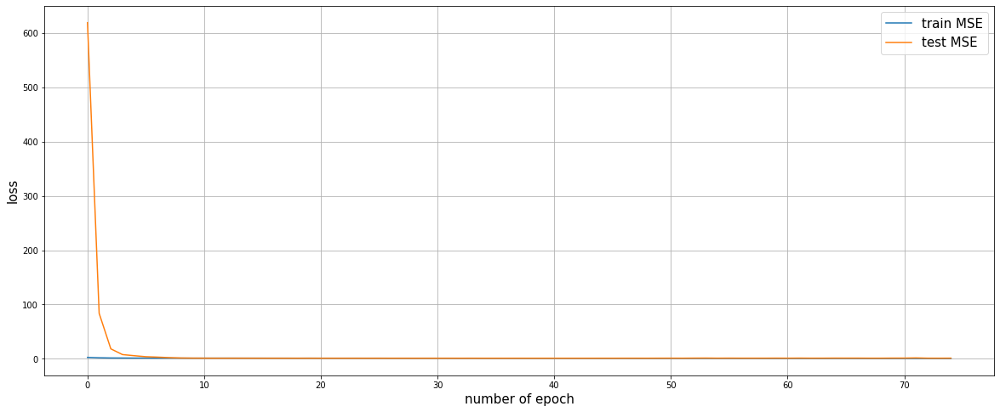

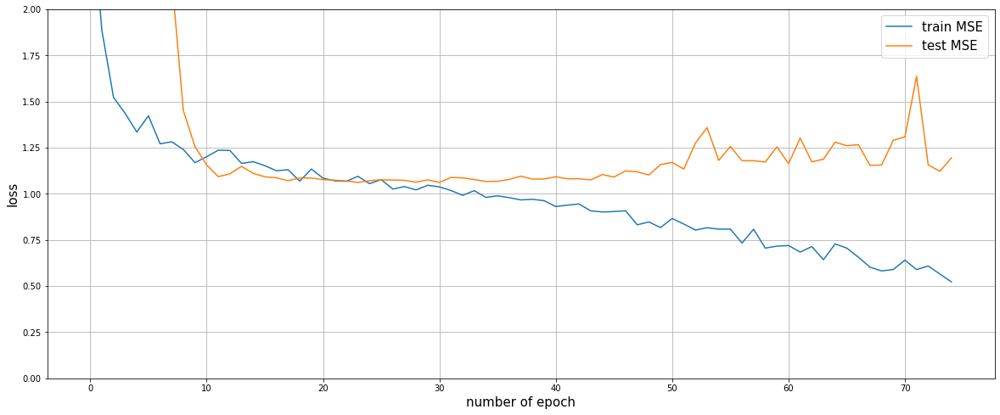

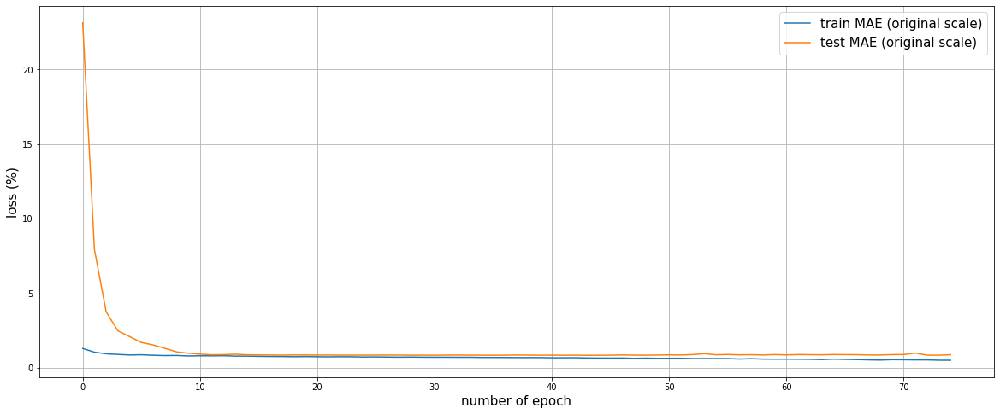

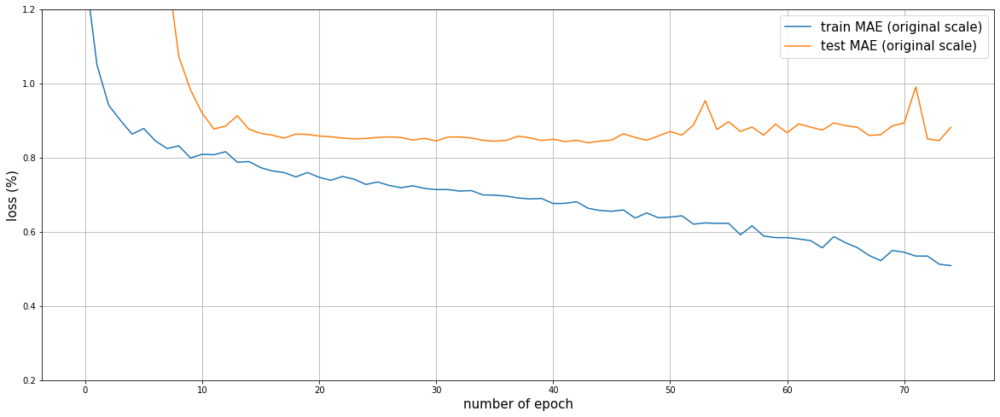

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.838%
 0.78 min.


optimizer = Adam, epoch = 75



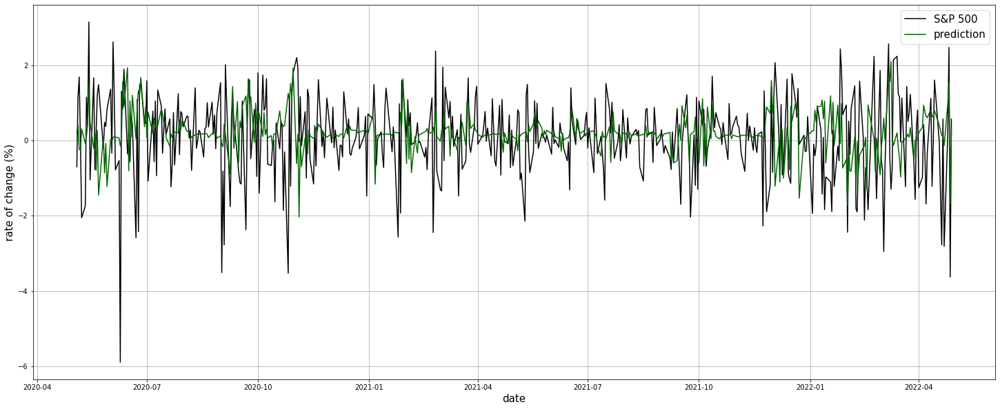

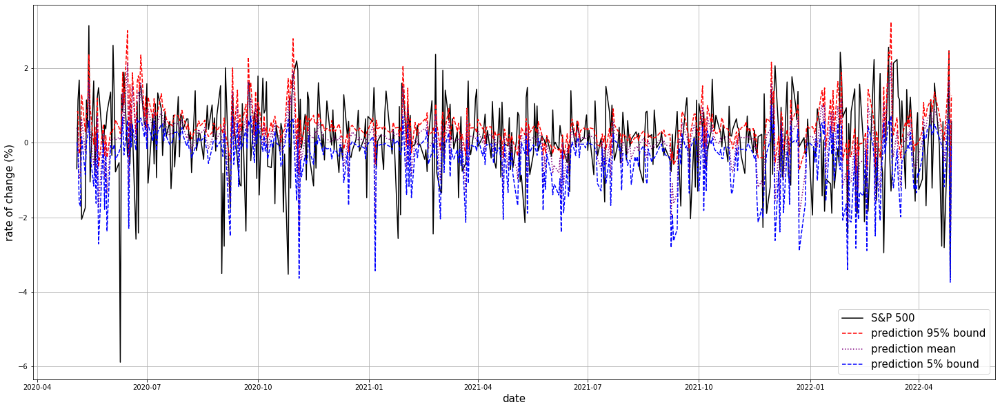

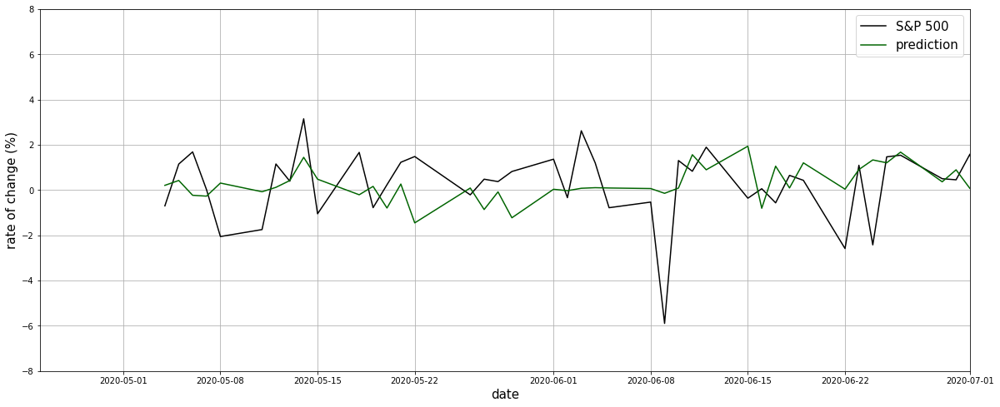

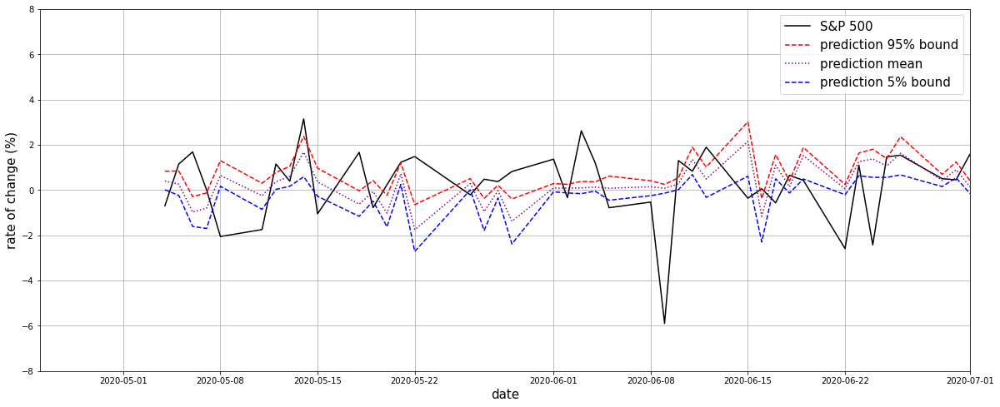

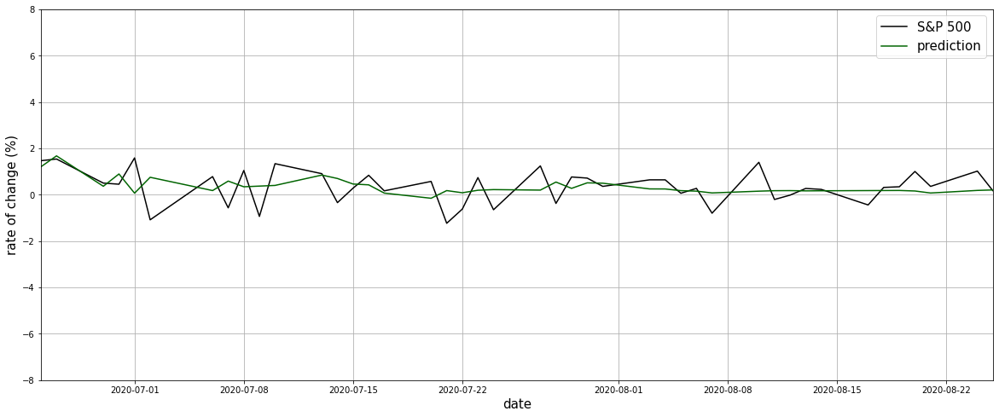

...

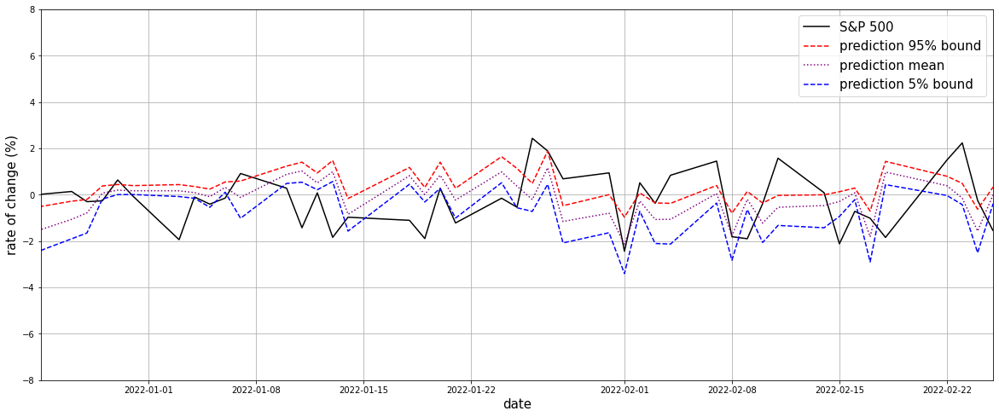

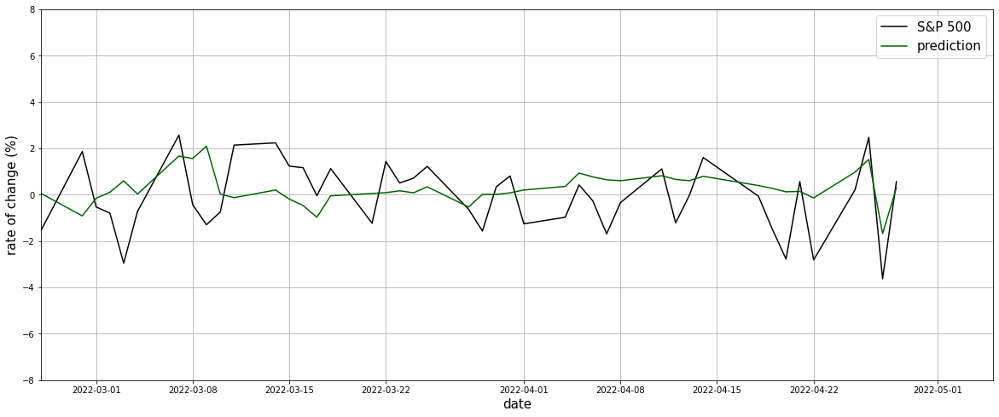

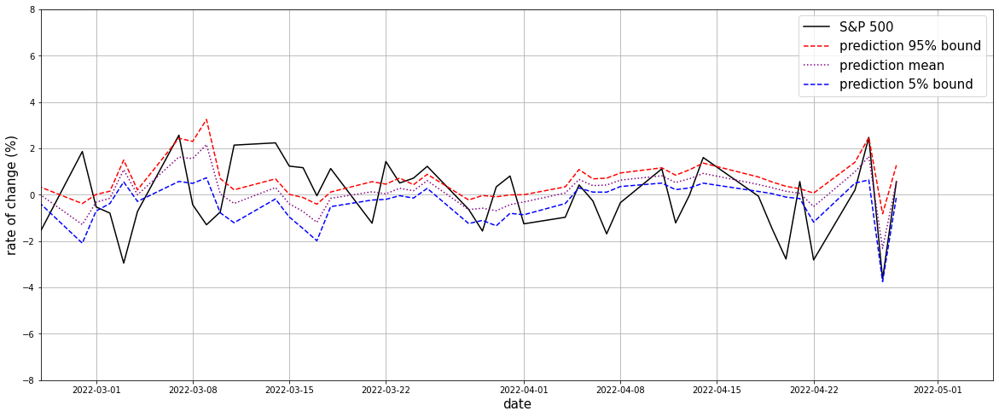

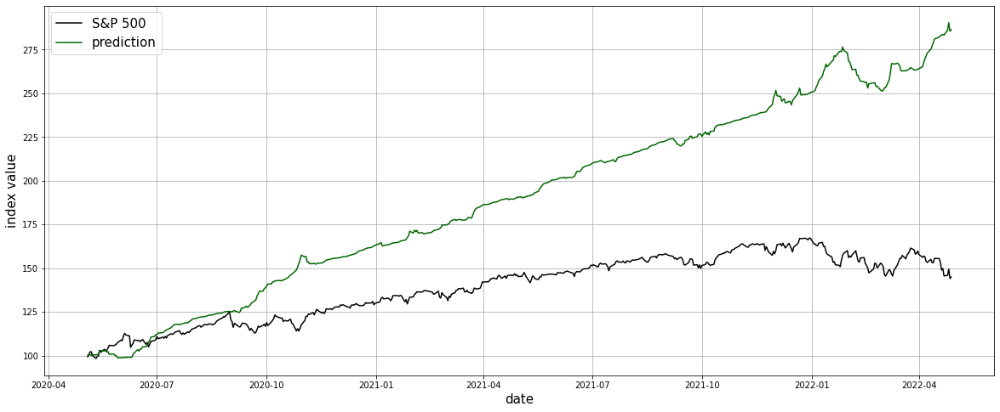

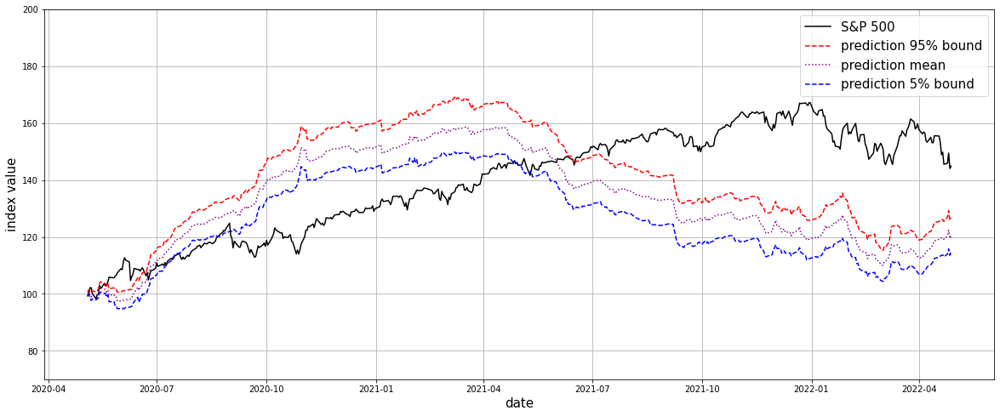

 0.35 min.


optimizer = Adam, epoch = 100

Epoch 1/100
32/32 [==============================] - 5s 30ms/step - loss: 2.1518 - mean_absolute_error: 1.0676 - val_loss: 1071.5548 - val_mean_absolute_error: 29.5078
Epoch 2/100
32/32 [==============================] - 1s 17ms/step - loss: 1.4684 - mean_absolute_error: 0.8382 - val_loss: 144.3530 - val_mean_absolute_error: 8.2907
Epoch 3/100
32/32 [==============================] - 1s 17ms/step - loss: 1.2374 - mean_absolute_error: 0.7564 - val_loss: 2.4035 - val_mean_absolute_error: 1.1553
Epoch 4/100
32/32 [==============================] - 1s 17ms/step - loss: 1.3317 - mean_absolute_error: 0.7659 - val_loss: 1.4153 - val_mean_absolute_error: 0.9415
Epoch 5/100
32/32 [==============================] - 1s 18ms/step - loss: 1.2415 - mean_absolute_error: 0.7298 - val_loss: 1.4506 - val_mean_absolute_error: 0.9854
Epoch 6/100
32/32 [==============================] - 1s 17ms/step - loss: 1.1858 - mean_absolute_error: 0.7167 - val_loss: 1.2082 

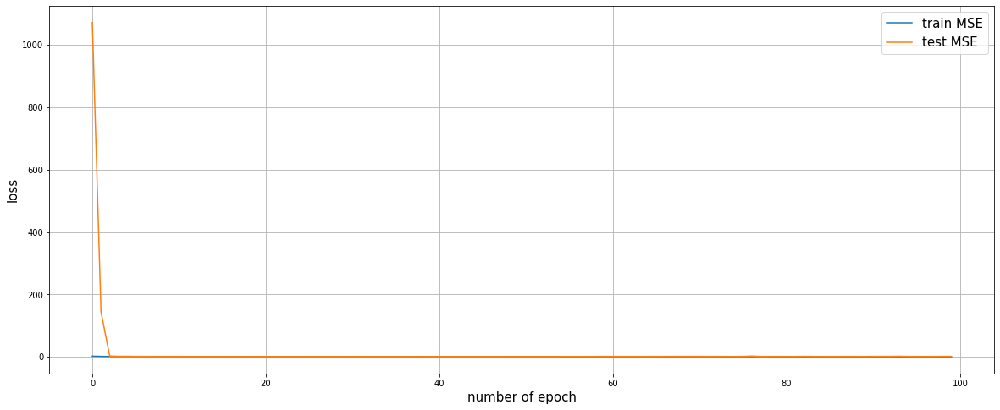

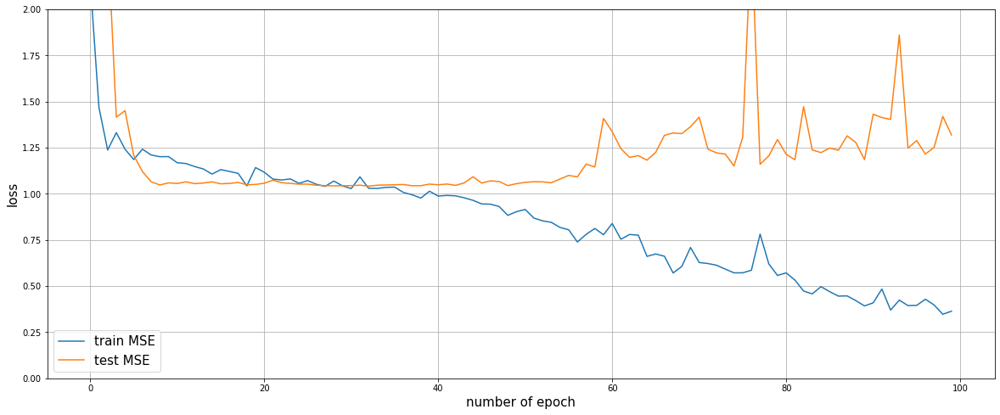

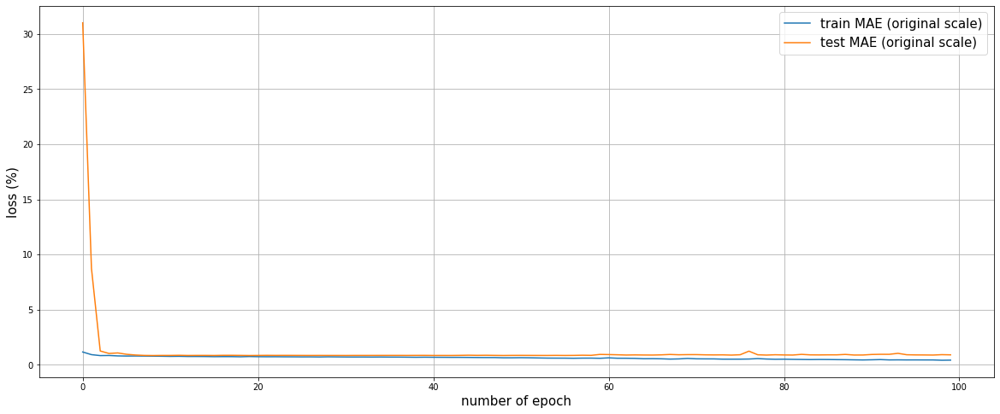

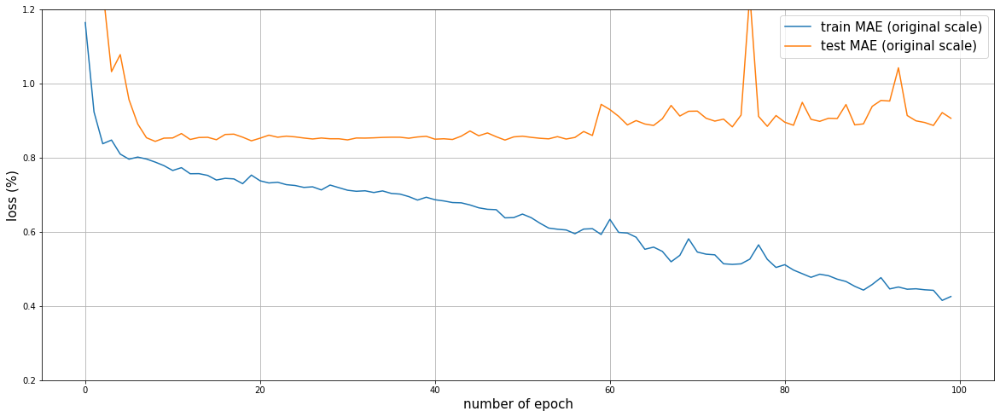

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.863%
 1.02 min.


optimizer = Adam, epoch = 100



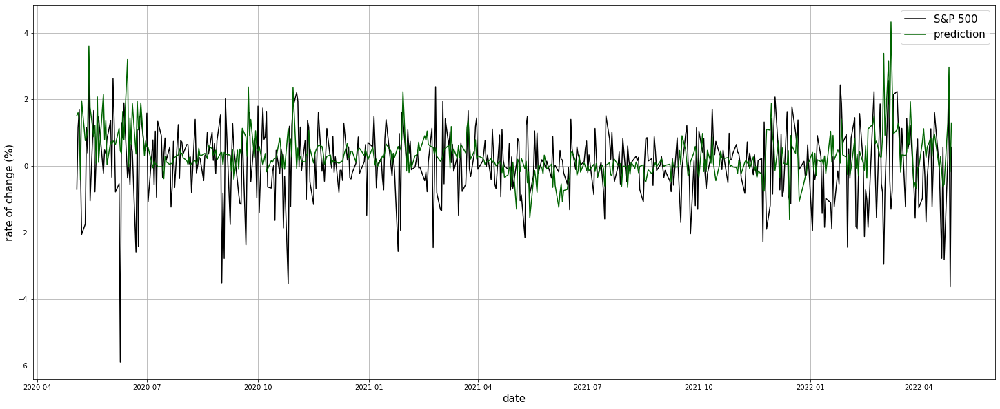

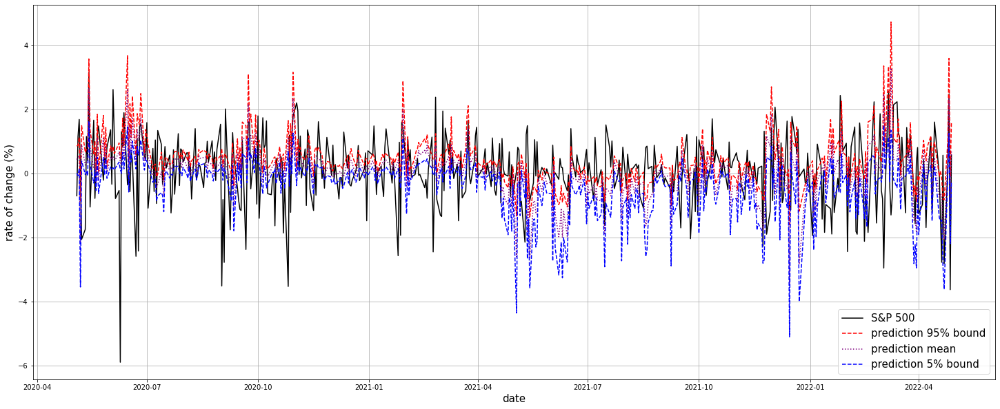

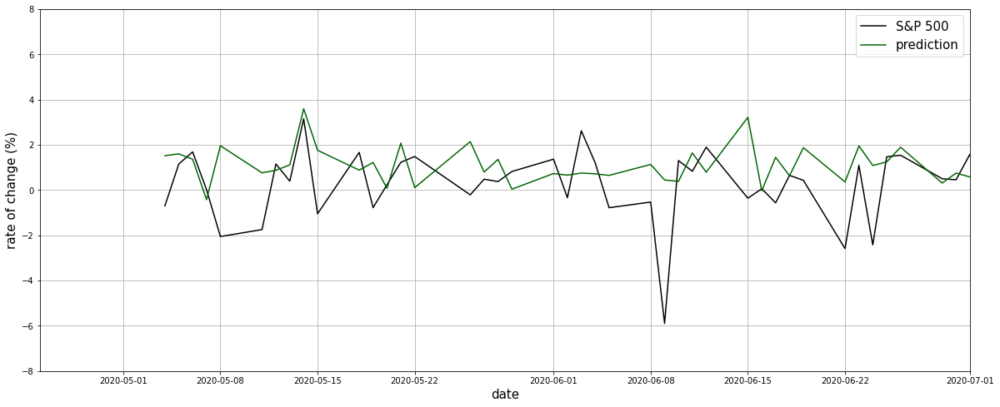

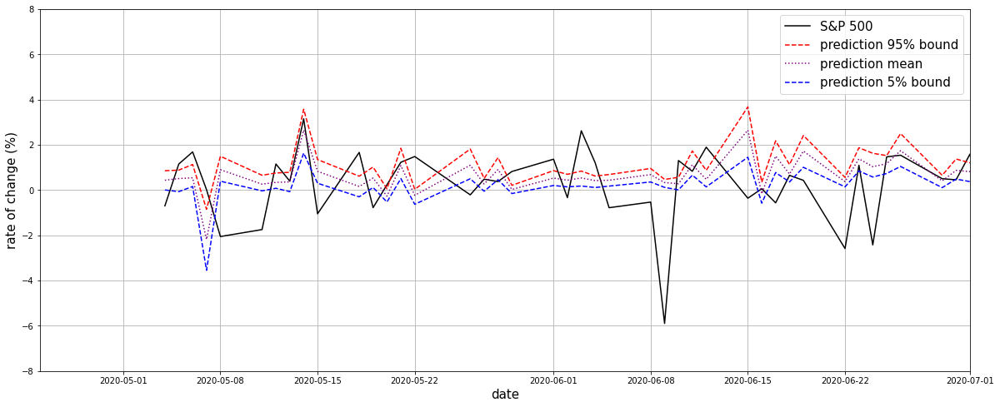

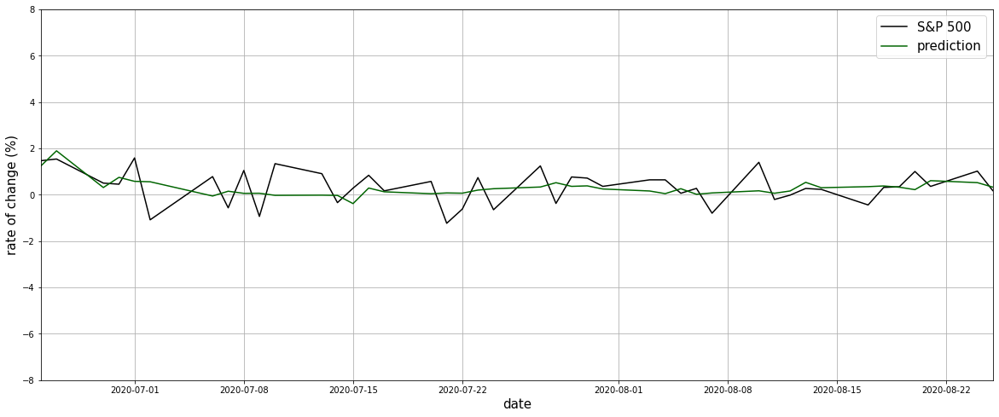

...

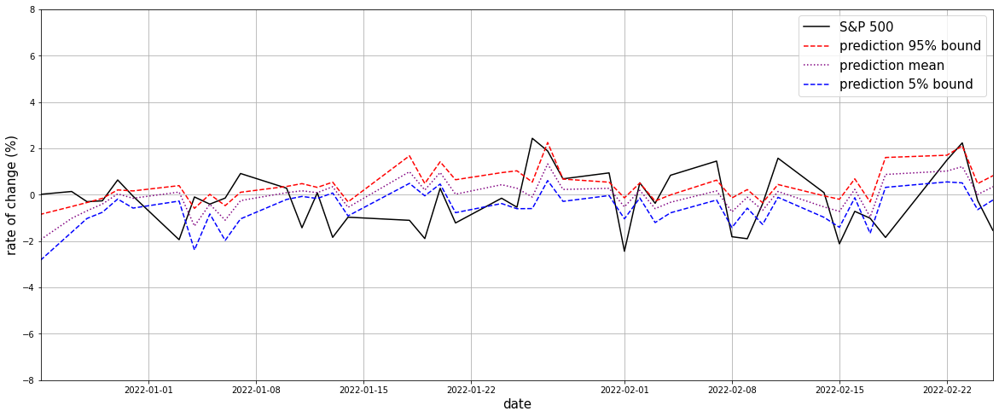

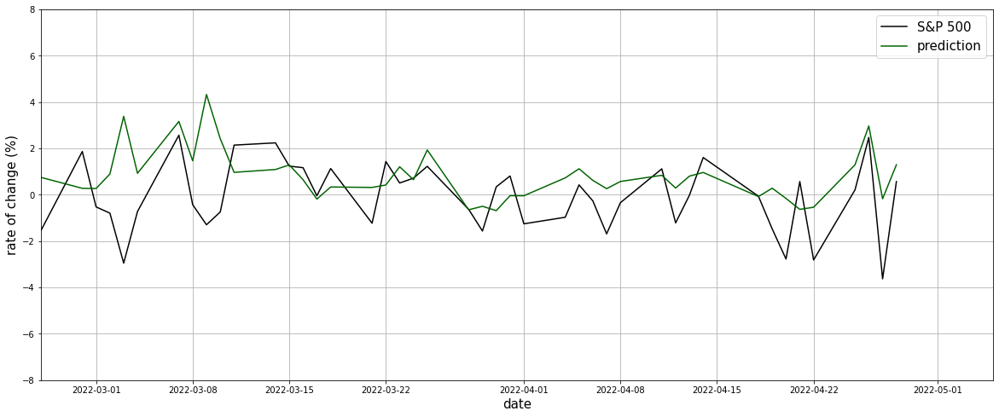

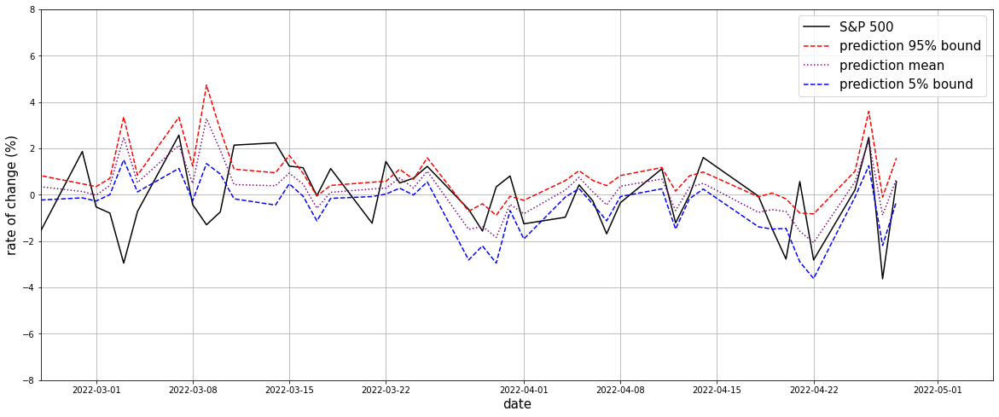

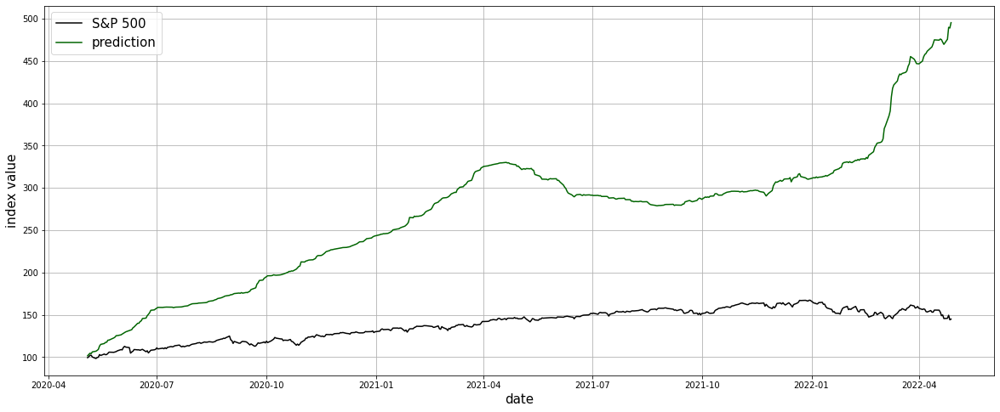

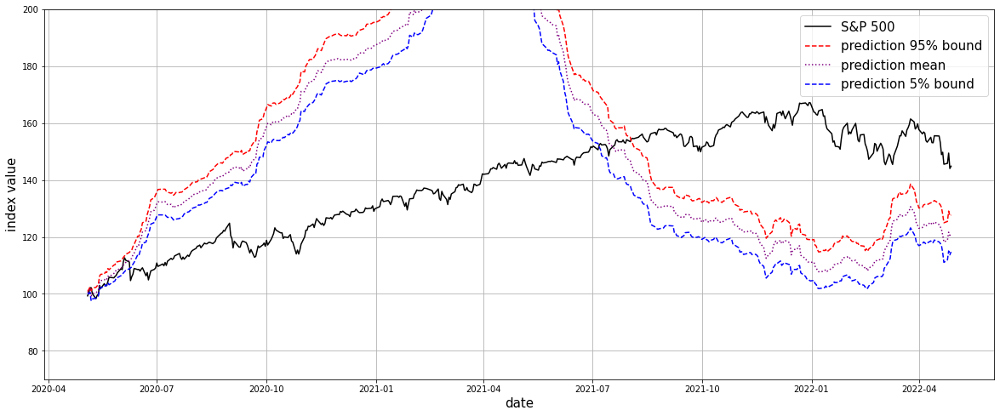

 0.35 min.


optimizer = Adam, epoch = 200

Epoch 1/200
32/32 [==============================] - 4s 29ms/step - loss: 2.9708 - mean_absolute_error: 1.2904 - val_loss: 2066.3064 - val_mean_absolute_error: 38.9332
Epoch 2/200
32/32 [==============================] - 1s 17ms/step - loss: 1.9365 - mean_absolute_error: 0.9920 - val_loss: 107.7232 - val_mean_absolute_error: 8.0810
Epoch 3/200
32/32 [==============================] - 1s 17ms/step - loss: 1.5492 - mean_absolute_error: 0.8856 - val_loss: 85.8770 - val_mean_absolute_error: 7.1831
Epoch 4/200
32/32 [==============================] - 1s 17ms/step - loss: 1.5203 - mean_absolute_error: 0.8637 - val_loss: 51.1391 - val_mean_absolute_error: 5.1334
Epoch 5/200
32/32 [==============================] - 1s 18ms/step - loss: 1.3597 - mean_absolute_error: 0.8150 - val_loss: 6.0462 - val_mean_absolute_error: 1.8916
Epoch 6/200
32/32 [==============================] - 1s 17ms/step - loss: 1.3299 - mean_absolute_error: 0.8012 - val_loss: 2.075

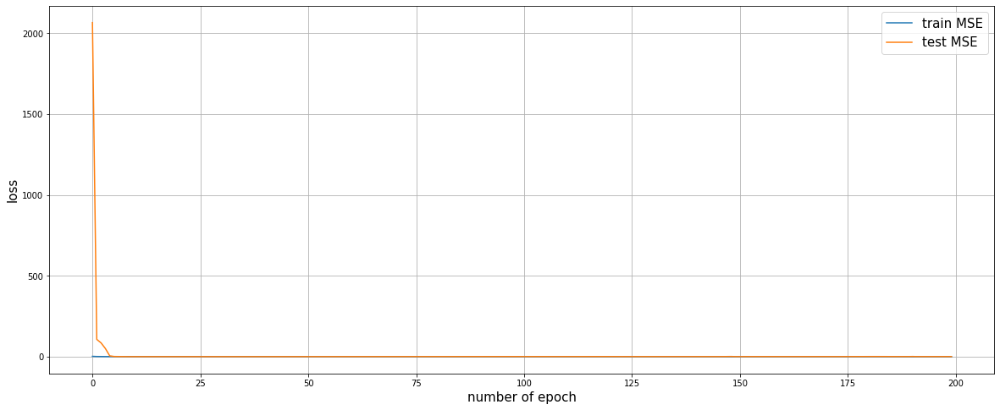

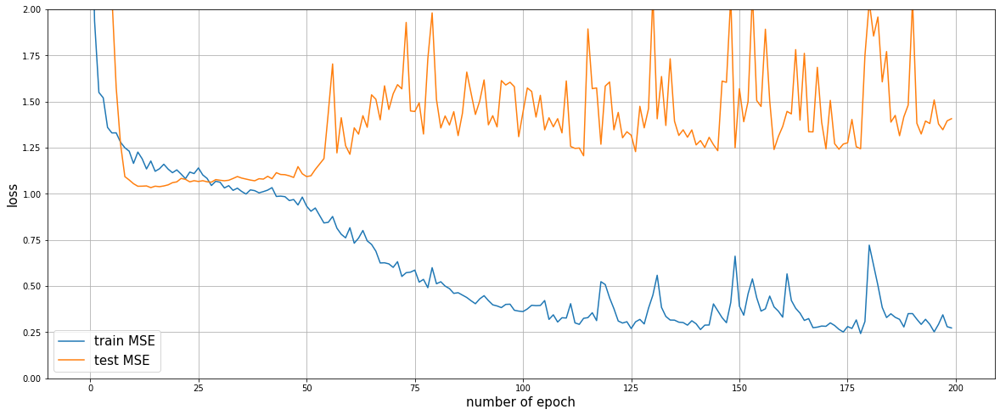

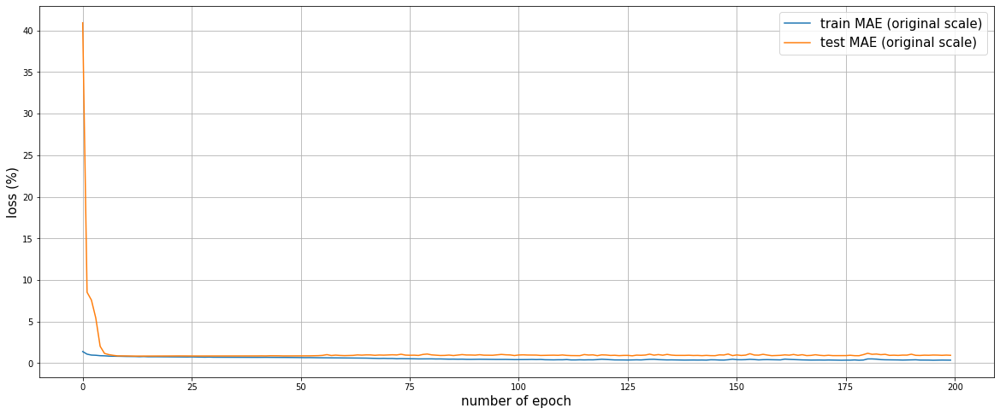

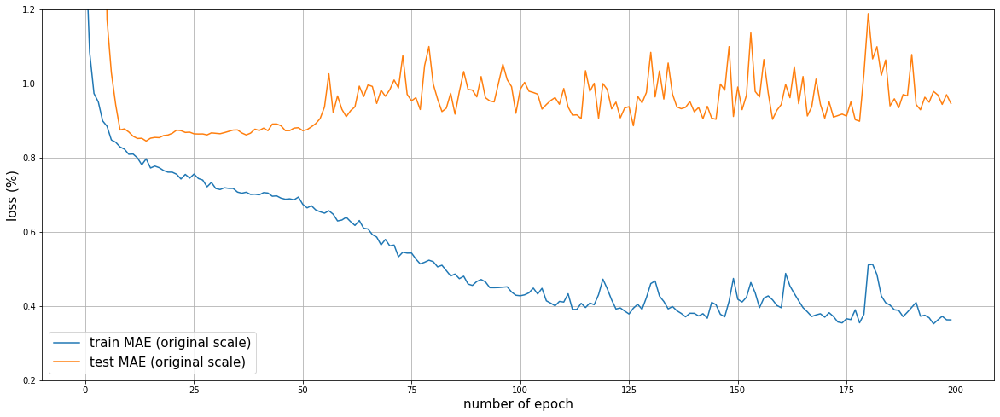

Volatility of rate of change for S&P 500 test data:  1.072%
Mean Absolute Error for test data (original scale):  0.902%
 1.93 min.


optimizer = Adam, epoch = 200



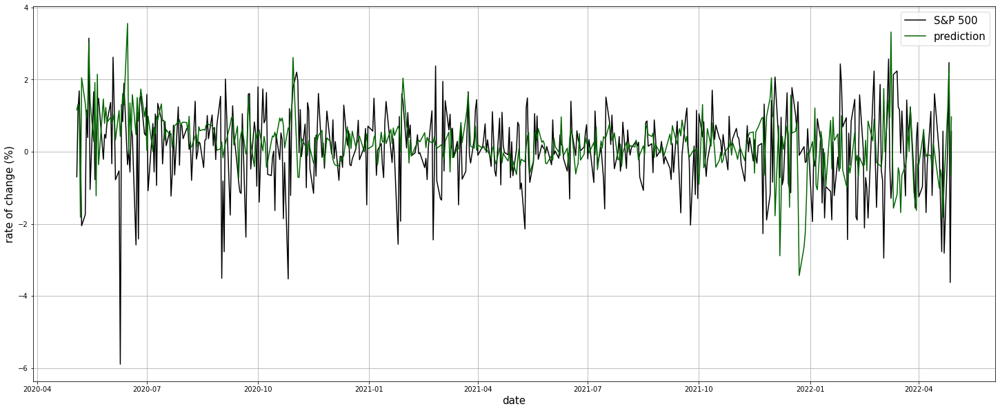

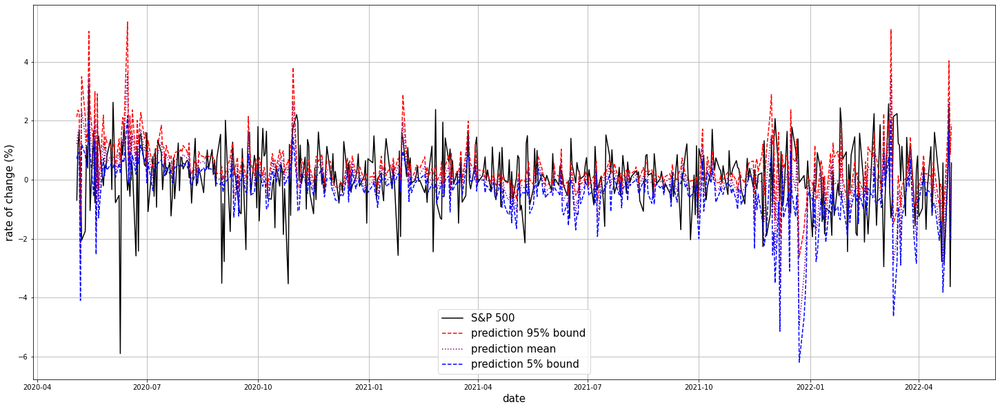

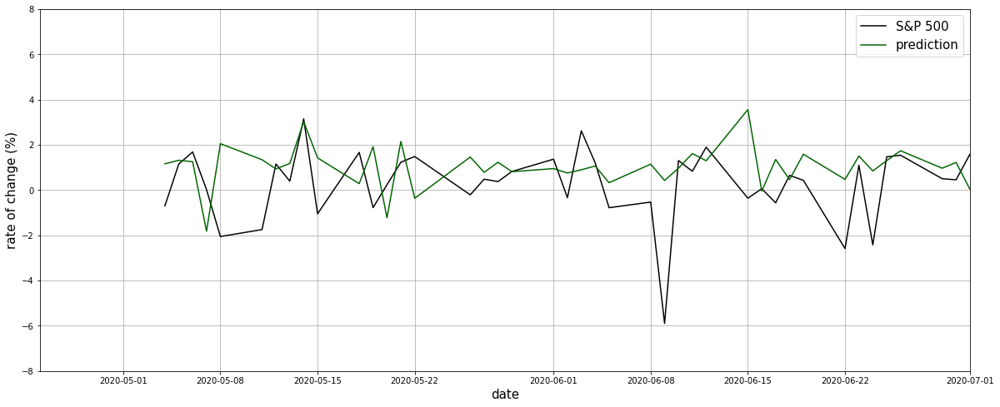

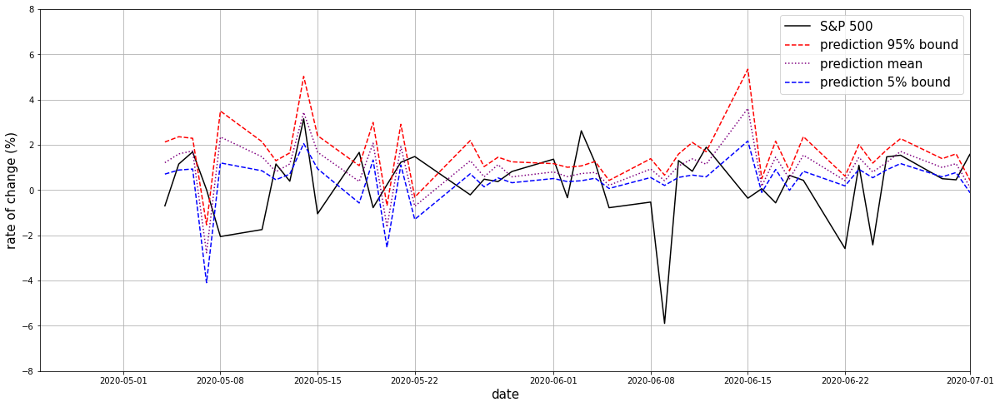

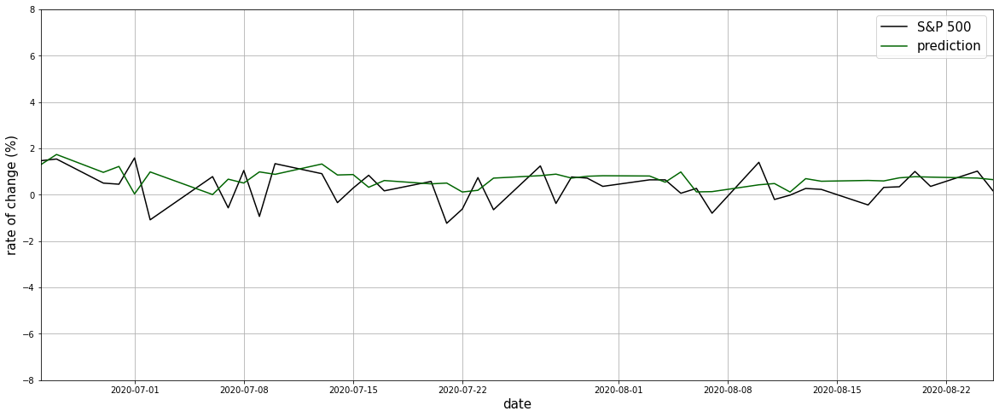

...

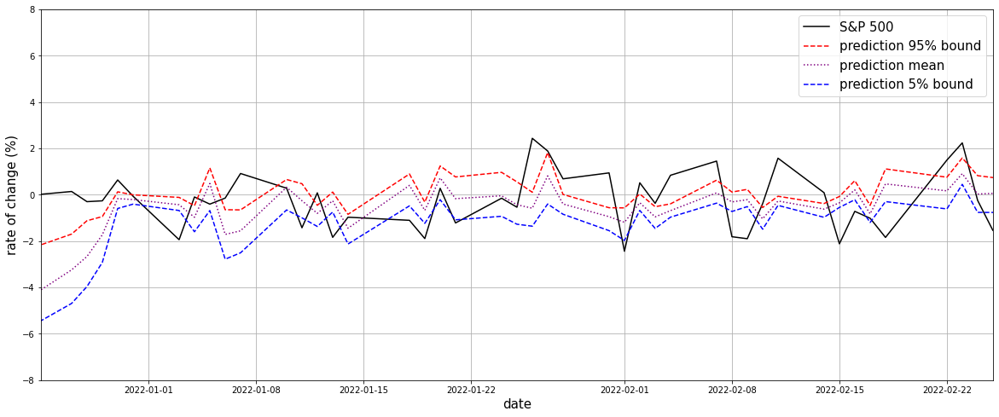

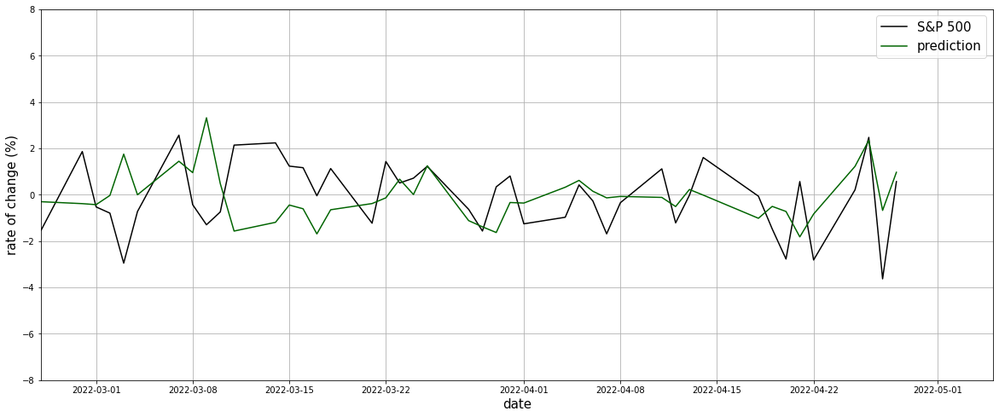

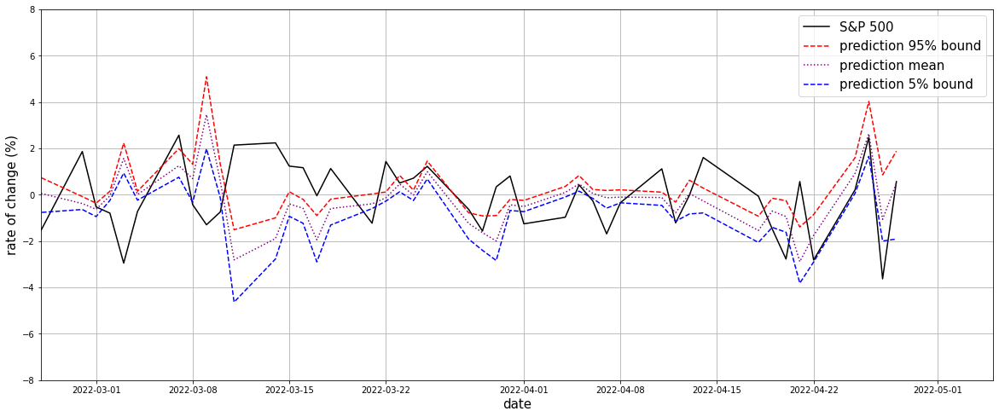

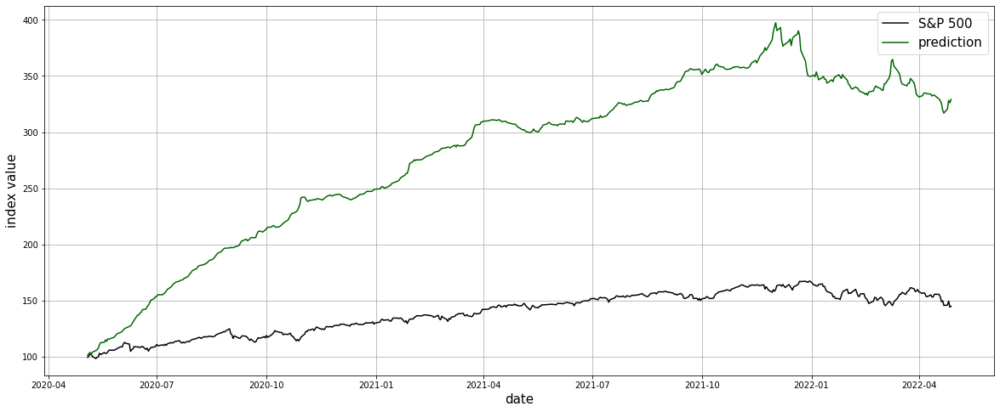

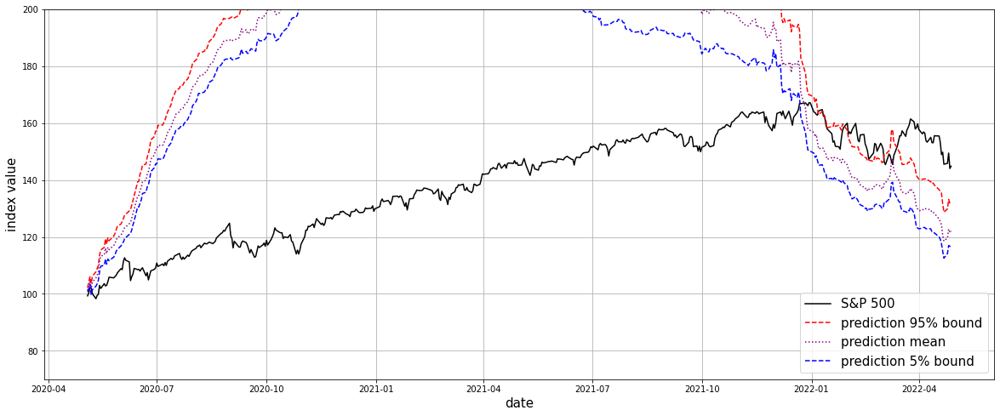

 0.35 min.


In [6]:
seed_everything(0)

mae_p = []
band_p = []
params = [["SGD", 30], ["Adagrad", 30], ["RMSprop", 30], ["Nadam", 30], ["Adadelta", 30], ["Adam", 10], ["Adam", 20], ["Adam", 30], ["Adam", 50], ["Adam", 75], ["Adam", 100], ["Adam", 200]]

for para in params:
    print("\n\noptimizer = " + para[0] + ", epoch = " + str(para[1]) + "\n")
    start = time.time()

    dropout_p = 0.1
    lr_alpha = 0.05
    n_epoch = para[1]
    n_train = int(np.round(df.shape[0] * 0.8))

    df_train = df.iloc[:n_train, :]
    df_test = df.iloc[n_train:, :]

    sc = StandardScaler()
    df_train_tf = sc.fit_transform(df_train.values)
    df_test_tf = sc.transform(df_test.values)

    NN = Sequential([Dropout(dropout_p),
                    Dense(8192, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),

                    Dropout(dropout_p),
                    Dense(4096, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),

                    Dropout(dropout_p),
                    Dense(2048, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),

                    Dropout(dropout_p),
                    Dense(1024, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),

                    Dropout(dropout_p),
                    Dense(512, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),

                    Dropout(dropout_p),
                    Dense(256, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),

                    Dropout(dropout_p),
                    Dense(128, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),

                    Dropout(dropout_p),
                    Dense(64, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),

                    Dropout(dropout_p),
                    Dense(32, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),

                    Dropout(dropout_p),
                    Dense(16, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),

                    Dropout(dropout_p),
                    Dense(8, kernel_initializer = "HeUniform"),
                    LeakyReLU(alpha=lr_alpha),
                    BatchNormalization(),
                    Dropout(dropout_p),
                    Dense(1)])
    
    if para[0] == "SGD":
        NN.compile(loss = "mean_squared_error", optimizer = SGD(learning_rate = 0.001), metrics = [tf.keras.metrics.MeanAbsoluteError()])
    else:
        NN.compile(loss = "mean_squared_error", optimizer = para[0], metrics = [tf.keras.metrics.MeanAbsoluteError()])

    hist = NN.fit(x = df_train_tf[:, 1:], y = df_train_tf[:, 0], batch_size = 64, epochs = n_epoch, validation_data = (df_test_tf[:, 1:], df_test_tf[:, 0]))

    train_for_inv = np.concatenate((np.transpose([hist.history["mean_absolute_error"]]), df_train_tf[:n_epoch, 1:]), axis = 1)
    test_for_inv = np.concatenate((np.transpose([hist.history["val_mean_absolute_error"]]), df_train_tf[:n_epoch, 1:]), axis = 1)
    train_mae_org_sc = sc.inverse_transform(train_for_inv)[:, 0]
    test_mae_org_sc = sc.inverse_transform(test_for_inv)[:, 0]




    print("\n\noptimizer = " + para[0] + ", epoch = " + str(para[1]) + "\n")
    plt.figure(figsize=(20,8))
    plt.plot(range(n_epoch), hist.history["loss"], label = "train MSE");
    plt.plot(range(n_epoch), hist.history["val_loss"], label = "test MSE");
    plt.xlabel("number of epoch", size=15)
    plt.ylabel("loss", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()

    plt.figure(figsize=(20,8))
    plt.ylim([0, 2]);
    plt.plot(range(n_epoch), hist.history["loss"], label = "train MSE");
    plt.plot(range(n_epoch), hist.history["val_loss"], label = "test MSE");
    plt.xlabel("number of epoch", size=15)
    plt.ylabel("loss", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()

    plt.figure(figsize=(20,8))
    plt.plot(range(n_epoch), train_mae_org_sc * 100, label = "train MAE (original scale)");
    plt.plot(range(n_epoch), test_mae_org_sc * 100, label = "test MAE (original scale)");
    plt.xlabel("number of epoch", size=15)
    plt.ylabel("loss (%)", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()


    plt.figure(figsize=(20,8))
    plt.ylim([0.2, 1.2]);
    plt.plot(range(n_epoch), train_mae_org_sc * 100, label = "train MAE (original scale)");
    plt.plot(range(n_epoch), test_mae_org_sc * 100, label = "test MAE (original scale)");
    plt.xlabel("number of epoch", size=15)
    plt.ylabel("loss (%)", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()


    pred_for_inv = np.concatenate((NN.predict(df_test_tf[:, 1:]), df_test_tf[:, 1:]), axis = 1)
    pred = sc.inverse_transform(pred_for_inv)[:, 0]
    y_test = df_test.iloc[:, 0]
    
    mae_p.append(np.abs(y_test - pred).mean() * 100)
    print(f"Volatility of rate of change for S&P 500 test data: {np.std(y_test) * 100: 0.3f}%")
    print(f"Mean Absolute Error for test data (original scale): {np.abs(y_test - pred).mean() * 100: 0.3f}%")
    print(f"{(time.time() - start) / 60: 0.2f} min.")



    print("\n\noptimizer = " + para[0] + ", epoch = " + str(para[1]) + "\n")
    start = time.time()

    def predict_dist(X, model, num_samples):
        preds = [model(X, training=True) for _ in range(num_samples)]
        return np.hstack(preds)

    def predict_point(X, model, num_samples):
        pred_dist = predict_dist(X, model, num_samples)
        return pred_dist.mean(axis=1)


    pred_dist = predict_dist(df_test_tf[:, 1:], NN, 101)
    pred_mean = predict_point(df_test_tf[:, 1:], NN, 101)

    pred_dist = pd.DataFrame(pred_dist)
    pred_dist.index = df_test.index

    for i in range(pred_dist.shape[1]):
        pred_for_inv = np.concatenate((np.transpose([pred_dist.iloc[:, i]]), df_test_tf[:, 1:]), axis = 1)
        pred_dist.iloc[:, i] = sc.inverse_transform(pred_for_inv)[:, 0]

    pred_for_inv = np.concatenate((np.transpose([pred_mean]), df_test_tf[:, 1:]), axis = 1)
    pred_mean = sc.inverse_transform(pred_for_inv)[:, 0]





    plt.figure(figsize=(25,10))
    plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
    plt.plot(df_test.index, pred * 100, label = "prediction", color = "darkgreen");
    plt.xlabel("date", size=15)
    plt.ylabel("rate of change (%)", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()


    pred_05 = pred_dist.quantile(0.05, axis = 1)
    pred_50 = pred_dist.quantile(0.5, axis = 1)
    pred_95 = pred_dist.quantile(0.95, axis = 1)

    plt.figure(figsize=(25,10))
    plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
    plt.plot(df_test.index, pred_95 * 100, label = "prediction 95% bound", linestyle = "dashed", color = "red");
    plt.plot(df_test.index, pred_mean * 100, label = "prediction mean", linestyle = "dotted", color = "purple");
    plt.plot(df_test.index, pred_05 * 100, label = "prediction 5% bound", linestyle = "dashed", color = "blue");
    plt.xlabel("date", size=15)
    plt.ylabel("rate of change (%)", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()




    pl_l = -8
    pl_u = 8


    plt.figure(figsize=(20,8))
    plt.xlim([datetime.datetime(2020, 4, 25), datetime.datetime(2020, 7, 1)]);
    plt.ylim(pl_l, pl_u)

    plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
    plt.plot(df_test.index, pred * 100, label = "prediction", color = "darkgreen");
    plt.xlabel("date", size=15)
    plt.ylabel("rate of change (%)", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()


    plt.figure(figsize=(20,8))
    plt.xlim([datetime.datetime(2020, 4, 25), datetime.datetime(2020, 7, 1)]);
    plt.ylim(pl_l, pl_u)

    plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
    plt.plot(df_test.index, pred_95 * 100, label = "prediction 95% bound", linestyle = "dashed", color = "red");
    plt.plot(df_test.index, pred_mean * 100, label = "prediction mean", linestyle = "dotted", color = "purple");
    plt.plot(df_test.index, pred_05 * 100, label = "prediction 5% bound", linestyle = "dashed", color = "blue");
    plt.xlabel("date", size=15)
    plt.ylabel("rate of change (%)", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()

    for i in range(3):
        plt.figure(figsize=(20,8))
        plt.xlim([datetime.datetime(2020, i * 2 + 6, 25), datetime.datetime(2020, i * 2 + 8, 25)]);
        plt.ylim(pl_l, pl_u)

        plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
        plt.plot(df_test.index, pred * 100, label = "prediction", color = "darkgreen");
        plt.xlabel("date", size=15)
        plt.ylabel("rate of change (%)", size=15)
        plt.grid()
        plt.legend(prop={'size': 15})
        plt.show()


        plt.figure(figsize=(20,8))
        plt.xlim([datetime.datetime(2020, i * 2 + 6, 25), datetime.datetime(2020, i * 2 + 8, 25)]);
        plt.ylim(pl_l, pl_u)

        plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
        plt.plot(df_test.index, pred_95 * 100, label = "prediction 95% bound", linestyle = "dashed", color = "red");
        plt.plot(df_test.index, pred_mean * 100, label = "prediction mean", linestyle = "dotted", color = "purple");
        plt.plot(df_test.index, pred_05 * 100, label = "prediction 5% bound", linestyle = "dashed", color = "blue");
        plt.xlabel("date", size=15)
        plt.ylabel("rate of change (%)", size=15)
        plt.grid()
        plt.legend(prop={'size': 15})
        plt.show()

    for i in range(6):
        plt.figure(figsize=(20,8))
        if i == 0:
            plt.xlim([datetime.datetime(2020, 12, 25), datetime.datetime(2021, 2, 25)]);
        else:
            plt.xlim([datetime.datetime(2021, i * 2, 25), datetime.datetime(2021, i * 2 + 2, 25)]);
        
        plt.ylim(pl_l, pl_u)
        plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
        plt.plot(df_test.index, pred * 100, label = "prediction", color = "darkgreen");
        plt.xlabel("date", size=15)
        plt.ylabel("rate of change (%)", size=15)
        plt.grid()
        plt.legend(prop={'size': 15})
        plt.show()


        plt.figure(figsize=(20,8))
        if i == 0:
            plt.xlim([datetime.datetime(2020, 12, 25), datetime.datetime(2021, 2, 25)]);
        else:
            plt.xlim([datetime.datetime(2021, i * 2, 25), datetime.datetime(2021, i * 2 + 2, 25)]);

        plt.ylim(pl_l, pl_u)
        plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
        plt.plot(df_test.index, pred_95 * 100, label = "prediction 95% bound", linestyle = "dashed", color = "red");
        plt.plot(df_test.index, pred_mean * 100, label = "prediction mean", linestyle = "dotted", color = "purple");
        plt.plot(df_test.index, pred_05 * 100, label = "prediction 5% bound", linestyle = "dashed", color = "blue");
        plt.xlabel("date", size=15)
        plt.ylabel("rate of change (%)", size=15)
        plt.grid()
        plt.legend(prop={'size': 15})
        plt.show()


    plt.figure(figsize=(20,8))
    plt.xlim([datetime.datetime(2021, 12, 25), datetime.datetime(2022, 2, 25)]);
    plt.ylim(pl_l, pl_u)

    plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
    plt.plot(df_test.index, pred * 100, label = "prediction", color = "darkgreen");
    plt.xlabel("date", size=15)
    plt.ylabel("rate of change (%)", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()


    plt.figure(figsize=(20,8))
    plt.xlim([datetime.datetime(2021, 12, 25), datetime.datetime(2022, 2, 25)]);
    plt.ylim(pl_l, pl_u)

    plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
    plt.plot(df_test.index, pred_95 * 100, label = "prediction 95% bound", linestyle = "dashed", color = "red");
    plt.plot(df_test.index, pred_mean * 100, label = "prediction mean", linestyle = "dotted", color = "purple");
    plt.plot(df_test.index, pred_05 * 100, label = "prediction 5% bound", linestyle = "dashed", color = "blue");
    plt.xlabel("date", size=15)
    plt.ylabel("rate of change (%)", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()


    plt.figure(figsize=(20,8))
    plt.xlim([datetime.datetime(2022, 2, 25), datetime.datetime(2022, 5, 5)]);
    plt.ylim(pl_l, pl_u)

    plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
    plt.plot(df_test.index, pred * 100, label = "prediction", color = "darkgreen");
    plt.xlabel("date", size=15)
    plt.ylabel("rate of change (%)", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()


    plt.figure(figsize=(20,8))
    plt.xlim([datetime.datetime(2022, 2, 25), datetime.datetime(2022, 5, 5)]);
    plt.ylim(pl_l, pl_u)

    plt.plot(df_test.index, y_test * 100, label = "S&P 500", color = "black");
    plt.plot(df_test.index, pred_95 * 100, label = "prediction 95% bound", linestyle = "dashed", color = "red");
    plt.plot(df_test.index, pred_mean * 100, label = "prediction mean", linestyle = "dotted", color = "purple");
    plt.plot(df_test.index, pred_05 * 100, label = "prediction 5% bound", linestyle = "dashed", color = "blue");
    plt.xlabel("date", size=15)
    plt.ylabel("rate of change (%)", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()







    pred_price = [100 * (pred[0] + 1)]
    y_test_price = [100 * (y_test[0] + 1)]
    for i in range(1, len(pred)):
        pred_price.append(pred_price[i-1] * (pred[i] + 1))
        y_test_price.append(y_test_price[i-1] * (y_test[i] + 1))

    plt.figure(figsize=(20,8))
    plt.plot(df_test.index, y_test_price, label = "S&P 500", color = "black");
    plt.plot(df_test.index, pred_price, label = "prediction", color = "darkgreen");
    plt.xlabel("date", size=15)
    plt.ylabel("index value", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()


    pred_dist_price = (pred_dist + 1)
    pred_dist_price.iloc[0,:] = 100 * pred_dist_price.iloc[0,:]
    pred_dist_price = pred_dist_price.cumprod()

    pred_05_price = pred_dist_price.quantile(0.05, axis = 1)
    pred_50_price = pred_dist_price.quantile(0.5, axis = 1)
    pred_95_price = pred_dist_price.quantile(0.95, axis = 1)

    pred_mean_price = [100 * (pred_mean[0] + 1)]
    for i in range(1, len(pred_mean)):
        pred_mean_price.append(pred_mean_price[i-1] * (pred_mean[i] + 1))

    plt.figure(figsize=(20,8))
    plt.ylim([70, 200]);

    plt.plot(df_test.index, y_test_price, label = "S&P 500", color = "black");
    plt.plot(df_test.index, pred_95_price, label = "prediction 95% bound", linestyle = "dashed", color = "red");
    plt.plot(df_test.index, pred_mean_price, label = "prediction mean", linestyle = "dotted", color = "purple");
    plt.plot(df_test.index, pred_05_price, label = "prediction 5% bound", linestyle = "dashed", color = "blue");
    plt.xlabel("date", size=15)
    plt.ylabel("index value", size=15)
    plt.grid()
    plt.legend(prop={'size': 15})
    plt.show()

    band_p.append((pred_95 - pred_05).mean() * 100)

    print(f"{(time.time() - start) / 60: 0.2f} min.")


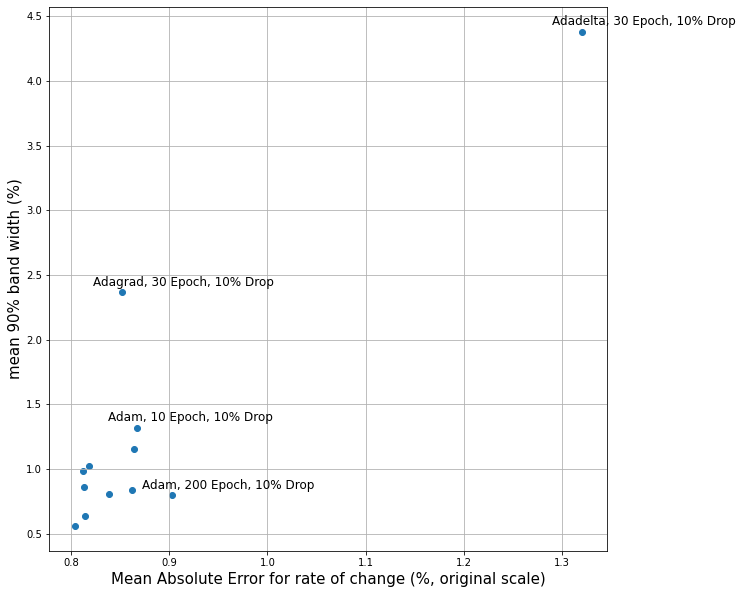

In [21]:
plt.figure(figsize=(10,10))

plt.scatter(mae_p, band_p);
plt.xlabel("Mean Absolute Error for rate of change (%, original scale)", size=15)
plt.ylabel("mean 90% band width (%)", size=15)
for i in [1, 4, 5, 11]:
    plt.annotate(params[i][0] + ", " + str(params[i][1]) + " Epoch, 10% Drop", (mae_p[i] - 0.03, band_p[i] + 0.05), size = 12)
plt.grid()
plt.show()

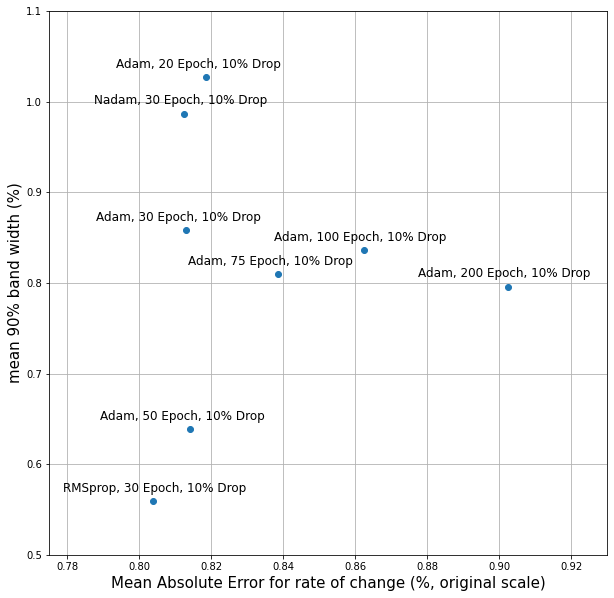

In [28]:
mae_p_wo_adadelta = mae_p[2:4]
band_p_wo_adadelta = band_p[2:4]
params_wo_adadelta = params[2:4]
mae_p_wo_adadelta.extend(mae_p[6:])
band_p_wo_adadelta.extend(band_p[6:])
params_wo_adadelta.extend(params[6:])

plt.figure(figsize=(10,10))
plt.xlim(0.775, 0.93)
plt.ylim(0.5, 1.1)
plt.scatter(mae_p_wo_adadelta, band_p_wo_adadelta);
plt.xlabel("Mean Absolute Error for rate of change (%, original scale)", size=15)
plt.ylabel("mean 90% band width (%)", size=15)
for i in range(len(params_wo_adadelta)):
    plt.annotate(params_wo_adadelta[i][0] + ", " + str(params_wo_adadelta[i][1]) + " Epoch, 10% Drop", (mae_p_wo_adadelta[i] - 0.025, band_p_wo_adadelta[i] + 0.01), size = 12)
plt.grid()
plt.show()